In [24]:
import re

valid_symbols = [
  'AA', 'AA0', 'AA1', 'AA2', 'AE', 'AE0', 'AE1', 'AE2', 'AH', 'AH0', 'AH1', 'AH2',
  'AO', 'AO0', 'AO1', 'AO2', 'AW', 'AW0', 'AW1', 'AW2', 'AY', 'AY0', 'AY1', 'AY2',
  'B', 'CH', 'D', 'DH', 'EH', 'EH0', 'EH1', 'EH2', 'ER', 'ER0', 'ER1', 'ER2', 'EY',
  'EY0', 'EY1', 'EY2', 'F', 'G', 'HH', 'IH', 'IH0', 'IH1', 'IH2', 'IY', 'IY0', 'IY1',
  'IY2', 'JH', 'K', 'L', 'M', 'N', 'NG', 'OW', 'OW0', 'OW1', 'OW2', 'OY', 'OY0',
  'OY1', 'OY2', 'P', 'R', 'S', 'SH', 'T', 'TH', 'UH', 'UH0', 'UH1', 'UH2', 'UW',
  'UW0', 'UW1', 'UW2', 'V', 'W', 'Y', 'Z', 'ZH'
]

_valid_symbol_set = set(valid_symbols)

_pad        = '_'
_punctuation = '!\'(),.:;? '
_special = '-'
_letters = 'АБВГДЕЁЖЗИЙКЛМНОПРСТУФХЦЧШЩЪЫЬЭЮЯабвгдеёжзийклмнопрстуфхцчшщъыьэюя'

# Prepend "@" to ARPAbet symbols to ensure uniqueness (some are the same as uppercase letters):
_arpabet = ['@' + s for s in valid_symbols]

# Export all symbols:
symbols = [_pad] + list(_special) + list(_punctuation) + list(_letters) + _arpabet

# Mappings from symbol to numeric ID and vice versa:
_symbol_to_id = {s: i for i, s in enumerate(symbols)}
_id_to_symbol = {i: s for i, s in enumerate(symbols)}

# Regular expression matching text enclosed in curly braces:
_curly_re = re.compile(r'(.*?)\{(.+?)\}(.*)')

In [11]:
import os

def count_wav_files(directory):
    # Считаем количество файлов с расширением .wav
    wav_count = len([file for file in os.listdir(directory) if file.endswith('s16')])
    return wav_count

# Пример использования
directory_path = "/app/TTS/datasets/wavs/"
wav_file_count = count_wav_files(directory_path)
print(f"Количество .wav файлов в директории: {wav_file_count}")


Количество .wav файлов в директории: 0


In [15]:
import gdown
import tarfile
import os

# Прямая ссылка на файл
url = "https://drive.google.com/uc?id=1Ye9IqnOvCjDc8NdMQol-bu-gWJGJjbB1"

# Директория для сохранения архива
output_dir = "/app/TTSproject/tacotron/datasets/"
os.makedirs(output_dir, exist_ok=True)
output_path = os.path.join(output_dir, "RUSLAN.tar.gz")

# Скачивание архива
gdown.download(url, output_path, quiet=False)

# Разархивирование
with tarfile.open(output_path, "r:gz") as tar:
    tar.extractall(path=output_dir)

print("Архив скачан и разархивирован.")


Downloading...
From (original): https://drive.google.com/uc?id=1Ye9IqnOvCjDc8NdMQol-bu-gWJGJjbB1
From (redirected): https://drive.google.com/uc?id=1Ye9IqnOvCjDc8NdMQol-bu-gWJGJjbB1&confirm=t&uuid=4047de0d-940c-4fef-afaf-109e7e7012cf
To: /app/TTSproject/tacotron/datasets/RUSLAN.tar.gz
100%|█████████████████████████████████████████████████████████████| 8.04G/8.04G [02:28<00:00, 54.0MB/s]


Архив скачан и разархивирован.


In [17]:
import gdown
import os

# Прямая ссылка на файл
url = "https://drive.google.com/uc?id=11TD_ZwIOo-Wo75GYv-OWWOS3ABmwmAdK"

# Директория для сохранения файла
output_dir = "/app/TTSproject/tacotron/datasets/"
os.makedirs(output_dir, exist_ok=True)
output_path = os.path.join(output_dir, "metadata.csv")  # Замените "downloaded_file" на нужное имя файла

# Скачивание файла
gdown.download(url, output_path, quiet=False)

print("Файл скачан:", output_path)


Downloading...
From: https://drive.google.com/uc?id=11TD_ZwIOo-Wo75GYv-OWWOS3ABmwmAdK
To: /app/TTSproject/tacotron/datasets/metadata.csv
100%|█████████████████████████████████████████████████████████████| 3.64M/3.64M [00:00<00:00, 43.7MB/s]

Файл скачан: /app/TTSproject/tacotron/datasets/metadata.csv


In [8]:
a = get_lpc_from_f32(wav_file_path)

In [9]:
a.size()

torch.Size([20, 356])

In [1]:
from dataset import *

In [2]:
data_dir = './datasets/'

train_loader = prepare_dataloaders(data_dir, 1)

#first_batch = next(iter(train_loader))

#text_padded, input_lengths, mel_padded, gate_padded, output_lengths = first_batch

#print('\n', sequence_to_text(list(text_padded[0].tolist())))

In [13]:
first_batch = next(iter(train_loader))

In [14]:
text_padded, input_lengths, mel_padded, gate_padded, output_lengths = first_batch

In [15]:
output_lengths[2]

tensor(672)

In [16]:
tensor_to_ru_phonemes(text_padded[8])

'p rj i0 ch o1 m <space> nj e1 <space> o0 bj a0 z a1 tj e0 lj n o0 <space> s <space> u0 ch o1 n y0 m <space> i1 lj i0 <space> k o0 s m o0 n a1 v t o0 m . dj i0 a0 p a0 z o1 n <space> t u1 t <space> i0 s k lj u0 ch i1 tj e0 lj n o0 <space> sh i0 r o1 kj i0 j . _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _'

In [7]:
_pad        = '_'
_punctuation = '-!\'(),.:;?– '
_special = '+'
_letters = 'АБВГДЕЁЖЗИЙКЛМНОПРСТУФХЦЧШЩЪЫЬЭЮЯабвгдеёжзийклмнопрстуфхцчшщъыьэюя'

# Export all symbols
symbols = [_pad] + list(_special) + list(_punctuation) + list(_letters) #+ _arpabet

# Mappings from symbol to numeric ID and vice versa
_symbol_to_id = {s: i for i, s in enumerate(symbols)}
_id_to_symbol = {i: s for i, s in enumerate(symbols)}

In [27]:
_symbol_to_id

{'_': 0,
 '-': 1,
 '!': 2,
 "'": 3,
 '(': 4,
 ')': 5,
 ',': 6,
 '.': 7,
 ':': 8,
 ';': 9,
 '?': 10,
 ' ': 11,
 'А': 12,
 'Б': 13,
 'В': 14,
 'Г': 15,
 'Д': 16,
 'Е': 17,
 'Ё': 18,
 'Ж': 19,
 'З': 20,
 'И': 21,
 'Й': 22,
 'К': 23,
 'Л': 24,
 'М': 25,
 'Н': 26,
 'О': 27,
 'П': 28,
 'Р': 29,
 'С': 30,
 'Т': 31,
 'У': 32,
 'Ф': 33,
 'Х': 34,
 'Ц': 35,
 'Ч': 36,
 'Ш': 37,
 'Щ': 38,
 'Ъ': 39,
 'Ы': 40,
 'Ь': 41,
 'Э': 42,
 'Ю': 43,
 'Я': 44,
 'а': 45,
 'б': 46,
 'в': 47,
 'г': 48,
 'д': 49,
 'е': 50,
 'ё': 51,
 'ж': 52,
 'з': 53,
 'и': 54,
 'й': 55,
 'к': 56,
 'л': 57,
 'м': 58,
 'н': 59,
 'о': 60,
 'п': 61,
 'р': 62,
 'с': 63,
 'т': 64,
 'у': 65,
 'ф': 66,
 'х': 67,
 'ц': 68,
 'ч': 69,
 'ш': 70,
 'щ': 71,
 'ъ': 72,
 'ы': 73,
 'ь': 74,
 'э': 75,
 'ю': 76,
 'я': 77,
 '@AA': 78,
 '@AA0': 79,
 '@AA1': 80,
 '@AA2': 81,
 '@AE': 82,
 '@AE0': 83,
 '@AE1': 84,
 '@AE2': 85,
 '@AH': 86,
 '@AH0': 87,
 '@AH1': 88,
 '@AH2': 89,
 '@AO': 90,
 '@AO0': 91,
 '@AO1': 92,
 '@AO2': 93,
 '@AW': 94,
 '@AW0': 95,
 

In [72]:
def get_ru_text(text):
    # Конвертируем текст в список ID
    sequence = [_symbol_to_id[s] for s in text if s in _symbol_to_id]
    
    # Преобразуем список ID в тензор
    sequence_tensor = torch.tensor(sequence, dtype=torch.int64)
    
    return sequence_tensor

In [73]:
def tensor_to_ru_text(tensor):
    # Конвертируем тензор в список символов
    text = ''.join([_id_to_symbol[id] for id in tensor.tolist()])
    return text

In [74]:
tensor_to_ru_text(get_ru_text(text))

'- Это необычный гвоздь, – сказал Трюмо, – это – личная вещь Бунина. '

In [2]:
tensor_to_ru_text(get_ru_text('хуй соси,  быдло'))

'хуй соси,  быдло'

In [36]:
get_ru_text(text)

tensor([ 1, 11, 42, 64, 60, 11, 59, 50, 60, 46, 73, 69, 59, 73, 55, 11, 48, 47,
        60, 53, 49, 74,  6, 11, 11, 63, 56, 45, 53, 45, 57, 11, 31, 62, 76, 58,
        60,  6, 11, 11, 75, 64, 60, 11, 11, 57, 54, 69, 59, 45, 77, 11, 47, 50,
        71, 74, 11, 13, 65, 59, 54, 59, 45,  7, 11])

In [35]:
text = '- Это необычный гвоздь, – сказал Трюмо, – "это – личная вещь Бунина. "'

In [28]:
get_text(text)

tensor([49, 50, 56, 45, 46, 62, 74,  1, 63, 56, 54, 58, 11, 65, 64, 62, 60, 58,
        11, 70, 50, 63, 64, 74, 49, 50, 63, 77, 64, 11, 63, 50, 49, 74, 58, 60,
        48, 60, 11, 48, 60, 49, 45, 11, 77, 11, 60, 64, 60, 63, 57, 45, 57, 11,
        68, 50, 57, 65, 76, 11, 61, 45, 69, 56, 65, 11, 62, 45, 63, 63, 56, 45,
        53, 60, 47, 11, 47, 11, 52, 65, 62, 59, 45, 57, 11, 59, 60, 47, 73, 55,
        11, 58, 54, 62,  7], dtype=torch.int32)

In [66]:
import csv

_pad        = '_'
_punctuation = '!\'(),.:;?«» '
_special = '-'
_letters = 'АБВГДЕЁЖЗИЙКЛМНОПРСТУФХЦЧШЩЪЫЬЭЮЯабвгдеёжзийклмнопрстуфхцчшщъыьэюя'

# Все предопределенные символы в одном списке для сортировки
predefined_order = [_pad] + list(_punctuation) + list(_special) + list(_letters)

def get_unique_symbols_from_metadata(file_path):
    unique_symbols = set()  # Используем set для хранения уникальных символов

    # Открываем и читаем файл CSV
    with open(file_path, mode='r', encoding='utf-8') as file:
        reader = csv.reader(file, delimiter='|')
        for row in reader:
            if len(row) > 1:
                text = row[1].strip()  # Берем текстовую часть после вертикального слеша
                unique_symbols.update(text)  # Добавляем все символы из текста в набор

    # Сначала добавляем все предопределенные символы, даже если их нет в тексте
    sorted_symbols = [s for s in predefined_order]

    # Добавляем любые дополнительные символы, найденные в тексте, но отсутствующие в predefined_order
    extra_symbols = sorted([s for s in unique_symbols if s not in predefined_order])

    # Объединяем оба списка
    return sorted_symbols + extra_symbols

# Пример использования:
file_path = './datasets/metadata.csv'
unique_symbols = get_unique_symbols_from_metadata(file_path)
symbols = unique_symbols
print(symbols)


['_', '!', "'", '(', ')', ',', '.', ':', ';', '?', '«', '»', ' ', '-', 'А', 'Б', 'В', 'Г', 'Д', 'Е', 'Ё', 'Ж', 'З', 'И', 'Й', 'К', 'Л', 'М', 'Н', 'О', 'П', 'Р', 'С', 'Т', 'У', 'Ф', 'Х', 'Ц', 'Ч', 'Ш', 'Щ', 'Ъ', 'Ы', 'Ь', 'Э', 'Ю', 'Я', 'а', 'б', 'в', 'г', 'д', 'е', 'ё', 'ж', 'з', 'и', 'й', 'к', 'л', 'м', 'н', 'о', 'п', 'р', 'с', 'т', 'у', 'ф', 'х', 'ц', 'ч', 'ш', 'щ', 'ъ', 'ы', 'ь', 'э', 'ю', 'я', '*', '/', '<', '>', '́', '‑', '–', '’', '“', '”', '„', '…']


In [67]:

# Mappings from symbol to numeric ID and vice versa:
_symbol_to_id = {s: i for i, s in enumerate(symbols)}
_id_to_symbol = {i: s for i, s in enumerate(symbols)}


In [55]:
import csv
import re

def get_lines_with_special_symbols(file_path):
    lines_with_special_symbols = []
    
    # Символы, которые мы ищем в тексте
    special_symbols = r'[;]'

    # Открываем и читаем файл CSV
    with open(file_path, mode='r', encoding='utf-8') as file:
        reader = csv.reader(file, delimiter='|')
        for row in reader:
            if len(row) > 1:
                text = row[1].strip()  # Берем текстовую часть после вертикального слеша
                if re.search(special_symbols, text):  # Проверяем, содержит ли текст спецсимволы
                    lines_with_special_symbols.append(row[0] + "|" + row[1])  # Сохраняем строку целиком

    return lines_with_special_symbols

# Пример использования:
file_path = './datasets/metadata.csv'
lines_with_special_symbols = get_lines_with_special_symbols(file_path)

# Выводим строки со специальными символами
for line in lines_with_special_symbols:
    print(line)


011538_RUSLAN|Затем моя жена. И дальше Рафаэль, который на ходу твердил; – Мы ехали через Грэнд Сентрал. Повернули к мосту. 
018096_RUSLAN|Александр Солженицын начинает книгу «Бодался теленок с дубом» с пренебрежительной «оговорки» «Есть такая немалая, вторичная литература литература о литературе; литература вокруг литературы; литература, рожденная литературой (если б не было подобной перед тем, так и эта б не родилась).
018999_RUSLAN|После конференции я давал Гладилину интервью для «Либерти». Гладилин спросил; – Что вас особенно поразило? 
019619_RUSLAN|Людям все труднее прожить на официальный заработок, отношение к работе становится все более циничным и потребительским; короче, советские граждане все упорнее охотятся за халтурой как за дополнительным заработком, а с другой стороны, все небрежнее и халатнее выполняют свои прямые обязанности на официальной работе.


In [38]:
import csv
import re

def get_lines_with_digits(file_path):
    lines_with_digits = []

    # Открываем и читаем файл CSV
    with open(file_path, mode='r', encoding='utf-8') as file:
        reader = csv.reader(file, delimiter='|')
        for row in reader:
            if len(row) > 1:
                text = row[1].strip()  # Берем текстовую часть после вертикального слеша
                if re.search(r'\d', text):  # Проверяем, есть ли в тексте цифры
                    lines_with_digits.append(row[0] + "|" + row[1])  # Сохраняем строку целиком

    return lines_with_digits

# Пример использования:
file_path = './datasets/metadata.csv'
lines_with_digits = get_lines_with_digits(file_path)

# Выводим строки с цифрами
for line in lines_with_digits:
    print(line)


009017_RUSLAN|Брат разъезжал по отдаленным лагерным точкам. Ему предоставили казенную машину «ГАЗ‑61». 
011906_RUSLAN|На Филиппинах кто‑то застрелил руководителя партийной оппозиции. Под Мелитополем разбился «ТУ‑129». 
016720_RUSLAN|В сумочке ее лежало нечто, размером чуть поболее миниатюрного дамского браунинга «Элита‑16». 
021885_RUSLAN|– Турбовинтовой МИ‑6, – заметил Пупс, вставая. – Е‑ё! – лениво крикнул он. Затем скрестил над головой руки. 


In [57]:
import IPython.display as ipd
wav_file_path = "/app/TTSproject/tacotron/datasets/wavs/018096_RUSLAN.wav"
ipd.Audio(wav_file_path)

In [ ]:
import IPython.display as ipd
wav_file_path = "/app/TTS/datasets/wavs/020006_RUSLAN.wav"
kirya = '/app/TTS/zvuki/Киря/1.wav'
wav_file_path = kirya
ipd.Audio(wav_file_path)

In [4]:
import IPython.display as ipd
wav_file_path = "/app/TTSproject/tacotron/datasets/wavs/020006_RUSLAN.wav"
ipd.Audio(wav_file_path)

In [8]:
meltest = get_mel(wav_file_path)

In [37]:
meltest.shape

torch.Size([20, 224])

In [5]:
get_lpc(wav_file_path)

NameError: name 'get_lpc' is not defined

In [48]:
import os
import subprocess
import numpy as np
import torch

def get_lpc(wav_file_path):
    # Получаем имя файла без расширения
    base_name = os.path.splitext(os.path.basename(wav_file_path))[0]
    
    # Путь для сохранения PCM файла
    pcm_file_path = f"/app/TTS/lpc/Ruslan_Audio/test_output/{base_name}.s16"
    
    # Конвертируем входной аудиофайл в 16kHz моно PCM и сохраняем результат в файл
    convert_command = f"sox {wav_file_path} -r 16000 -c 1 -t sw - > {pcm_file_path}"
    subprocess.run(convert_command, shell=True, check=True)
    
    # Путь для сохранения файла с фичами (LPC коэффициенты) в новую директорию
    features_file_path = f"./datasets/lpc_features/{base_name}.f32"
    
    # Выполняем бинарный файл для генерации файла с фичами
    dump_data_command = f"/app/TTS/LPCNet_xiph3/dump_data -test {pcm_file_path} {features_file_path}"
    subprocess.run(dump_data_command, shell=True, check=True)
    
    # Удаляем промежуточный PCM файл
    os.remove(pcm_file_path)
    
    # Читаем сгенерированный файл с фичами
    lpc_features = np.fromfile(features_file_path, dtype='float32')
    
    # Изменяем размер массива
    num_lpc = 55  # Количество коэффициентов LPC на фрейм
    
    lpc_features = lpc_features.reshape(-1, num_lpc)
    
    # Конвертируем массив в тензор PyTorch для использования в модели
    lpc_tensor = torch.Tensor(lpc_features)
    
    # Транспонируем и выбираем нужные фичи
    lpcfeatures_transposed = lpc_tensor.transpose(0, 1)
    
    lpc_tensor = torch.cat((lpcfeatures_transposed[0:18, :], lpcfeatures_transposed[36:38, :]), dim=0)
    
    return lpc_tensor


In [35]:
lpctest

tensor([[-1.2372e+01,  4.1745e+00,  8.1609e+00,  ...,  2.0410e+00,
          5.6917e+00,  5.9652e+00],
        [-5.1094e-02,  1.7278e+00,  2.3267e-01,  ..., -1.3219e+00,
          8.1238e-01,  1.0307e+00],
        [ 1.5651e-02, -1.9390e+00, -2.5347e+00,  ..., -1.3832e-01,
         -1.7412e+00, -2.1178e+00],
        ...,
        [ 6.2494e-03,  5.6180e-02,  9.7180e-02,  ...,  8.0087e-02,
          3.4874e-01, -3.2844e-03],
        [ 4.5101e-03,  4.2056e-03, -4.7323e-02,  ...,  7.6881e-02,
         -7.2315e-02,  7.0201e-02],
        [ 6.2189e-03,  2.7385e-02,  1.4200e-01,  ...,  1.3634e-03,
          7.0473e-02,  3.4700e-02]])

In [49]:
lpctest = get_lpc(wav_file_path)
len(lpctest)

20

In [50]:
lpctest.size()

torch.Size([20, 356])

In [40]:
meltest.size()

torch.Size([20, 357])

In [51]:
lpctest[19]

tensor([-0.0484, -0.0484, -0.0484, -0.0484,  0.0507,  0.0507,  0.0507,  0.0507,
        -0.2224, -0.2224, -0.2224, -0.2224,  0.0911,  0.0911,  0.0911,  0.0911,
         0.2511,  0.2511,  0.2511,  0.2511, -0.1485, -0.1485, -0.1485, -0.1485,
        -0.2225, -0.2225, -0.2225, -0.2225, -0.2835, -0.2835, -0.2835, -0.2835,
        -0.2042, -0.2042, -0.2042, -0.2042, -0.3433, -0.3433, -0.3433, -0.3433,
         0.0360,  0.0360,  0.0360,  0.0360,  0.1206,  0.1206,  0.1206,  0.1206,
        -0.2350, -0.2350, -0.2350, -0.2350, -0.1327, -0.1327, -0.1327, -0.1327,
        -0.2549, -0.2549, -0.2549, -0.2549, -0.3009, -0.3009, -0.3009, -0.3009,
        -0.0202, -0.0202, -0.0202, -0.0202,  0.3394,  0.3394,  0.3394,  0.3394,
        -0.0192, -0.0192, -0.0192, -0.0192,  0.0369,  0.0369,  0.0369,  0.0369,
        -0.1299, -0.1299, -0.1299, -0.1299,  0.1287,  0.1287,  0.1287,  0.1287,
         0.0092,  0.0092,  0.0092,  0.0092, -0.1488, -0.1488, -0.1488, -0.1488,
         0.1332,  0.1332,  0.1332,  0.13

In [61]:
get_text('test').tolist()

[57, 42, 56, 57]

In [17]:
get_text('test')

tensor([], dtype=torch.int32)

In [23]:
sequence_to_text(get_text('хуй соси').tolist())

'хуй соси'

In [16]:
sequence_to_text(text_padded[0].tolist())

",  '? -  ', - , -  , ,  . -    ? - ."

In [ ]:
def get_lpcfeatures_T(file_path):
    lpcfeatures = np.fromfile(file_path, dtype='float32')
    lpcfeatures = torch.Tensor(np.reshape(lpcfeatures, (-1, hps.num_lpc)))
    lpcfeatures_transposed = lpcfeatures.transpose(0, 1)
    return lpcfeatures_transposed

def get_lpcfeatures_text_pair(text, file_path):
    text = get_text(text)
    lpcf = get_lpcfeatures_T(file_path)
    return (text, lpcf)

In [ ]:
import os
import librosa
import soundfile as sf

# Директория с файлами
directory = '/app/TTSproject/tacotron/datasets/wavs'

# Целевая частота дискретизации
target_sr = 16000

# Функция для конвертации файлов
def convert_to_wav_16khz(file_path, target_sr=16000):
    # Загрузка аудиофайла
    audio, sr = librosa.load(file_path, sr=None)
    
    # Проверяем, нужно ли менять частоту дискретизации
    if sr != target_sr:
        # Ресемплирование
        audio = librosa.resample(audio, orig_sr=sr, target_sr=target_sr)
        
    # Перезаписываем файл с новой частотой дискретизации
    sf.write(file_path, audio, target_sr)
    print(f"Файл {file_path} успешно конвертирован в 16 кГц.")

# Проходим по всем файлам в директории
for filename in os.listdir(directory):
    if filename.startswith("._"):
        print(filename) 
        continue
    if filename.endswith(".wav"):
        print(filename)
        file_path = os.path.join(directory, filename)
        convert_to_wav_16khz(file_path, target_sr)
    else:
        print(f"Пропущен файл {filename}, так как он не в формате WAV.")


In [4]:
import os

# Директория с файлами
directory = '/app/TTSproject/tacotron/datasets/wavs'

# Проходим по всем файлам в директории
for filename in os.listdir(directory):
    if filename.startswith("._"):
        file_path = os.path.join(directory, filename)
        os.remove(file_path)
        print(f"Файл {filename} удален.")


In [5]:
directory

'/app/TTSproject/tacotron/datasets/wavs'

In [8]:
%load_ext tensorboard
%tensorboard --logdir ./logs

ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
TensorFlow installation not found - running with reduced feature set.

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Address already in use
Port 6006 is in use by another program. Either identify and stop that program, or start the server with a different port.

## inference

In [106]:
import torch
import argparse
import numpy as np
import matplotlib.pylab as plt
from model import Tacotron2, mode, to_arr
from dataset import hparams as hps, save_wav, inv_melspectrogram, text_to_sequence
from utils import start_timer, end_timer_and_print


def load_model(ckpt_pth):
    ckpt_dict = torch.load(ckpt_pth)
    model = Tacotron2()
    model.load_state_dict(ckpt_dict['model'])
    model = mode(model, True).eval()
    return model


In [107]:
torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark = False
model = load_model('./ckpt/ckpt_20000')

In [108]:
def infer(text, model):
    sequence = text_to_sequence(text, hps.text_cleaners)
    sequence = mode(torch.IntTensor(sequence)[None, :]).long()
    mel_outputs, mel_outputs_postnet, _, alignments = model.inference(sequence)
    return (mel_outputs, mel_outputs_postnet, alignments)

In [109]:
text = 'тестируем эту хуйню'
sequence = text_to_sequence(text, hps.text_cleaners)
sequence = mode(torch.IntTensor(sequence)[None, :]).long()

In [110]:
sequence = sequence.to('cuda')

In [67]:
mel_outputs, mel_outputs_postnet, _, alignments = model.inference(sequence)

In [68]:
mel_outputs.size()

torch.Size([1, 20, 192])

In [70]:
processed_lpc_output = process_lpc_output(mel_outputs)
processed_lpc_output

tensor([[-12.3176,   2.8083,   2.5473,  ...,  -2.8133,  -2.3988,  -2.0392],
        [ -0.4752,  -4.5621,  -5.2684,  ...,   1.1715,   1.1640,   1.0889],
        [  0.2620,  -0.4987,   0.5526,  ...,  -0.1824,  -0.3649,  -0.4602],
        ...,
        [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
        [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
        [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000]],
       grad_fn=<CopySlices>)

In [ ]:
npy_data.tofile("f32_for_lptnet.f32")

In [73]:
processed_lpc_output[36]

tensor([-0.4422, -0.4340, -0.4406, -0.6911, -0.3268, -0.2166, -0.5473, -0.3262,
        -0.1513,  0.2107,  0.2772,  0.3749,  0.6197,  0.6093,  0.6128,  0.6183,
         0.6129,  0.6082,  0.7037,  0.6827,  0.6783,  0.5597,  0.5771,  0.5828,
         0.6999,  0.7158,  0.7394,  0.5227,  0.4892,  0.4519,  0.1729,  0.1152,
         0.0534, -0.0054, -0.0593, -0.1042,  0.0914,  0.1165,  0.1114,  0.0639,
         0.0625,  0.1025,  0.1153,  0.1528,  0.1989,  0.4053,  0.4719,  0.5270,
         0.7343,  0.7948,  0.8135,  0.8856,  0.9162,  0.9149,  0.8845,  0.9071,
         0.8913,  0.8025,  0.7989,  0.7806,  0.6927,  0.6577,  0.6156,  0.4950,
         0.4431,  0.4066,  0.3618,  0.3069,  0.2743, -0.0189, -0.0657, -0.0552,
         0.1371,  0.0944,  0.0656,  0.0714,  0.0826,  0.0829,  0.1208,  0.1153,
         0.1081,  0.1117,  0.1480,  0.1896,  0.2476,  0.2298,  0.2410,  0.3534,
         0.3348,  0.3435,  0.3449,  0.3474,  0.3461,  0.3160,  0.3056,  0.2999,
         0.3700,  0.4584,  0.4891,  0.46

In [56]:
def process_lpc_output(lpc_output):
    # Избавляемся от нулевого измерения
    lpc_output = lpc_output.squeeze(0)  # Размер будет [20, 192]
    
    # Создаем новый тензор размера [55, 192], заполненный нулями
    new_lpc_output = torch.zeros(55, lpc_output.size(1))
    
    # Копируем первые 18 строк
    new_lpc_output[0:18, :] = lpc_output[0:18, :]
    
    # Копируем строки с индексами 36 и 37
    new_lpc_output[36:38, :] = lpc_output[18:20, :]
    
    return new_lpc_output

In [360]:
import os
import torch
import numpy as np

def infer(text, model, output_dir='./output'):
    # Преобразуем текст в последовательность индексов
    sequence = text_to_sequence(text, hps.text_cleaners)
    sequence = torch.IntTensor(sequence)[None, :].long()
    sequence = sequence.to('cuda')
    
    # Выполняем инференс модели, получая выходные данные
    lpc_outputs, _, _, alignments = model.inference(sequence)
    
     # Преобразуем результаты инференса в нужный формат
    processed_lpc_output = process_lpc_output(lpc_outputs)
    
    # Получаем имя файла из текста (можно улучшить, чтобы избежать недопустимых символов)
    base_name = "_".join(text.split())[:50]  # Ограничиваем длину имени файла
    
    # Формируем путь для сохранения
    output_file_path = os.path.join(output_dir, f"{base_name}.f32")
    
    # Убедитесь, что директория для сохранения существует
    os.makedirs(output_dir, exist_ok=True)
    
    # Преобразуем результат инференса в numpy массив и сохраняем в файл .f32
    lpc_output_numpy = processed_lpc_output.detach().cpu().numpy().astype('float32')
    lpc_output_numpy.T.tofile(output_file_path) #transpose before save

    print(f"Результат инференса сохранен в файл: {output_file_path}")
    return(lpc_output_numpy)


In [361]:
text = 'тестируем опять'
sequence = text_to_sequence(text, hps.text_cleaners)
sequence = mode(torch.IntTensor(sequence)[None, :]).long()
lpc_outputs, _, _, alignments = model.inference(sequence)
lpc_outputs

Terminated by gate.


tensor([[[-11.9577,   2.5922,   2.3656,  ...,   5.5561,   4.6865,   3.9610],
         [ -0.1760,  -5.8250,  -7.3270,  ...,  -4.5195,  -4.0294,  -3.4105],
         [  0.0911,  -0.1528,   1.0774,  ...,  -0.5368,  -0.7199,  -0.7599],
         ...,
         [ -0.0487,   0.0703,   0.0258,  ...,   0.0919,   0.0837,   0.1101],
         [ -0.6370,  -0.6878,  -0.6923,  ...,   1.3311,   1.3523,   1.3442],
         [ -0.2412,  -0.2474,  -0.2965,  ...,  -0.2161,  -0.2174,  -0.2295]]],
       device='cuda:0', grad_fn=<TransposeBackward0>)

In [249]:
lpc_output = lpc_outputs.squeeze(0)  # Размер будет [20, 192]

# Создаем новый тензор размера [55, 192], заполненный нулями
new_lpc_output = torch.zeros(55, lpc_output.size(1))

# Копируем первые 18 строк
new_lpc_output[0:18, :] = lpc_output[0:18, :]

# Копируем строки с индексами 36 и 37
new_lpc_output[36:38, :] = lpc_output[18:20, :]

In [251]:
new_lpc_output.size()

torch.Size([55, 126])

In [252]:
lpc_output.size()

torch.Size([20, 126])

In [254]:
n = 0

In [268]:
new_lpc_output[36]

tensor([-0.6370, -0.6878, -0.6923, -0.4199, -0.3381, -0.2840, -0.6576, -0.4686,
        -0.1897, -0.0183,  0.0337,  0.1471,  0.3480,  0.3490,  0.3239,  0.3075,
         0.3155,  0.3075,  0.3033,  0.2985,  0.2903,  0.4401,  0.4208,  0.3991,
         0.3557,  0.3414,  0.3271,  0.3960,  0.4133,  0.3885,  0.4263,  0.4519,
         0.4159,  0.3754,  0.3046,  0.2014,  0.0191, -0.0360, -0.0713, -0.2203,
        -0.2570, -0.2407, -0.3323, -0.3459, -0.2993, -0.3950, -0.3837, -0.3014,
        -0.3023, -0.2974, -0.2091, -0.0837, -0.0385,  0.0669,  0.0183,  0.0715,
         0.1821,  0.2888,  0.3456,  0.4132,  0.4307,  0.4580,  0.5121,  0.6692,
         0.6698,  0.6996,  0.7676,  0.7459,  0.7518,  0.8401,  0.8108,  0.8286,
         0.8808,  0.8533,  0.8594,  0.9356,  0.9398,  0.8881,  0.9422,  0.9533,
         0.9067,  0.9578,  0.9738,  0.9978,  0.9856,  0.9635,  0.9400,  0.8986,
         0.8879,  0.8827,  0.9117,  0.9251,  0.9379,  0.8914,  0.9212,  0.9120,
         0.8643,  0.8400,  0.7994,  0.80

In [266]:
lpc_output[18]

tensor([-0.6370, -0.6878, -0.6923, -0.4199, -0.3381, -0.2840, -0.6576, -0.4686,
        -0.1897, -0.0183,  0.0337,  0.1471,  0.3480,  0.3490,  0.3239,  0.3075,
         0.3155,  0.3075,  0.3033,  0.2985,  0.2903,  0.4401,  0.4208,  0.3991,
         0.3557,  0.3414,  0.3271,  0.3960,  0.4133,  0.3885,  0.4263,  0.4519,
         0.4159,  0.3754,  0.3046,  0.2014,  0.0191, -0.0360, -0.0713, -0.2203,
        -0.2570, -0.2407, -0.3323, -0.3459, -0.2993, -0.3950, -0.3837, -0.3014,
        -0.3023, -0.2974, -0.2091, -0.0837, -0.0385,  0.0669,  0.0183,  0.0715,
         0.1821,  0.2888,  0.3456,  0.4132,  0.4307,  0.4580,  0.5121,  0.6692,
         0.6698,  0.6996,  0.7676,  0.7459,  0.7518,  0.8401,  0.8108,  0.8286,
         0.8808,  0.8533,  0.8594,  0.9356,  0.9398,  0.8881,  0.9422,  0.9533,
         0.9067,  0.9578,  0.9738,  0.9978,  0.9856,  0.9635,  0.9400,  0.8986,
         0.8879,  0.8827,  0.9117,  0.9251,  0.9379,  0.8914,  0.9212,  0.9120,
         0.8643,  0.8400,  0.7994,  0.80

In [293]:
lpc_output_numpy = new_lpc_output.detach().cpu().numpy().astype('float32')
lpc_output_numpy.T.tofile(feature_file) 

In [272]:
lpc_output_numpy.shape

(55, 126)

In [316]:
# Загрузка и ресайз
features2 = np.fromfile(feature_file, dtype='float32')

# Восстановление исходной формы
features2 = np.resize(features2, (nb_features, int(len(features2) / nb_features)))
nb_frames = 1
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))


ValueError: cannot reshape array of size 32010 into shape (1,1,55)

In [294]:
feature_file = './test.f32'
lpc_output_numpy.tofile(feature_file)

In [298]:
frame_size = 160
nb_features = 55
nb_used_features = 38

features2 = np.fromfile(feature_file, dtype='float32')
#features = np.resize(features, (-1, nb_features))
features2 = np.resize(features, (int(len(features) / nb_features), nb_features))
nb_frames = 1
feature_chunk_size = features2.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features2 = np.reshape(features2, (nb_frames, feature_chunk_size, nb_features))
features2[:,:,18:36] = 0

periods2 = torch.Tensor((.1 + 50*features2[:,:,36:37]+100)).type(torch.LongTensor)

# Ограничение значений в диапазоне от 0 до 255 - добавлено для аутпутов такотрона которые не знают о диапазоне
periods2 = torch.clamp(periods2, min=0, max=255)

In [296]:
features2 = np.fromfile(feature_file, dtype='float32')
features2 = np.resize(features2, (int(len(features2) / nb_features), nb_features))

In [303]:
features2.shape

(55, 126)

In [310]:
features2[17]

array([-0.04870766,  0.07028647,  0.02581302, -0.09050823,  0.03533728,
        0.02415336,  0.00088846,  0.02760007,  0.04925495, -0.02870273,
       -0.06512187,  0.0249595 ,  0.03296755, -0.01056262, -0.01183751,
       -0.0062279 ,  0.01269568,  0.0073056 ,  0.02812323,  0.06228777,
        0.03794026,  0.06162757,  0.10826579,  0.06994902,  0.06094797,
        0.09951721,  0.06541996,  0.02955547,  0.05225851,  0.04351123,
        0.03003868,  0.07699503,  0.11134946,  0.10111931,  0.13101816,
        0.08402081,  0.18714759,  0.19982976,  0.2507105 ,  0.1696792 ,
        0.17219311,  0.19796284,  0.13606676,  0.12608545,  0.12974988,
        0.11219355,  0.07126735,  0.07007387,  0.07175384,  0.06266738,
        0.08311012,  0.04914011,  0.09460527,  0.12085992,  0.04323444,
        0.04827893,  0.07173388, -0.02024563, -0.03625814, -0.05476611,
       -0.1379126 , -0.1676574 , -0.1322915 , -0.12600741, -0.14503074,
       -0.10878779, -0.03058881, -0.02910795, -0.00575365,  0.03

In [311]:
lpc_output_numpy[17]

array([-0.04870766,  0.07028647,  0.02581302, -0.09050823,  0.03533728,
        0.02415336,  0.00088846,  0.02760007,  0.04925495, -0.02870273,
       -0.06512187,  0.0249595 ,  0.03296755, -0.01056262, -0.01183751,
       -0.0062279 ,  0.01269568,  0.0073056 ,  0.02812323,  0.06228777,
        0.03794026,  0.06162757,  0.10826579,  0.06994902,  0.06094797,
        0.09951721,  0.06541996,  0.02955547,  0.05225851,  0.04351123,
        0.03003868,  0.07699503,  0.11134946,  0.10111931,  0.13101816,
        0.08402081,  0.18714759,  0.19982976,  0.2507105 ,  0.1696792 ,
        0.17219311,  0.19796284,  0.13606676,  0.12608545,  0.12974988,
        0.11219355,  0.07126735,  0.07007387,  0.07175384,  0.06266738,
        0.08311012,  0.04914011,  0.09460527,  0.12085992,  0.04323444,
        0.04827893,  0.07173388, -0.02024563, -0.03625814, -0.05476611,
       -0.1379126 , -0.1676574 , -0.1322915 , -0.12600741, -0.14503074,
       -0.10878779, -0.03058881, -0.02910795, -0.00575365,  0.03

In [48]:
lpc_outputs = process_lpc_output(mel_outputs)

In [115]:
lpc_outputs[36]

tensor([-0.4422, -0.4340, -0.4406, -0.8133, -0.3256, -0.2037,  0.1523,  0.2778,
         0.3908,  0.6460,  0.6392,  0.6575,  0.7977,  0.8253,  0.8171,  0.8148,
         0.8238,  0.8078,  0.7965,  0.8071,  0.7955,  0.8915,  0.8930,  0.8865,
         0.7641,  0.7843,  0.7935,  0.6471,  0.6167,  0.5467,  0.4152,  0.3638,
         0.2982,  0.1971,  0.1660,  0.1227, -0.0894, -0.1009, -0.1277,  0.0044,
        -0.0319, -0.0047, -0.0515, -0.0417, -0.0175, -0.0566, -0.0329,  0.0146,
        -0.2458, -0.2150, -0.1440, -0.1532, -0.1022, -0.0584, -0.0388, -0.0165,
        -0.0029,  0.0847,  0.1202,  0.1375,  0.1743,  0.1872,  0.2110,  0.3590,
         0.3587,  0.3703,  0.5319,  0.5069,  0.4848,  0.4948,  0.5112,  0.5000,
         0.5370,  0.5449,  0.5297,  0.5595,  0.5996,  0.6123,  0.7575,  0.7308,
         0.7380,  0.7784,  0.7620,  0.7637,  0.7370,  0.7322,  0.7177,  0.6806,
         0.6507,  0.6003,  0.5267,  0.5771,  0.5820,  0.4951,  0.5492,  0.5572,
         0.6277,  0.6971,  0.7193,  0.64

In [105]:
mel_outputs[0][1]

tensor([-0.4752, -4.5621, -5.2684, -8.2589, -7.0016, -5.3296, -2.5716, -1.4316,
        -1.4198, -1.3667, -2.6955, -4.4078, -5.5309, -5.9751, -6.0193, -6.0601,
        -6.1562, -6.1245, -5.6892, -5.5798, -5.7677, -6.2143, -6.6046, -6.9637,
        -7.2248, -7.0456, -5.6935, -3.5679, -1.1743,  0.0926,  0.0830,  0.4776,
         0.8770,  0.9439,  1.3267,  1.7929,  2.1795,  2.2655,  2.8024,  3.5607,
         3.7480,  3.8342,  3.7598,  3.6835,  3.6193,  3.7539,  3.7585,  3.7866,
         3.8064,  3.7877,  3.8185,  3.7844,  3.8955,  3.9371,  3.9944,  4.0715,
         3.9672,  3.5635,  3.3817,  3.1425,  2.5145,  2.2569,  2.0883,  1.6698,
         1.6286,  1.6149,  1.3620,  1.5186,  1.7257,  1.6594,  1.8765,  2.0212,
         2.2631,  2.3994,  2.4505,  2.0354,  1.0295,  0.4496,  2.0141,  3.5604,
         3.7944,  3.8098,  3.0780,  2.0333,  0.9906,  0.3022, -0.1606, -0.3617,
        -0.3888, -0.5205, -0.5153, -0.3778, -0.2089,  0.5988,  2.0353,  3.1017,
         4.0583,  4.0881,  4.0541,  4.06

In [104]:
slice_tensor = mel_outputs[:, 1]
slice_tensor


tensor([[-0.4752, -4.5621, -5.2684, -8.2589, -7.0016, -5.3296, -2.5716, -1.4316,
         -1.4198, -1.3667, -2.6955, -4.4078, -5.5309, -5.9751, -6.0193, -6.0601,
         -6.1562, -6.1245, -5.6892, -5.5798, -5.7677, -6.2143, -6.6046, -6.9637,
         -7.2248, -7.0456, -5.6935, -3.5679, -1.1743,  0.0926,  0.0830,  0.4776,
          0.8770,  0.9439,  1.3267,  1.7929,  2.1795,  2.2655,  2.8024,  3.5607,
          3.7480,  3.8342,  3.7598,  3.6835,  3.6193,  3.7539,  3.7585,  3.7866,
          3.8064,  3.7877,  3.8185,  3.7844,  3.8955,  3.9371,  3.9944,  4.0715,
          3.9672,  3.5635,  3.3817,  3.1425,  2.5145,  2.2569,  2.0883,  1.6698,
          1.6286,  1.6149,  1.3620,  1.5186,  1.7257,  1.6594,  1.8765,  2.0212,
          2.2631,  2.3994,  2.4505,  2.0354,  1.0295,  0.4496,  2.0141,  3.5604,
          3.7944,  3.8098,  3.0780,  2.0333,  0.9906,  0.3022, -0.1606, -0.3617,
         -0.3888, -0.5205, -0.5153, -0.3778, -0.2089,  0.5988,  2.0353,  3.1017,
          4.0583,  4.0881,  

In [214]:
features = np.fromfile(features_file_path, dtype='float32')

In [215]:
frame_size = 160
nb_features = 55
nb_used_features = 38
nb_frames = 1

#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))

In [216]:

feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

In [213]:
features_orig = features

In [209]:
features[0][50]

array([-1.2183745, -1.367841 , -1.372279 , -1.3084023, -1.5410914,
       -1.5368292, -1.4522274, -1.4795965, -1.4886562, -1.401371 ,
       -1.5148065, -1.4600189, -1.3533723, -1.6066101, -1.5241266,
       -1.399879 , -1.5531747, -1.5000124,  0.       ,  0.       ,
        0.       ,  0.       ,  0.       ,  0.       ,  0.       ,
        0.       ,  0.       ,  0.       ,  0.       ,  0.       ,
        0.       ,  0.       ,  0.       ,  0.       ,  0.       ,
        0.       , -1.5905387, -1.800434 , -1.7305673, -1.6671572,
       -2.0980487, -1.9463109, -1.7859497, -1.4740447, -1.4741483,
       -1.4315293, -1.7559996, -1.6600137, -1.5663533, -1.7524222,
       -1.6362025, -1.5198474, -1.5405996, -1.4578878, -1.3920722],
      dtype=float32)

In [341]:
features.shape

(1, 126, 55)

In [160]:
features = np.fromfile('./datasets/lpc_features/020006_RUSLAN.f32', dtype='float32')

In [161]:
#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))

In [162]:
features.shape

(356, 55)

In [151]:
features[355]

array([ 5.8495865 ,  1.1939818 , -2.2748096 ,  3.3208647 , -1.2832321 ,
       -0.8545893 , -2.144308  ,  0.2746373 ,  0.35036573,  0.10736015,
       -0.86963254, -0.39899674, -0.10938262,  0.09842644,  0.58006984,
       -0.15943033, -0.40507373, -0.16066258,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.6       , -0.4122851 ,  4.3549347 , -1.8130157 ,
        2.5831552 , -2.7567275 ,  2.7742386 , -2.6560757 ,  2.3378527 ,
       -2.1097136 ,  1.6208994 , -1.2805797 ,  0.8785274 , -0.49050683,
        0.28745174, -0.04866058,  0.0549112 ,  0.0429028 ,  0.04158774],
      dtype=float32)

In [204]:
features_file_path_orig = './datasets/lpc_features/020006_RUSLAN.f32'

In [362]:
final = infer('Лол тест', model)

Результат инференса сохранен в файл: ./output/Лол_тест.f32


In [363]:
features_file_path = './output/Они_совершенно_не_выражают_разнообразия_будничной_.f32'

In [201]:
output_wav_file_path = f"./output/Они_совершенно_не_выражают_разнообразия_будничной_.wav"

In [342]:
# Запуск Python скрипта для генерации аудио
generate_audio_command = (
    f"python /app/TTS/LPCNet_pytorch3/test.py --feat {features_file_path} "
    f"--load /app/TTS/LPCNet_pytorch3/ckpts/410.pkl --file {output_wav_file_path}"
)
subprocess.run(generate_audio_command, shell=True, check=True)

Traceback (most recent call last):
  File "/app/TTS/LPCNet_pytorch3/test.py", line 73, in <module>
    cfeat = model.module.encode(feat, pitch)
  File "/app/TTS/LPCNet_pytorch3/lpcnet.py", line 73, in encode
    pitch  = self.emb_pitch(pitch).squeeze(2)
  File "/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py", line 1518, in _wrapped_call_impl
    return self._call_impl(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py", line 1527, in _call_impl
    return forward_call(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/torch/nn/modules/sparse.py", line 162, in forward
    return F.embedding(
  File "/usr/local/lib/python3.10/dist-packages/torch/nn/functional.py", line 2235, in embedding
    return torch.embedding(weight, input, padding_idx, scale_grad_by_freq, sparse)
IndexError: index out of range in self


CalledProcessError: Command 'python /app/TTS/LPCNet_pytorch3/test.py --feat ./output/Они_совершенно_не_выражают_разнообразия_будничной_.f32 --load /app/TTS/LPCNet_pytorch3/ckpts/410.pkl --file ./output/Они_совершенно_не_выражают_разнообразия_будничной_.wav' returned non-zero exit status 1.

In [378]:
import IPython.display as ipd
wav_file_path = "./output/Лол_тест.wav"
ipd.Audio(wav_file_path)

ValueError: rate must be specified when data is a numpy array or list of audio samples.

In [ ]:
# Путь для сохранения файла с фичами
features_file_path = f"/app/TTS/lpc/Ruslan_Audio/test_output/{base_name}.f32"

# Путь для сохранения выходного WAV файла
output_wav_file_path = f"/app/TTS/lpc/Ruslan_Audio/test_output/{base_name}.wav"

# Запуск Python скрипта для генерации аудио
generate_audio_command = (
    f"python /app/TTSproject/lpcnet/test.py --feat {features_file_path} "
    f"--load /app/TTSproject/lpcnet/ckpts/105.pkl --file {output_wav_file_path}"
)
subprocess.run(generate_audio_command, shell=True, check=True)

In [219]:
features_orig.shape

(1, 356, 55)

In [220]:
features.shape

(1, 582, 55)

In [244]:
n+=1
features_orig[0][n]

array([ 6.4663496 , -6.5706916 , -1.1529435 ,  2.7647789 , -1.245011  ,
        0.7549636 , -1.4342852 , -0.7073067 , -1.8295021 , -0.36542895,
       -0.3891609 , -0.270311  , -0.26553145, -0.09373031, -0.1159592 ,
       -0.33987808, -0.00920102,  0.27445552,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.88      , -0.25437838,  5.699067  ,  0.82100016,
        2.0230248 ,  1.4365073 ,  2.2044976 ,  1.180108  ,  1.3639368 ,
        0.3203255 ,  0.30182073, -0.31868523, -0.30230242, -0.46033347,
       -0.37061995, -0.2937738 , -0.20788628, -0.09978497, -0.0555257 ],
      dtype=float32)

In [243]:
features[0][n]

array([-0.50470334, -0.67457354, -0.8272469 , -0.7685503 , -0.70314777,
       -0.6002415 , -0.5057518 , -0.50523925, -0.5782664 , -0.5971076 ,
       -0.64770365, -0.6686133 , -0.57635146, -0.42193922, -0.26573038,
       -0.08741809,  0.02142779,  0.17973705,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        , -0.71686447, -0.6819122 , -0.75106835, -0.6968882 ,
       -0.6011019 , -0.3947631 , -0.23246446, -0.0702424 , -0.11196888,
       -0.13702036, -0.08000288, -0.2858257 ,  0.01349676,  0.35518295,
        0.78776747,  0.7857594 ,  0.6148616 , -0.02168727, -0.5241031 ],
      dtype=float32)

In [3]:
pip install tensorboardX


Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
  Obtaining dependency information for tensorboardX from https://files.pythonhosted.org/packages/44/71/f3e7c9b2ab67e28c572ab4e9d5fa3499e0d252650f96d8a3a03e26677f53/tensorboardX-2.6.2.2-py2.py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 3.8 MB/s eta 0:00:00

[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2603]:
from dataset import *

In [2637]:
data_dir = '/app/TTSproject/tacotron/datasets/'
train_loader = prepare_dataloaders(data_dir, 1)


In [3608]:
first_batch = next(iter(train_loader))
text_padded, input_lengths, mel_padded, gate_padded, output_lengths = first_batch

In [3609]:
text_padded[15]

tensor([25, 47, 58, 47, 79, 12, 71, 52, 63, 67, 69, 81, 47,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0])

In [3610]:
output_lengths.shape

torch.Size([16])

In [3611]:
mel_target, gate_target, output_lengths_ = mel_padded[15:16, :, :], gate_padded[15:16, :], output_lengths[15:16]

In [3612]:
text_padded[15]

tensor([25, 47, 58, 47, 79, 12, 71, 52, 63, 67, 69, 81, 47,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0])

In [3613]:
sequence_to_text(text_padded[15])

''

In [3614]:
kek = ''.join([_id_to_symbol[id] for id in text_padded[15].tolist()])

In [3615]:
kek

'Какая чепух+а!______________________________________________________________________________________________________________________________________'

In [3616]:
from torch import nn
loss = nn.MSELoss(reduction = 'none')

In [3853]:
text = kek
sequence = text_to_sequence(text, hps.text_cleaners)
sequence = torch.IntTensor(sequence)[None, :].long()
sequence = sequence.to('cuda')
# Выполняем инференс модели, получая выходные данные
tacotron_outputs, mel_out_postnet, gate_out, alignments = tacotron.inference(sequence)

 # Преобразуем результаты инференса в нужный формат
processed_lpc_output = process_lpc_output(tacotron_outputs)

Terminated by gate.


In [3854]:
tacotron_outputs.to('cuda')
tacotron_outputs.shape[2]

114

In [3855]:
mel_target[:,:,:tacotron_outputs.shape[2]].shape

torch.Size([1, 20, 114])

In [3856]:
mel_target.requires_grad = False
gate_target.requires_grad = False
mel_target = mel_target.to('cuda')
gate_target = mel_target.to('cuda')
output_lengths = output_lengths.to('cuda')

In [3857]:
mel_loss = loss(tacotron_outputs, mel_target[:,:,:tacotron_outputs.shape[2]])

In [3858]:
mel_loss.shape

torch.Size([1, 20, 114])

In [3859]:
import torch
import pandas as pd

def calculate_loss_statistics(mel_loss):
    features = mel_loss.squeeze(0)  # Убираем первое измерение, так как оно равно 1 (размер [20, 63])
    stats = []

    for i, feature_loss in enumerate(features):
        max_value = feature_loss.max().item()
        mean_value = feature_loss.mean().item()
        stats.append({
            "Feature Index": i + 1,
            "Max Value": max_value,
            "Mean Value": mean_value
        })

    # Преобразуем список словарей в DataFrame для красивого отображения
    df = pd.DataFrame(stats)
    return df

# Пример использования
#mel_loss = torch.randn(1, 20, 63)  # Замените это на ваш реальный тензор mel_loss
loss_statistics = calculate_loss_statistics(mel_loss)

# Выводим таблицу
print(loss_statistics)


    Feature Index  Max Value  Mean Value
0               1  39.850861    5.232991
1               2  36.687347    2.228480
2               3   5.485818    0.601874
3               4   2.372777    0.429140
4               5   2.932802    0.385503
5               6   5.246669    0.545755
6               7   3.044664    0.599875
7               8   2.410546    0.229789
8               9   0.910990    0.139783
9              10   0.783725    0.189145
10             11   1.708519    0.284887
11             12   0.912564    0.155014
12             13   0.470130    0.076346
13             14   0.610926    0.080783
14             15   1.332787    0.109140
15             16   0.565454    0.049348
16             17   0.295230    0.042954
17             18   0.771764    0.085261
18             19   2.169927    0.098220
19             20   0.162011    0.020462


In [ ]:
def get_mask_from_lengths(lengths, pad = False):
    max_len = torch.max(lengths).item()
    if pad and max_len%hps.n_frames_per_step != 0:
        max_len += hps.n_frames_per_step - max_len%hps.n_frames_per_step
        assert max_len%hps.n_frames_per_step == 0
    ids = torch.arange(0, max_len, out = torch.LongTensor(max_len))
    ids = mode(ids)
    mask = (ids < lengths.unsqueeze(1))
    return mask


In [3630]:
class Tacotron2Loss(nn.Module):
    def __init__(self):
        super(Tacotron2Loss, self).__init__()
        self.loss = nn.MSELoss(reduction = 'none')

    def forward(self, model_outputs, targets):
        mel_out, mel_out_postnet, gate_out, _ = model_outputs
        gate_out = gate_out.view(-1, 1)

        mel_target, gate_target, output_lengths = targets
        mel_target.requires_grad = False
        gate_target.requires_grad = False
        output_lengths.requires_grad = False
        slice = torch.arange(0, gate_target.size(1), hps.n_frames_per_step)
        gate_target = gate_target[:, slice].view(-1, 1)
        mel_mask = ~get_mask_from_lengths(output_lengths.data, True)
        
        # Разделяем лпс-лосс (mel_loss) на три компоненты:
        energy = mel_out[:, :1, :]  # Первый коэффициент для Energy
        cepstral = mel_out[:, 1:18, :]  # Коэффициенты 2-18 для Cepstral
        pitch = mel_out[:, 18:, :]  # Последние два коэффициента для Pitch
        
        # То же самое для postnet и таргетов
        energy_postnet = mel_out_postnet[:, :1, :]
        cepstral_postnet = mel_out_postnet[:, 1:18, :]
        pitch_postnet = mel_out_postnet[:, 18:, :]
        
        energy_target = mel_target[:, :1, :]
        cepstral_target = mel_target[:, 1:18, :]
        pitch_target = mel_target[:, 18:, :]
        
        # Вычисляем лосс для каждого по отдельности и добавляем веса
        energy_loss   = self.loss(energy, energy_target) * 1
        cepstral_loss = self.loss(cepstral, cepstral_target) * 1
        pitch_loss    = self.loss(pitch, pitch_target) * 1

        energy_postnet_loss   = self.loss(energy_postnet, energy_target) * 1
        cepstral_postnet_loss = self.loss(cepstral_postnet, cepstral_target) * 1
        pitch_postnet_loss    = self.loss(pitch_postnet, pitch_target) * 1
        
        # Суммируем для каждой из компонент декодер+постнет лоссы
        energy_loss_fin   = (energy_loss + energy_postnet_loss) * 1
        cepstral_loss_fin = (cepstral_loss + cepstral_postnet_loss) * 1
        pitch_loss_fin    = (pitch_loss + pitch_postnet_loss) * 1
        
        energy_loss_fin = energy_loss_fin.sum(1).masked_fill_(mel_mask, 0.)/energy_loss_fin.size(1)
        energy_loss_fin = energy_loss_fin.sum()/output_lengths.sum()

        cepstral_loss_fin = cepstral_loss_fin.sum(1).masked_fill_(mel_mask, 0.)/cepstral_loss_fin.size(1)
        cepstral_loss_fin = cepstral_loss_fin.sum()/output_lengths.sum()

        pitch_loss_fin = pitch_loss_fin.sum(1).masked_fill_(mel_mask, 0.)/pitch_loss_fin.size(1)
        pitch_loss_fin = pitch_loss_fin.sum()/output_lengths.sum()

        mel_loss_fin = energy_loss_fin + cepstral_loss_fin + pitch_loss_fin

        #mel_loss = self.loss(mel_out, mel_target) + \
        #    self.loss(mel_out_postnet, mel_target)
        #mel_loss = mel_loss.sum(1).masked_fill_(mel_mask, 0.)/mel_loss.size(1)
        #mel_loss = mel_loss.sum()/output_lengths.sum()

        gate_loss = nn.BCEWithLogitsLoss()(gate_out, gate_target)
        
        #return mel_loss+gate_loss, (mel_loss.item(), gate_loss.item())
        
        return mel_loss_fin+gate_loss, (mel_loss_fin.item(), gate_loss.item())

In [2729]:
energy = mel_out[:, :1, :]  # Первый коэффициент для Energy
cepstral = mel_out[:, 1:18, :]  # Коэффициенты 2-18 для Cepstral
pitch = mel_out[:, 18:, :]  # Последние два коэффициента для Pitch

In [2741]:
energy_target = mel_target[:, :1, :63]
cepstral_target = mel_target[:, 1:18, :63]
pitch_target = mel_target[:, 18:, :63]

In [2742]:
# Вычисление лоссов с разными весами
energy_loss = loss(energy, energy_target) * 5
cepstral_loss = loss(cepstral, cepstral_target) * 2
pitch_loss = loss(pitch, pitch_target) * 10

In [2745]:
# То же для postnet
energy_postnet = mel_out_postnet[:, :1, :]
cepstral_postnet = mel_out_postnet[:, 1:18, :]
pitch_postnet = mel_out_postnet[:, 18:, :]

energy_postnet_loss = loss(energy_postnet, energy_target) * 5
cepstral_postnet_loss = loss(cepstral_postnet, cepstral_target) * 2
pitch_postnet_loss = loss(pitch_postnet, pitch_target) * 10

In [2781]:
mel_target = mel_target[:, :, :63]

In [2782]:
# Суммирование всех частей лосса
mel_loss = loss(mel_out, mel_target) + \
            loss(mel_out_postnet, mel_target)
mel_loss = mel_loss.sum(1).masked_fill_(mel_mask[15:16,:63], 0.) / mel_loss.size(1)
mel_loss = mel_loss.sum() / output_lengths.sum()

In [2783]:
mel_loss

tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>)

In [2802]:
energy_loss_fin = energy_loss + energy_postnet_loss
cepstral_loss_fin = cepstral_loss + cepstral_postnet_loss
pitch_loss_fin = pitch_loss + pitch_postnet_loss

In [2803]:
energy_loss_fin = energy_loss_fin.sum(1).masked_fill_(mel_mask[15:16,:63], 0.)/energy_loss_fin.size(1)
energy_loss_fin = energy_loss_fin.sum()/output_lengths.sum()

In [2804]:
cepstral_loss_fin = cepstral_loss_fin.sum(1).masked_fill_(mel_mask[15:16,:63], 0.)/cepstral_loss_fin.size(1)
cepstral_loss_fin = cepstral_loss_fin.sum()/output_lengths.sum()

In [2805]:
pitch_loss_fin = pitch_loss_fin.sum(1).masked_fill_(mel_mask[15:16,:63], 0.)/pitch_loss_fin.size(1)
pitch_loss_fin = pitch_loss_fin.sum()/output_lengths.sum()

In [2806]:
pitch_loss_fin

tensor(0.0742, device='cuda:0', grad_fn=<DivBackward0>)

In [2807]:
mel_loss_fin = energy_loss_fin + cepstral_loss_fin + pitch_loss_fin

In [2811]:
mel_loss,  mel_loss_fin

(tensor(0.0118, device='cuda:0', grad_fn=<DivBackward0>),
 tensor(0.7907, device='cuda:0', grad_fn=<AddBackward0>))

In [2812]:
energy_loss_fin, cepstral_loss_fin, pitch_loss_fin

(tensor(0.7071, device='cuda:0', grad_fn=<DivBackward0>),
 tensor(0.0094, device='cuda:0', grad_fn=<DivBackward0>),
 tensor(0.0742, device='cuda:0', grad_fn=<DivBackward0>))

In [2813]:
output_lengths

tensor(7516, device='cuda:0')

In [2817]:
mel_mask = ~get_mask_from_lengths(output_lengths.data, True)

In [2818]:
mel_mask.shape

torch.Size([16, 732])

tensor([[[-1.5047e-01, -1.6993e-01, -1.5981e-01, -4.7170e-01,  4.3357e-01,
           7.6830e-01,  9.0834e-01,  8.4559e-01,  8.1392e-01,  7.8204e-01,
           7.6274e-01,  7.7393e-01,  7.2172e-01,  7.1343e-01,  7.2742e-01,
           6.1443e-01,  6.1410e-01,  6.4997e-01,  6.0520e-01,  5.8310e-01,
           6.0680e-01,  6.9547e-01,  6.6556e-01,  6.6868e-01,  7.4299e-01,
           7.1944e-01,  7.2799e-01,  6.3825e-01,  6.0581e-01,  6.2145e-01,
           6.9203e-01,  6.7108e-01,  7.1766e-01,  5.9968e-01,  6.2115e-01,
           6.3988e-01,  6.9659e-01,  7.3918e-01,  7.6143e-01,  7.9032e-01,
           8.4049e-01,  8.7991e-01,  1.0167e+00,  1.0807e+00,  1.1427e+00,
           1.0304e+00,  1.0619e+00,  1.0863e+00,  1.2015e+00,  1.1889e+00,
           1.1794e+00,  1.1383e+00,  1.1411e+00,  1.1600e+00,  1.2044e+00,
           1.2157e+00,  1.2490e+00,  1.3795e+00,  1.4063e+00,  1.4040e+00,
           1.5736e+00,  1.5820e+00,  1.5770e+00],
         [-3.6070e-01, -3.4195e-01, -3.7649e-01, -

# тут тестируем новый лосс для такотрона - взвешенные питч, энергия и кепстр

In [2579]:
output_wav_file = '/app/TTSproject/tacotron/datasets/wavs/020006_RUSLAN.wav'
ipd.Audio(output_wav_file)

In [2592]:
feature_file = '/app/TTSproject/tacotron/datasets/lpc_features/020006_RUSLAN.f32'
features = np.fromfile(feature_file, dtype='float32')
#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)

In [2593]:
features.shape

(1, 356, 55)

In [2590]:
feature_file = '/app/TTSproject/tacotron/datasets/lpc_features/020006_RUSLAN.f32'
features = np.fromfile(feature_file, dtype='float32')


In [2594]:
text = 'Он+и совершенно не выражают разнообр+азия будничной л+ексики.'
sequence = text_to_sequence(text, hps.text_cleaners)
sequence = torch.IntTensor(sequence)[None, :].long()
sequence = sequence.to('cuda')
# Выполняем инференс модели, получая выходные данные
tacotron_outputs, mel_out_postnet, gate_out, alignments = tacotron.inference(sequence)

 # Преобразуем результаты инференса в нужный формат
processed_lpc_output = process_lpc_output(tacotron_outputs)

Terminated by gate.


In [2597]:
tacotron_outputs.shape


torch.Size([1, 20, 354])

In [2598]:
mel_out_postnet.shape

torch.Size([1, 20, 354])

In [2599]:
alignments.shape

torch.Size([1, 118, 61])

In [2601]:
gate_out = gate_out.view(-1, 1)

In [91]:
get_ru_phonemes('k o0 r o1 t kj i0 j <space> tj e0 k s t <space> d lj a1 <space> tj e1 s t a0 .')

tensor([34, 42, 46, 43, 52, 35, 31, 33, 14, 53, 23, 34, 48, 52, 14, 21, 37, 16,
        14, 53, 24, 48, 52, 15,  4])

In [94]:
text_to_sequence('text', hps.text_cleaners)

[52, 52]

# ТЕСТЫ ВОТ ТУТ РАБОТАЮЩИЕ ТУТ ВОТ ВСЕ ДА

In [145]:
import torch
import argparse
import numpy as np
import matplotlib.pylab as plt
from model import Tacotron2, mode, to_arr
from dataset import hparams as hps, save_wav, inv_melspectrogram, text_to_sequence
from utils import start_timer, end_timer_and_print

def load_model(ckpt_pth):
    ckpt_dict = torch.load(ckpt_pth)
    model = Tacotron2()
    model.load_state_dict(ckpt_dict['model'])
    model = mode(model, True).eval()
    return model
torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark = False
tacotron = load_model('./ckpt/ckpt_16250')

/tmp/ipykernel_127941/2986963048.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt_dict = torch.load(ckpt_pth)


In [95]:
import os
import torch
import numpy as np
import re
from dataset import get_ru_phonemes

def get_safe_filename(text):
    # Заменяем пробелы на нижние подчеркивания
    text = text.replace(" ", "_")
    
    # Удаляем все символы, кроме букв и нижних подчеркиваний
    text = re.sub(r'[^A-Za-zА-Яа-яЁё_]', '', text)
    
    # Ограничиваем длину имени файла до 50 символов
    base_name = text[:50]
    
    return base_name


def infer(text, model, output_dir='./output'):
    # Преобразуем текст в последовательность индексов
    #sequence = text_to_sequence(text, hps.text_cleaners)
    sequence = get_ru_phonemes(text).tolist()
    sequence = torch.IntTensor(sequence)[None, :].long()
    sequence = sequence.to('cuda')
    
    # Выполняем инференс модели, получая выходные данные
    lpc_outputs, _, _, alignments = model.inference(sequence)
    
     # Преобразуем результаты инференса в нужный формат
    processed_lpc_output = process_lpc_output(lpc_outputs)
    
    # Получаем имя файла из текста (можно улучшить, чтобы избежать недопустимых символов)
    base_name = "_".join(text.split())[:50]  # Ограничиваем длину имени файла
    
    base_name_r = get_safe_filename(base_name)
    # Формируем путь для сохранения
    output_file_path = os.path.join(output_dir, f"{base_name_r}.f32")
    
    # Убедитесь, что директория для сохранения существует
    os.makedirs(output_dir, exist_ok=True)
    
    # Преобразуем результат инференса в numpy массив и сохраняем в файл .f32
    lpc_output_numpy = processed_lpc_output.detach().cpu().numpy().astype('float32')
    lpc_output_numpy.T.tofile(output_file_path) #transpose before save

    print(f"Результат инференса сохранен в файл: {output_file_path}")
    return(lpc_output_numpy)

def process_lpc_output(lpc_output):
    # Избавляемся от нулевого измерения
    lpc_output = lpc_output.squeeze(0)  # Размер будет [20, 192]
    
    # Создаем новый тензор размера [55, 192], заполненный нулями
    new_lpc_output = torch.zeros(55, lpc_output.size(1))
    
    # Копируем первые 18 строк
    new_lpc_output[0:18, :] = lpc_output[0:18, :]
    
    # Копируем строки с индексами 36 и 37
    new_lpc_output[36:38, :] = lpc_output[18:20, :]
    
    return new_lpc_output

In [87]:
import sys
import os
from tqdm import tqdm
import IPython.display as ipd
from scipy.io import wavfile
# Добавляем путь к директории
sys.path.append('/app/TTS/LPCNet_pytorch3/')
# Теперь можно импортировать модуль
from lpcnet import LPCNet
from ulaw import *
nb_frames = 1
nb_features = 55
frame_size = 160
nb_used_features = 38

In [3130]:
feature_file = './datasets/lpc_features/020006_RUSLAN.f32'
output_wav_file = f"./output/тест.wav"

In [2525]:
final = infer('Доброе утро! Работаю над вторым этапом, сетка уже генерирует +аудио из текста через элпис+и коэффициенты.', tacotron)

Terminated by gate.
Результат инференса сохранен в файл: ./output/Доброе_утро_Работаю_над_вторым_этапом_сетка_уже_.f32


In [2843]:
final = infer('Короткий текст для тэста', tacotron)

Terminated by gate.
Результат инференса сохранен в файл: ./output/Кирюха_привет.f32


In [146]:
final = infer('k o0 r o1 t kj i0 j <space> tj e0 k s t <space> d lj a1 <space> tj e1 s t a0 .', tacotron)

Terminated by gate.
Результат инференса сохранен в файл: ./output/k_o_r_o_t_kj_i_j_space_tj_e_k_s_t_space_d_.f32


In [148]:
feature_file = './output/k_o_r_o_t_kj_i_j_space_tj_e_k_s_t_space_d_.f32'
output_wav_file = f"./output/k_o_r_o_t_kj_i_j_space_tj_e_k_s_t_space_d_.wav"

In [149]:
features = np.fromfile(feature_file, dtype='float32')
#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)


In [150]:
features.shape

(1, 162, 55)

In [151]:
order = 16
pcm    = np.zeros(nb_frames*pcm_chunk_size)
fexc   = np.zeros((1, 1, 3), dtype='int16')+128
mem = 0
coef = 0.85
#fout = open(out_file, 'wb')
skip = order + 1
res = []
respred, resexc = [], []
argsload = '/app/TTS/LPCNet_pytorch3/ckpts/463.pkl'
model = torch.nn.DataParallel(LPCNet(mode='test'))
model.load_state_dict(torch.load(argsload, map_location=torch.device('cpu')))
model = model.cpu()


state1 = torch.zeros((1, 1, model.module.rnn_units1))
state2 = torch.zeros((1, 1, model.module.rnn_units2))


/tmp/ipykernel_127941/1713097365.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(argsload, map_location=torch.device('cpu')))


In [152]:
with torch.no_grad():
    for c in range(0, nb_frames):
        feat  = torch.FloatTensor(features[c:c+1, :, :nb_used_features])
        pitch = periods[c:c+1, :, :]
        cfeat = model.module.encode(feat, pitch)
        for fr in tqdm(range(0, feature_chunk_size)):
            f = c*feature_chunk_size + fr
            a = features[c, fr, nb_features-order:]
            #print(a)
            for i in range(skip, frame_size):
                t = f*frame_size + i
                # float
                pred = -sum(a * pcm[t-1 : t-1-order:-1])
                respred.append(pred)
                fexc[0, 0, 1] = lin2ulaw(pred)
                p, state1, state2 = model.module.decode(torch.LongTensor(fexc), torch.Tensor(cfeat[:, fr:fr+1, :]), state1, state2, frame_size=1)
                p = p.softmax(dim=-1).numpy()
                p *= np.power(p, np.maximum(0, 1.5*features[c, fr, 37] - .5))
                p = p/(1e-18 + np.sum(p))
                p = np.maximum(p-0.002, 0).astype('float64')
                p = p/(1e-8 + np.sum(p))
                fexc[0, 0, 2] = np.argmax(np.random.multinomial(1, p[0,0,:], 1))
                pcm[t] = pred + ulaw2lin(fexc[0, 0, 2])
                fexc[0, 0, 0] = lin2ulaw(pcm[t])
                mem = coef*mem + pcm[t]
                res.append(round(mem))
                
                resexc.append(fexc[0, 0, 0])
            skip = 0

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 162/162 [00:19<00:00,  8.29it/s]


In [153]:
from scipy.io import wavfile
wavfile.write(output_wav_file, rate=16000, data=np.array(res, dtype='int16'))

In [49]:
ipd.Audio(output_wav_file)

In [75]:
ipd.Audio(output_wav_file)

In [107]:
ipd.Audio(output_wav_file)

In [127]:
ipd.Audio(output_wav_file)

In [144]:
ipd.Audio(output_wav_file)

In [154]:
ipd.Audio(output_wav_file)

In [132]:
ipd.Audio(output_wav_file)

In [156]:
ipd.Audio(output_wav_file)

In [164]:
ipd.Audio(output_wav_file)

In [180]:
ipd.Audio(output_wav_file)

In [201]:
ipd.Audio(output_wav_file)

In [209]:
ipd.Audio(output_wav_file)

In [230]:
ipd.Audio(output_wav_file)

In [239]:
ipd.Audio(output_wav_file)

In [260]:
ipd.Audio(output_wav_file)

In [103]:
ipd.Audio(output_wav_file)

In [111]:
ipd.Audio(output_wav_file)

In [120]:
ipd.Audio(output_wav_file)

In [128]:
ipd.Audio(output_wav_file)

In [137]:
ipd.Audio(output_wav_file)

In [145]:
ipd.Audio(output_wav_file)

In [169]:
ipd.Audio(output_wav_file)

In [15]:
ipd.Audio(output_wav_file)

In [23]:
ipd.Audio(output_wav_file)

In [2870]:
ipd.Audio(output_wav_file)

In [2851]:
ipd.Audio(output_wav_file)

In [2878]:
ipd.Audio(output_wav_file)

In [2901]:
ipd.Audio(output_wav_file)

In [2929]:
ipd.Audio(output_wav_file)

In [2941]:
ipd.Audio(output_wav_file)

In [2952]:
ipd.Audio(output_wav_file)

In [2965]:
ipd.Audio(output_wav_file)

In [2977]:
ipd.Audio(output_wav_file)

In [ ]:
Жежёжэ уууф ххоссаррр гкоко глхфгл умнямнямном крфхгцчгкгышварпыва

In [2985]:
ipd.Audio(output_wav_file)

In [2826]:
ipd.Audio(output_wav_file)

In [2834]:
ipd.Audio(output_wav_file)

In [2842]:
ipd.Audio(output_wav_file)

In [2090]:
ipd.Audio(output_wav_file)

In [2094]:
ipd.Audio(output_wav_file)

In [2098]:
ipd.Audio(output_wav_file)

In [2102]:
ipd.Audio(output_wav_file)

In [2114]:
ipd.Audio(output_wav_file)

In [2131]:
ipd.Audio(output_wav_file)

In [2171]:
ipd.Audio(output_wav_file)

In [2203]:
ipd.Audio(output_wav_file)

In [2220]:
ipd.Audio(output_wav_file)

In [2240]:
ipd.Audio(output_wav_file)

In [2292]:
ipd.Audio(output_wav_file)

In [2265]:
ipd.Audio(output_wav_file)

In [2308]:
ipd.Audio(output_wav_file)

In [2312]:
ipd.Audio(output_wav_file)

In [2334]:
ipd.Audio(output_wav_file)

In [2349]:
ipd.Audio(output_wav_file)

In [2357]:
ipd.Audio(output_wav_file)

In [2365]:
ipd.Audio(output_wav_file)

In [2373]:
ipd.Audio(output_wav_file)

In [2445]:
ipd.Audio(output_wav_file)

In [2456]:
ipd.Audio(output_wav_file)

In [2480]:
ipd.Audio(output_wav_file)

In [2488]:
ipd.Audio(output_wav_file)

In [2519]:
ipd.Audio(output_wav_file)

In [2520]:
ipd.Audio(output_wav_file)

In [2535]:
ipd.Audio(output_wav_file)

In [2544]:
ipd.Audio(output_wav_file)

In [2552]:
ipd.Audio(output_wav_file)

In [2560]:
ipd.Audio(output_wav_file)

In [719]:
ipd.Audio(output_wav_file)

In [752]:
ipd.Audio(output_wav_file)

In [779]:
ipd.Audio(output_wav_file)

In [830]:
ipd.Audio(output_wav_file)

In [856]:
ipd.Audio(output_wav_file)

In [884]:
ipd.Audio(output_wav_file)

In [989]:
ipd.Audio(output_wav_file)

In [1017]:
ipd.Audio(output_wav_file)

In [1034]:
ipd.Audio(output_wav_file)

In [1055]:
ipd.Audio(output_wav_file)

In [1067]:
ipd.Audio(output_wav_file)

In [1075]:
ipd.Audio(output_wav_file)

In [1083]:
ipd.Audio(output_wav_file)

In [1138]:
ipd.Audio(output_wav_file)

In [1154]:
ipd.Audio(output_wav_file)

In [1189]:
ipd.Audio(output_wav_file)

In [1262]:
ipd.Audio(output_wav_file)

In [1273]:
ipd.Audio(output_wav_file)

In [1297]:
ipd.Audio(output_wav_file)

In [1328]:
ipd.Audio(output_wav_file)

In [1348]:
ipd.Audio(output_wav_file)

In [1357]:
ipd.Audio(output_wav_file)

In [1396]:
ipd.Audio(output_wav_file)

In [1408]:
ipd.Audio(output_wav_file)

In [1435]:
ipd.Audio(output_wav_file)

In [1463]:
ipd.Audio(output_wav_file)

In [1471]:
ipd.Audio(output_wav_file)

In [1491]:
ipd.Audio(output_wav_file)

In [1634]:
ipd.Audio(output_wav_file)

In [1653]:
ipd.Audio(output_wav_file)

In [1693]:
ipd.Audio(output_wav_file)

In [1706]:
ipd.Audio(output_wav_file)

In [1719]:
ipd.Audio(output_wav_file)

In [1732]:
ipd.Audio(output_wav_file)

In [1745]:
ipd.Audio(output_wav_file)

In [1799]:
ipd.Audio(output_wav_file)

In [1815]:
ipd.Audio(output_wav_file)

In [1837]:
ipd.Audio(output_wav_file)

In [1891]:
ipd.Audio(output_wav_file)

In [1906]:
ipd.Audio(output_wav_file)

In [2057]:
ipd.Audio(output_wav_file)

# РАБОТАЮЩАЯ ВЕРСИЯ ТОЖЕ, ДЛЯ ОБНОВЛЕННОГО ФОНЕМНОГО ТАКОТРОНА

In [25]:
import torch
import argparse
import numpy as np
import matplotlib.pylab as plt
from model import Tacotron2, mode, to_arr
from dataset import hparams as hps, save_wav, inv_melspectrogram, text_to_sequence
from utils import start_timer, end_timer_and_print

def load_model(ckpt_pth):
    ckpt_dict = torch.load(ckpt_pth)
    model = Tacotron2()
    model.load_state_dict(ckpt_dict['model'])
    model = mode(model, True).eval()
    return model
torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark = False
tacotron = load_model('./ckpt/ckpt_12500')

/tmp/ipykernel_127941/3616909587.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt_dict = torch.load(ckpt_pth)


In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

from g2p.g2p import predict, load_checkpoint, Encoder, Decoder, char_vocab, phoneme_vocab, EMBEDDING_DIM, HIDDEN_SIZE, LEARNING_RATE

def process_text(text, predict_function, special_space="<space>"):
    # Регулярное выражение для разделения слов (включая '+') и пунктуации
    # Это выражение захватывает слова, которые могут содержать '+', а также отдельные знаки пунктуации
    tokens = re.findall(r'\w+\+\w+|\w+|[.,;:!?«»“”…()\[\]{}\-]', text)

    processed_tokens = []
    for token in tokens:
        if re.match(r'[.,;:!?«»“”…()\[\]{}\-]', token):
            # Если токен - пунктуация, добавляем его как есть
            processed_tokens.append(token)
        else:
            # Иначе, токен - слово (может содержать '+')
            word_lower = token.lower()
            try:
                # Преобразуем слово в фонемную транскрипцию
                phoneme = predict_function(word_lower)
                if phoneme:
                    processed_tokens.append(phoneme)
                else:
                    print(f"Пустая транскрипция для слова '{word_lower}'. Используем '<UNK>'.")
                    processed_tokens.append('<UNK>')  # Используем <UNK> для неизвестных фонем
            except Exception as e:
                print(f"Ошибка при предсказании слова '{word_lower}': {e}. Используем '<UNK>'.")
                processed_tokens.append('<UNK>')

    # Теперь собираем новую строку с правильными разделителями
    final_tokens = []
    for i, token in enumerate(processed_tokens):
        final_tokens.append(token)
        if i < len(processed_tokens) - 1:
            next_token = processed_tokens[i + 1]
            # Определяем тип текущего и следующего токена
            current_is_punct = re.match(r'[.,;:!?«»“”…()\[\]{}\-]', token)
            next_is_punct = re.match(r'[.,;:!?«»“”…()\[\]{}\-]', next_token)

            if not current_is_punct and not next_is_punct:
                # Оба токена - слова, вставляем специальный символ с пробелами
                final_tokens.append(f" {special_space} ")
            elif not current_is_punct and next_is_punct:
                # Текущий токен - слово, следующий - пунктуация, вставляем пробел
                final_tokens.append(' ')
            elif current_is_punct and not next_is_punct:
                # Текущий токен - пунктуация, следующий - слово, вставляем пробел
                final_tokens.append(' ')
            elif current_is_punct and next_is_punct:
                # Оба токена - пунктуация, вставляем пробел
                final_tokens.append(' ')
            else:
                # В остальных случаях, вставляем пробел
                final_tokens.append(' ')

    # Объединяем токены в строку
    phoneme_text = ''.join(final_tokens)

    # Заменяем множественные пробелы на один
    phoneme_text = re.sub(r'\s+', ' ', phoneme_text)

    # Формируем новую строку
    new_line = f"{phoneme_text}\n"

    return new_line

In [24]:
device = 'cuda'
encoder = Encoder(len(char_vocab), EMBEDDING_DIM, HIDDEN_SIZE).to(device)
decoder = Decoder(len(phoneme_vocab), EMBEDDING_DIM, HIDDEN_SIZE).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=phoneme_vocab['<PAD>'])
encoder_optimizer = optim.Adam(encoder.\parameters(), lr=LEARNING_RATE)
decoder_optimizer = optim.Adam(decoder.parameters(), lr=LEARNING_RATE)

load_checkpoint(encoder, decoder, encoder_optimizer, decoder_optimizer, './g2p/g2p_v2_e40')

process_text('jjjj', predict)

SyntaxError: unexpected character after line continuation character (3916140275.py, line 6)

In [1]:
import torch
import os
import re
from g2p.g2p import predict, load_checkpoint, Encoder, Decoder

def infer(text, model, predict_function, output_dir='./output'):
    """
    Выполняет инференс модели Tacotron на основе фонемной транскрипции входного текста.
    
    Args:
        text (str): Входной текст для преобразования в речь.
        model (nn.Module): Обученная модель Tacotron.
        predict_function (function): Функция для преобразования слова в фонемы.
        output_dir (str): Директория для сохранения выходного файла.
    
    Returns:
        numpy.ndarray: Результат инференса в виде массива.
    """
    
    def get_safe_filename(text):
        # Заменяем пробелы на нижние подчеркивания
        text = text.replace(" ", "_")
        
        # Удаляем все символы, кроме букв и нижних подчеркиваний
        text = re.sub(r'[^A-Za-zА-Яа-яЁё_]', '', text)
        
        # Ограничиваем длину имени файла до 50 символов
        base_name = text[:50]
        
        return base_name

    def convert_text_to_phonemes(text, predict_function, special_space="<\\space>"):
        """
        Преобразует входной текст в строку фонем с учётом знаков препинания и специальных символов.
        
        Args:
            text (str): Входной текст.
            predict_function (function): Функция для преобразования слова в фонемы.
            special_space (str): Специальный символ для обозначения пробела между словами.
        
        Returns:
            str: Строка фонем, разделённых пробелами.
        """
        phoneme_sequence = []
        # Разделяем текст на токены: слова (возможно с '+') и знаки препинания
        tokens = re.findall(r'\+?\w+|[.,;:!?«»“”…()\[\]{}\-]', text)
        
        for i, token in enumerate(tokens):
            if re.match(r'[.,;:!?«»“”…()\[\]{}\-]', token):
                # Если токен - знак препинания, добавляем его как есть
                phoneme_sequence.append(token)
            else:
                # Иначе, токен - слово, преобразуем его в фонемы
                phoneme = predict_function(token.lower())
                if phoneme:
                    phoneme_sequence.append(phoneme)
                else:
                    phoneme_sequence.append('<UNK>')  # Используем <UNK> для неизвестных слов
                
                # Если следующий токен - слово, добавляем специальный символ пробела
                if i < len(tokens) - 1 and not re.match(r'[.,;:!?«»“”…()\[\]{}\-]', tokens[i + 1]):
                    phoneme_sequence.append(special_space)
        
        # Объединяем фонемы и знаки препинания в строку с пробелами
        phoneme_sequence_str = ' '.join(phoneme_sequence)
        return phoneme_sequence_str

    # Шаг 1: Преобразуем текст в фонемную транскрипцию
    phoneme_text = convert_text_to_phonemes(text, predict_function)
    
    # Шаг 2: Преобразуем фонемную транскрипцию в последовательность индексов
    sequence = text_to_sequence(phoneme_text, hps.text_cleaners)
    sequence = torch.IntTensor(sequence)[None, :].long()
    sequence = sequence.to('cuda')
    
    # Шаг 3: Выполняем инференс модели
    with torch.no_grad():
        lpc_outputs, _, _, alignments = model.inference(sequence)
    
    # Шаг 4: Обрабатываем выходные данные
    processed_lpc_output = process_lpc_output(lpc_outputs)
    
    # Шаг 5: Генерируем безопасное имя файла
    base_name = "_".join(text.split())[:50]  # Ограничиваем длину имени файла
    base_name_r = get_safe_filename(base_name)
    
    # Шаг 6: Формируем путь для сохранения
    output_file_path = os.path.join(output_dir, f"{base_name_r}.f32")
    
    # Создаём директорию, если её нет
    os.makedirs(output_dir, exist_ok=True)
    
    # Шаг 7: Сохраняем результат инференса в файл .f32
    lpc_output_numpy = processed_lpc_output.detach().cpu().numpy().astype('float32')
    lpc_output_numpy.T.tofile(output_file_path)  # Транспонируем перед сохранением
    
    print(f"Результат инференса сохранен в файл: {output_file_path}")
    return lpc_output_numpy


def process_lpc_output(lpc_output):
    # Избавляемся от нулевого измерения
    lpc_output = lpc_output.squeeze(0)  # Размер будет [20, 192]
    
    # Создаем новый тензор размера [55, 192], заполненный нулями
    new_lpc_output = torch.zeros(55, lpc_output.size(1))
    
    # Копируем первые 18 строк
    new_lpc_output[0:18, :] = lpc_output[0:18, :]
    
    # Копируем строки с индексами 36 и 37
    new_lpc_output[36:38, :] = lpc_output[18:20, :]
    
    return new_lpc_output


FileNotFoundError: [Errno 2] No such file or directory: './ru.dic'

In [2]:
test_text = "Суетное ч+увство тревожит мен+я."
lpc_output = infer(test_text, tacotron, predict_function=predict, output_dir='./output')

NameError: name 'infer' is not defined

In [ ]:
import sys
import os
from tqdm import tqdm
import IPython.display as ipd
from scipy.io import wavfile
# Добавляем путь к директории
sys.path.append('/app/TTS/LPCNet_pytorch3/')
# Теперь можно импортировать модуль
from lpcnet import LPCNet
from ulaw import *
nb_frames = 1
nb_features = 55
frame_size = 160
nb_used_features = 38

In [ ]:
final = infer('Ну в итоге даже не знаю, можно ли ее обучить до идеала, или не получится на этом датасэте...', tacotron)


In [ ]:
feature_file = './output/Ну_в_итоге_даже_не_знаю_можно_ли_ее_обучить_до_ид.f32'
output_wav_file = f"./output/Ну_в_итоге_даже_не_знаю_можно_ли_ее_обучить_до_ид.wav"


In [ ]:
features = np.fromfile(feature_file, dtype='float32')
#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)


In [ ]:
features.shape

In [ ]:
order = 16
pcm    = np.zeros(nb_frames*pcm_chunk_size)
fexc   = np.zeros((1, 1, 3), dtype='int16')+128
mem = 0
coef = 0.85
#fout = open(out_file, 'wb')
skip = order + 1
res = []
respred, resexc = [], []
argsload = '/app/TTS/LPCNet_pytorch3/ckpts/463.pkl'
model = torch.nn.DataParallel(LPCNet(mode='test'))
model.load_state_dict(torch.load(argsload, map_location=torch.device('cpu')))
model = model.cpu()


state1 = torch.zeros((1, 1, model.module.rnn_units1))
state2 = torch.zeros((1, 1, model.module.rnn_units2))

with torch.no_grad():
    for c in range(0, nb_frames):
        feat  = torch.FloatTensor(features[c:c+1, :, :nb_used_features])
        pitch = periods[c:c+1, :, :]
        cfeat = model.module.encode(feat, pitch)
        for fr in tqdm(range(0, feature_chunk_size)):
            f = c*feature_chunk_size + fr
            a = features[c, fr, nb_features-order:]
            #print(a)
            for i in range(skip, frame_size):
                t = f*frame_size + i
                # float
                pred = -sum(a * pcm[t-1 : t-1-order:-1])
                respred.append(pred)
                fexc[0, 0, 1] = lin2ulaw(pred)
                p, state1, state2 = model.module.decode(torch.LongTensor(fexc), torch.Tensor(cfeat[:, fr:fr+1, :]), state1, state2, frame_size=1)
                p = p.softmax(dim=-1).numpy()
                p *= np.power(p, np.maximum(0, 1.5*features[c, fr, 37] - .5))
                p = p/(1e-18 + np.sum(p))
                p = np.maximum(p-0.002, 0).astype('float64')
                p = p/(1e-8 + np.sum(p))
                fexc[0, 0, 2] = np.argmax(np.random.multinomial(1, p[0,0,:], 1))
                pcm[t] = pred + ulaw2lin(fexc[0, 0, 2])
                fexc[0, 0, 0] = lin2ulaw(pcm[t])
                mem = coef*mem + pcm[t]
                res.append(round(mem))
                
                resexc.append(fexc[0, 0, 0])
            skip = 0

In [ ]:
from scipy.io import wavfile
wavfile.write(output_wav_file, rate=16000, data=np.array(res, dtype='int16'))


In [ ]:
ipd.Audio(output_wav_file)

In [ ]:
ipd.Audio(output_wav_file)

In [ ]:
ipd.Audio(output_wav_file)

In [ ]:
ipd.Audio(output_wav_file)

In [291]:
import os

# Создаем новую директорию, если она не существует
os.makedirs('/app/TTSproject/fastspeech', exist_ok=True)

# Устанавливаем рабочую директорию
os.chdir('/app/TTSproject/fastspeech')

# Клонируем репозиторий
!git clone https://github.com/ming024/FastSpeech2.git


Cloning into 'FastSpeech2'...
remote: Enumerating objects: 994, done.
remote: Total 994 (delta 0), reused 0 (delta 0), pack-reused 994 (from 1)
Receiving objects: 100% (994/994), 330.32 MiB | 50.01 MiB/s, done.
Resolving deltas: 100% (162/162), done.


In [292]:

os.chdir('/app/TTSproject/tacotron/')

In [2991]:
final = infer('Короткий текст для тэста', tacotron)

Terminated by gate.
Результат инференса сохранен в файл: ./output/Короткий_текст_для_тэста.f32


In [2992]:
feature_file = './output/Короткий_текст_для_тэста.f32'
output_wav_file = f"./output/Короткий_текст_для_тэста.wav"

In [2993]:
features = np.fromfile(feature_file, dtype='float32')
#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)
features.shape

(1, 186, 55)

In [3009]:

# Пример использования:
feature_file = './output/Наконец_проверяем_качество_после_тридцати_тысяч_ит.f32'
output_wav_file = f"./output/Наконец_проверяем_качество_после_тридцати_тысяч_ит.wav"

argsload = '/app/TTS/LPCNet_pytorch3/ckpts/463.pkl'
model = torch.nn.DataParallel(LPCNet(mode='test'))
model.load_state_dict(torch.load(argsload, map_location=torch.device('cpu')))
model = model.cpu()

audio = process_in_chunks(feature_file, output_wav_file, model, nb_features=55, nb_used_features=38)
audio


ValueError: cannot reshape array of size 33000 into shape (1,1,55)

In [3005]:
feature_file

'./output/Наконец_проверяем_качество_после_тридцати_тысяч_ит.f32'

In [3008]:
import numpy as np
import torch
from scipy.io import wavfile
import IPython.display as ipd
from tqdm import tqdm

def process_in_chunks(feature_file, output_wav_file, model, nb_features, nb_used_features, order=16, frame_size=160):
    # Загрузка и подготовка фичей
    nb_frames = 1
    nb_features = 55
    frame_size = 160
    nb_used_features = 38
    
    features = np.fromfile(feature_file, dtype='float32')
    #features = np.resize(features, (-1, nb_features))
    features = np.resize(features, (int(len(features) / nb_features), nb_features))
    feature_chunk_size = features.shape[0]
    pcm_chunk_size = frame_size*feature_chunk_size

    features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
    features[:,:,18:36] = 0

    periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
    periods = torch.clamp(periods, min=0, max=255)
    
    # Разделение на части по 15 фреймов
    chunk_size = 15
    num_chunks = features.shape[1] // chunk_size
    remainder = features.shape[1] % chunk_size
    
    if remainder != 0:
        # Если остаток не нулевой, увеличиваем размер первого отрезка
        first_chunk_size = chunk_size + remainder
        chunks = [features[:first_chunk_size]]
        start_idx = first_chunk_size
        for i in range(1, num_chunks + 1):
            chunks.append(features[start_idx:start_idx + chunk_size])
            start_idx += chunk_size
    else:
        # Если остатка нет, все отрезки по 15 фреймов
        chunks = [features[i*chunk_size:(i+1)*chunk_size] for i in range(num_chunks)]

    pcm = []

    # Обработка каждого отрезка
    for chunk in chunks:
        nb_frames = 1
        feature_chunk_size = chunk.shape[0]
        pcm_chunk_size = frame_size * feature_chunk_size

        chunk = np.reshape(chunk, (nb_frames, feature_chunk_size, nb_features))
        chunk[:, :, 18:36] = 0

        fexc = np.zeros((1, 1, 3), dtype='int16') + 128
        mem = 0
        coef = 0.85
        skip = order + 1
        res = []

        state1 = torch.zeros((1, 1, model.module.rnn_units1))
        state2 = torch.zeros((1, 1, model.module.rnn_units2))

        with torch.no_grad():
            for c in range(0, nb_frames):
                feat = torch.FloatTensor(chunk[c:c+1, :, :nb_used_features])
                pitch = torch.zeros((1, feature_chunk_size, 1))  # Assuming pitch is not used, fill with zeros
                cfeat = model.module.encode(feat, pitch)
                for fr in tqdm(range(0, feature_chunk_size)):
                    f = c * feature_chunk_size + fr
                    a = chunk[c, fr, nb_features - order:]
                    for i in range(skip, frame_size):
                        t = f * frame_size + i
                        pred = -sum(a * pcm[t-1:t-1-order:-1])
                        fexc[0, 0, 1] = lin2ulaw(pred)
                        p, state1, state2 = model.module.decode(
                            torch.LongTensor(fexc),
                            torch.Tensor(cfeat[:, fr:fr+1, :]),
                            state1, state2, frame_size=1)
                        p = p.softmax(dim=-1).numpy()
                        p *= np.power(p, np.maximum(0, 1.5 * chunk[c, fr, 37] - .5))
                        p = p / (1e-18 + np.sum(p))
                        p = np.maximum(p - 0.002, 0).astype('float64')
                        p = p / (1e-8 + np.sum(p))
                        fexc[0, 0, 2] = np.argmax(np.random.multinomial(1, p[0, 0, :], 1))
                        pcm.append(pred + ulaw2lin(fexc[0, 0, 2]))
                        fexc[0, 0, 0] = lin2ulaw(pcm[-1])
                        mem = coef * mem + pcm[-1]
                    skip = 0

    # Запись и воспроизведение итогового аудиофайла
    wavfile.write(output_wav_file, rate=16000, data=np.array(pcm, dtype='int16'))
    return ipd.Audio(output_wav_file, rate=16000)


In [3010]:

features = np.fromfile(feature_file, dtype='float32')
#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)

In [3037]:
chunks[0][0][0]

array([-1.2287638e+01, -5.4429051e-02, -7.8958124e-03,  3.1386375e-02,
        4.8292279e-03,  4.1081905e-03, -2.7826846e-02, -4.6415590e-02,
       -4.7495067e-02,  5.3580750e-02,  4.3904781e-02, -5.2108832e-02,
       -1.5713163e-02,  6.8232425e-02, -6.2770285e-03, -2.9117184e-02,
       -4.4168439e-04, -3.4106262e-03,  0.0000000e+00,  0.0000000e+00,
        0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00,
        0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00,
        0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00,
        0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00,
       -3.9763361e-01, -3.3202416e-01,  0.0000000e+00,  0.0000000e+00,
        0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00,
        0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00,
        0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  0.0000000e+00,
        0.0000000e+00,  0.0000000e+00,  0.0000000e+00], dtype=float32)

In [3028]:
# Разделение на части по 15 фреймов
chunk_size = 15
num_chunks = features.shape[1] // chunk_size
remainder = features.shape[1] % chunk_size
chunks = [features[:, i*chunk_size:(i+1)*chunk_size, :] for i in range(num_chunks)]

In [3022]:
first_chunk_size = chunk_size + remainder
first_chunk_size, num_chunks, features.shape[1], remainder

(15, 40, 600, 0)

In [3040]:
# Формирование массива chunks
chunks = [features[:, i*chunk_size:(i+1)*chunk_size, :] for i in range(num_chunks)]

# Обработка случая, когда есть остаток
if remainder != 0:
    first_chunk_size = remainder + chunk_size
    chunks = [features[:, :first_chunk_size, :]]  # Первый chunk включает остаток
    for i in range(1, num_chunks + 1):
        chunks.append(features[:, first_chunk_size + (i-1)*chunk_size:first_chunk_size + i*chunk_size, :])

pcm = []


In [3041]:
chunks

[array([[[-1.22876377e+01, -5.44290505e-02, -7.89581239e-03,
           3.13863754e-02,  4.82922792e-03,  4.10819054e-03,
          -2.78268456e-02, -4.64155897e-02, -4.74950671e-02,
           5.35807498e-02,  4.39047813e-02, -5.21088317e-02,
          -1.57131627e-02,  6.82324246e-02, -6.27702847e-03,
          -2.91171838e-02, -4.41684388e-04, -3.41062620e-03,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
          -3.97633612e-01, -3.32024157e-01,  0.00000000e+00,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
           0.00000000e+0

In [3014]:
if remainder != 0:
    # Если остаток не нулевой, увеличиваем размер первого отрезка
    first_chunk_size = chunk_size + remainder
    chunks = [features[:first_chunk_size]]
    start_idx = first_chunk_size
    for i in range(1, num_chunks + 1):
        chunks.append(features[start_idx:start_idx + chunk_size])
        start_idx += chunk_size
else:
    # Если остатка нет, все отрезки по 15 фреймов
    chunks = [features[i*chunk_size:(i+1)*chunk_size] for i in range(num_chunks)]



In [3017]:
chunks = [features[:first_chunk_size]]

AttributeError: 'list' object has no attribute 'shape'

In [ ]:

pcm = []
# Обработка каждого отрезка
for chunk in chunks:
    nb_frames = 1
    feature_chunk_size = chunk.shape[0]
    pcm_chunk_size = frame_size * feature_chunk_size

    chunk = np.reshape(chunk, (nb_frames, feature_chunk_size, nb_features))
    chunk[:, :, 18:36] = 0


In [3038]:
import numpy as np
import torch
from scipy.io import wavfile
import IPython.display as ipd
from tqdm import tqdm

def process_in_chunks(feature_file, output_wav_file, model, nb_features=55, nb_used_features=38, order=16, frame_size=160):
    # Загрузка и подготовка фичей
    nb_frames = 1
    
    features = np.fromfile(feature_file, dtype='float32')
    features = np.resize(features, (int(len(features) / nb_features), nb_features))
    feature_chunk_size = features.shape[0]
    pcm_chunk_size = frame_size * feature_chunk_size

    features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
    features[:, :, 18:36] = 0

    periods = torch.Tensor((.1 + 50 * features[:, :, 36:37] + 100)).type(torch.LongTensor)
    periods = torch.clamp(periods, min=0, max=255)

    # Разделение на части по 15 фреймов
    chunk_size = 15
    num_chunks = features.shape[1] // chunk_size
    remainder = features.shape[1] % chunk_size

    # Формирование массива chunks
    chunks = [features[:, i*chunk_size:(i+1)*chunk_size, :] for i in range(num_chunks)]
    
    # Обработка случая, когда есть остаток
    if remainder != 0:
        first_chunk_size = remainder + chunk_size
        chunks = [features[:, :first_chunk_size, :]]  # Первый chunk включает остаток
        for i in range(1, num_chunks + 1):
            chunks.append(features[:, first_chunk_size + (i-1)*chunk_size:first_chunk_size + i*chunk_size, :])

    pcm = []

    # Обработка каждого отрезка
    for chunk in chunks:
        feature_chunk_size = chunk.shape[1]  # Размер текущего чанка
        pcm_chunk_size = frame_size * feature_chunk_size

        fexc = np.zeros((1, 1, 3), dtype='int16') + 128
        mem = 0
        coef = 0.85
        skip = order + 1
        res = []

        state1 = torch.zeros((1, 1, model.module.rnn_units1))
        state2 = torch.zeros((1, 1, model.module.rnn_units2))

        with torch.no_grad():
            feat = torch.FloatTensor(chunk[:, :, :nb_used_features])
            pitch = periods[:, :feature_chunk_size, :]
            cfeat = model.module.encode(feat, pitch)
            for fr in tqdm(range(0, feature_chunk_size)):
                f = fr
                a = chunk[0, fr, nb_features - order:]
                for i in range(skip, frame_size):
                    t = f * frame_size + i
                    pred = -sum(a * pcm[t-1:t-1-order:-1])
                    fexc[0, 0, 1] = lin2ulaw(pred)
                    p, state1, state2 = model.module.decode(
                        torch.LongTensor(fexc),
                        torch.Tensor(cfeat[:, fr:fr+1, :]),
                        state1, state2, frame_size=1)
                    p = p.softmax(dim=-1).numpy()
                    p *= np.power(p, np.maximum(0, 1.5 * chunk[0, fr, 37] - .5))
                    p = p / (1e-18 + np.sum(p))
                    p = np.maximum(p - 0.002, 0).astype('float64')
                    p = p / (1e-8 + np.sum(p))
                    fexc[0, 0, 2] = np.argmax(np.random.multinomial(1, p[0, 0, :], 1))
                    pcm.append(pred + ulaw2lin(fexc[0, 0, 2]))
                    fexc[0, 0, 0] = lin2ulaw(pcm[-1])
                    mem = coef * mem + pcm[-1]
                skip = 0

    # Запись и воспроизведение итогового аудиофайла
    wavfile.write(output_wav_file, rate=16000, data=np.array(pcm, dtype='int16'))
    return ipd.Audio(output_wav_file, rate=16000)

# Пример использования:
feature_file = './output/Наконец_проверяем_качество_после_тридцати_тысяч_ит.f32'
output_wav_file = f"./output/Наконец_проверяем_качество_после_тридцати_тысяч_ит.wav"

argsload = '/app/TTS/LPCNet_pytorch3/ckpts/463.pkl'
model = torch.nn.DataParallel(LPCNet(mode='test'))
model.load_state_dict(torch.load(argsload, map_location=torch.device('cpu')))
model = model.cpu()

audio = process_in_chunks(feature_file, output_wav_file, model, nb_features=55, nb_used_features=38)
audio


  0%|                                                                       | 0/15 [00:00<?, ?it/s]


ValueError: operands could not be broadcast together with shapes (16,) (0,) 

In [166]:
##### changed version for ru text

_pad        = '_'
_punctuation = ' -,.!?\'():;'
_special = '+'
_letters = 'абвгдеёжзийклмнопрстуфхцчшщъыьэюя'  #АБВГДЕЁЖЗИЙКЛМНОПРСТУФХЦЧШЩЪЫЬЭЮЯ

# Все предопределенные символы в одном списке для сортировки
predefined_order = [_pad] + list(_punctuation) + list(_special) + list(_letters)

In [167]:
import csv
def get_unique_symbols_from_metadata(file_path):
    unique_symbols = set()  # Используем set для хранения уникальных символов

    # Открываем и читаем файл CSV
    with open(file_path, mode='r', encoding='utf-8') as file:
        reader = csv.reader(file, delimiter='|')
        for row in reader:
            if len(row) > 1:
                text = row[1].strip()  # Берем текстовую часть после вертикального слеша
                # Переводим весь текст в нижний регистр
                text = text.lower()
                # Добавляем все символы из текста в набор
                unique_symbols.update(text)

    # Сначала добавляем все предопределенные символы, даже если их нет в тексте
    sorted_symbols = [s for s in predefined_order]

    # Добавляем любые дополнительные символы, найденные в тексте, но отсутствующие в predefined_order
    extra_symbols = sorted([s for s in unique_symbols if s not in predefined_order])

    # Объединяем оба списка
    return sorted_symbols + extra_symbols

In [168]:

# Пример использования:
file_path = './datasets/metadata.csv'
unique_symbols = get_unique_symbols_from_metadata(file_path)
symbols = unique_symbols
#print(symbols)

# Mappings from symbol to numeric ID and vice versa:
_symbol_to_id = {s: i for i, s in enumerate(symbols)}
_id_to_symbol = {i: s for i, s in enumerate(symbols)}

In [169]:
_id_to_symbol

{0: '_',
 1: ' ',
 2: '-',
 3: ',',
 4: '.',
 5: '!',
 6: '?',
 7: "'",
 8: '(',
 9: ')',
 10: ':',
 11: ';',
 12: '+',
 13: 'а',
 14: 'б',
 15: 'в',
 16: 'г',
 17: 'д',
 18: 'е',
 19: 'ё',
 20: 'ж',
 21: 'з',
 22: 'и',
 23: 'й',
 24: 'к',
 25: 'л',
 26: 'м',
 27: 'н',
 28: 'о',
 29: 'п',
 30: 'р',
 31: 'с',
 32: 'т',
 33: 'у',
 34: 'ф',
 35: 'х',
 36: 'ц',
 37: 'ч',
 38: 'ш',
 39: 'щ',
 40: 'ъ',
 41: 'ы',
 42: 'ь',
 43: 'э',
 44: 'ю',
 45: 'я',
 46: '"',
 47: '́'}

In [170]:
file_path = './datasets/metadata.csv'
unique_symbols = get_unique_symbols_from_file(file_path)

# Выводим результат
print(unique_symbols)

[' ', '!', '"', "'", '(', ')', '+', ',', '-', '.', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', ';', '?', 'A', 'L', 'N', 'R', 'S', 'U', '_', '|', '́', 'Ё', 'А', 'Б', 'В', 'Г', 'Д', 'Е', 'Ж', 'З', 'И', 'Й', 'К', 'Л', 'М', 'Н', 'О', 'П', 'Р', 'С', 'Т', 'У', 'Ф', 'Х', 'Ц', 'Ч', 'Ш', 'Щ', 'Ы', 'Ь', 'Э', 'Ю', 'Я', 'а', 'б', 'в', 'г', 'д', 'е', 'ж', 'з', 'и', 'й', 'к', 'л', 'м', 'н', 'о', 'п', 'р', 'с', 'т', 'у', 'ф', 'х', 'ц', 'ч', 'ш', 'щ', 'ъ', 'ы', 'ь', 'э', 'ю', 'я', 'ё']


In [174]:
def get_ru_text(text):
    # Конвертируем текст в список ID, предварительно переводя символы в нижний регистр
    sequence = [_symbol_to_id[s.lower()] for s in text if s.lower() in _symbol_to_id]
    
    # Преобразуем список ID в тензор
    sequence_tensor = torch.tensor(sequence, dtype=torch.int64)
    
    return sequence_tensor

In [175]:
get_ru_text('Лалала Багнется')

tensor([25, 13, 25, 13, 25, 13,  1, 14, 13, 16, 27, 18, 32, 31, 45])

In [179]:
tensor_to_ru_text(get_ru_text('Лалала ХУЙ!!! Багнется'))

'лалала хуй!!! багнется'

In [176]:
def tensor_to_ru_text(tensor):
    # Конвертируем тензор в список символов
    text = ''.join([_id_to_symbol[id] for id in tensor.tolist()])
    return text

### код который заменяет некоторые конченые символы на аналогичные употребляемые

In [84]:
import csv

def replace_symbols(input_file, output_file):
    # Определяем замену символов
    replacements = {
        '<': '(',
        '>': ')',
        '‑': '-',
        '–': '-',
        '“': '"',
        '”': '"',
        '„': '"',
        '«': '"',
        '»': '"',
        '’': "'",
        "'": "'",
        '…': '...',
        '*': ''
    }

    # Открываем исходный и целевой файлы
    with open(input_file, mode='r', encoding='utf-8') as infile, \
         open(output_file, mode='w', newline='', encoding='utf-8') as outfile:
        
        reader = csv.reader(infile)
        writer = csv.writer(outfile)

        # Проходим по строкам файла
        for row in reader:
            new_row = []
            for column in row:
                # Замена символов в каждом столбце строки
                for old_char, new_char in replacements.items():
                    column = column.replace(old_char, new_char)
                new_row.append(column)
            # Запись новой строки в выходной файл
            writer.writerow(new_row)

# Пример использования:
input_file = './datasets/metadata.csv'
output_file = './datasets/metadata1.csv'

replace_symbols(input_file, output_file)


In [96]:
import csv
import re

def remove_special_characters(input_file, output_file):
    # Регулярное выражение для поиска непечатаемых символов
    pattern = re.compile(r'[^\x20-\x7E]')

    with open(input_file, mode='r', encoding='utf-8') as infile, \
         open(output_file, mode='w', newline='', encoding='utf-8') as outfile:
        
        reader = csv.reader(infile)
        writer = csv.writer(outfile)

        for row in reader:
            new_row = []
            for column in row:
                # Удаление непечатаемых символов
                cleaned_column = pattern.sub('', column)
                new_row.append(cleaned_column)
            writer.writerow(new_row)

# Пример использования:
input_file = './datasets/metadata1.csv'
output_file = './datasets/metadata2.csv'

remove_special_characters(input_file, output_file)


In [2536]:
import os
import subprocess
import numpy as np
from scipy.io import wavfile
import IPython.display as ipd

def run_lpcnet_conversion(feature_file, output_wav_file):
    # Определяем пути
    feature_base_name = os.path.splitext(os.path.basename(feature_file))[0]
    pcm_file = f"./output/{feature_base_name}.s16"
    
    # Запуск бинарного файла
    lpcnet_command = [
        "/app/TTS/LPCNet_mlwoo_cmake/bin/test_lpcnet",
        "-lpcnet",
        feature_file,
        pcm_file
    ]
    
    # Выполнение команды
    subprocess.run(lpcnet_command, check=True)

    # Конвертация PCM файла в WAV
    sample_rate = 16000  # Частота дискретизации в Гц
    data = np.fromfile(pcm_file, dtype=np.int16)  # Чтение PCM файла
    wavfile.write(output_wav_file, sample_rate, data)  # Запись в WAV файл
    
    # Воспроизведение WAV файла
    return ipd.Audio(output_wav_file, rate=sample_rate)

# Пример использования:
feature_file = './output/Ну_постепенно_начинает_звучать_получше.f32'
output_wav_file = f"./output/Ну_постепенно_начинает_звучать_получше.wav"

# Запуск функции
audio = run_lpcnet_conversion(feature_file, output_wav_file)
audio


# тут тесты простановки ударений в тексте и загрузки этой инфы в батч

In [52]:
# Функция для получения уникальных символов из файла
def get_unique_symbols_from_file(file_path):
    unique_symbols = set()

    # Открываем файл и читаем строки
    with open(file_path, mode='r', encoding='utf-8') as file:
        for line in file:
            # Добавляем все символы строки в множество уникальных символов
            unique_symbols.update(line.strip())

    # Возвращаем отсортированный список уникальных символов
    return sorted(unique_symbols)

# Пример использования:
file_path = './ru_processed.dict'
unique_symbols = get_unique_symbols_from_file(file_path)

# Выводим результат
print(unique_symbols)


['\x00', ' ', '+', '-', '|', 'а', 'б', 'в', 'г', 'д', 'е', 'ж', 'з', 'и', 'й', 'к', 'л', 'м', 'н', 'о', 'п', 'р', 'с', 'т', 'у', 'ф', 'х', 'ц', 'ч', 'ш', 'щ', 'ъ', 'ы', 'ь', 'э', 'ю', 'я', 'ё']


In [609]:
import re

def process_ru_dict(file_path):
    processed_lines = {}
    unique_lines = []

    with open(file_path, mode='r', encoding='utf-8') as file:
        for line in file:
            # Удаляем символы ;:* из строки
            line = re.sub(r'[;:*.]', '', line.strip())
            
            original_word, stressed_word = line.split('|')

            # Удаляем цифры из слов
            original_word_clean = re.sub(r'\d', '', original_word)
            stressed_word_clean = re.sub(r'\d', '', stressed_word)

            # Если это первое вхождение такого слова, добавляем его в результат
            if original_word_clean not in processed_lines:
                processed_lines[original_word_clean] = stressed_word_clean
                unique_lines.append(f"{original_word_clean}|{stressed_word_clean}")

    return unique_lines

# Пример использования:
file_path = './ru_processed.dict'
unique_lines = process_ru_dict(file_path)

# Сохраняем результат в новый файл или выводим на экран
with open('./ru_processed.dict', mode='w', encoding='utf-8') as file:
    for line in unique_lines:
        file.write(line + '\n')


In [518]:
def add_unique_lines(source_file, target_file):
    # Считываем все строки из target_file в множество
    existing_lines = set()
    with open(target_file, mode='r', encoding='utf-8') as file:
        for line in file:
            existing_lines.add(line.strip())

    # Открываем target_file для добавления новых строк
    with open(target_file, mode='a', encoding='utf-8') as file:
        with open(source_file, mode='r', encoding='utf-8') as source:
            for line in source:
                clean_line = line.strip()
                if clean_line not in existing_lines:
                    file.write(clean_line + '\n')
                    existing_lines.add(clean_line)

# Пример использования:
source_file = './ru_dict2_ae.txt'
target_file = './ru_processed.dict'
add_unique_lines(source_file, target_file)

# Вывод сообщения о завершении процесса
print("Уникальные строки добавлены в ru_processed.dict")


Уникальные строки добавлены в ru_processed.dict


In [637]:
import re

def load_dict_with_stress(dict_path):
    stress_dict = {}
    with open(dict_path, mode='r', encoding='utf-8') as file:
        for line in file:
            word, stressed_word = line.strip().split('|')
            stress_dict[word] = stressed_word
    return stress_dict

def process_text_with_stress(text, stress_dict):
    words = text.split()
    processed_words = []

    for word in words:
        original_word = word
        word_lower = word.lower()

        # Проверяем условие: только первая буква заглавная
        if word.istitle() and sum(1 for c in word if c.isupper()) == 1:
            # Проверяем наличие слова в словаре
            if word_lower in stress_dict:
                # Восстанавливаем исходный вид слова с ударением
                stressed_word = stress_dict[word_lower]
                word = stressed_word.capitalize()
        elif word_lower in stress_dict:
            word = stress_dict[word_lower]

        processed_words.append(word)

    return ' '.join(processed_words)

def process_metadata_file(input_file, output_file, stress_dict):
    with open(input_file, mode='r', encoding='utf-8') as infile, \
         open(output_file, mode='w', encoding='utf-8') as outfile:
        
        for line in infile:
            if '|' in line:
                filename, text = line.strip().split('|', 1)
                processed_text = process_text_with_stress(text, stress_dict)
                outfile.write(f"{filename}|{processed_text}\n")

# Загрузка словаря с ударениями
stress_dict = load_dict_with_stress('./ru_processed.dict')

# Обработка файла metadata.csv
process_metadata_file(
    '/app/TTSproject/tacotron/datasets/metadata.csv',
    '/app/TTSproject/tacotron/datasets/metadata1.csv',
    stress_dict
)

print("Файл metadata1.csv создан с проставленными ударениями.")


Файл metadata1.csv создан с проставленными ударениями.


### v2 

In [638]:
import re

def load_dict_with_stress(dict_path):
    stress_dict = {}
    with open(dict_path, mode='r', encoding='utf-8') as file:
        for line in file:
            word, stressed_word = line.strip().split('|')
            stress_dict[word] = stressed_word
    return stress_dict

def process_text_with_stress(text, stress_dict):
    words = re.findall(r'\b\w+\b', text)  # Используем регулярное выражение, чтобы учитывать слова
    processed_words = []

    for word in words:
        original_word = word
        word_lower = word.lower()

        # Проверяем условие: слово состоит из одной заглавной буквы
        if len(word) == 1 and word.isupper():
            processed_words.append(word)  # Оставляем как есть
        # Проверяем условие: только первая буква заглавная
        elif word.istitle() and sum(1 for c in word if c.isupper()) == 1:
            # Проверяем наличие слова в словаре
            if word_lower in stress_dict:
                # Восстанавливаем исходный вид слова с ударением
                stressed_word = stress_dict[word_lower]
                word = stressed_word.capitalize()
                processed_words.append(word)
            else:
                processed_words.append(original_word)
        elif word_lower in stress_dict:
            word = stress_dict[word_lower]
            processed_words.append(word)
        else:
            processed_words.append(original_word)

    return ' '.join(processed_words)

def process_metadata_file(input_file, output_file, stress_dict):
    with open(input_file, mode='r', encoding='utf-8') as infile, \
         open(output_file, mode='w', encoding='utf-8') as outfile:
        
        for line in infile:
            if '|' in line:
                filename, text = line.strip().split('|', 1)
                processed_text = process_text_with_stress(text, stress_dict)
                outfile.write(f"{filename}|{processed_text}\n")

# Загрузка словаря с ударениями
stress_dict = load_dict_with_stress('./ru_processed.dict')

# Обработка файла metadata.csv и сохранение в metadata2.csv
process_metadata_file(
    '/app/TTSproject/tacotron/datasets/metadata.csv',
    '/app/TTSproject/tacotron/datasets/metadata2.csv',
    stress_dict
)

print("Файл metadata2.csv создан с проставленными ударениями.")


Файл metadata2.csv создан с проставленными ударениями.


### v3

In [639]:
import re

def load_dict_with_stress(dict_path):
    stress_dict = {}
    with open(dict_path, mode='r', encoding='utf-8') as file:
        for line in file:
            word, stressed_word = line.strip().split('|')
            stress_dict[word] = stressed_word
    return stress_dict

def process_text_with_stress(text, stress_dict):
    # Разделяем текст на слова и знаки препинания, сохраняя порядок
    tokens = re.findall(r'\w+|[^\w\s]', text, re.UNICODE)
    processed_tokens = []

    for token in tokens:
        original_token = token
        token_lower = token.lower()

        # Проверка на заглавные однобуквенные слова (например, "Я")
        if len(token) == 1 and token.isupper():
            processed_tokens.append(token)  # Оставляем как есть
        # Проверка слов с одной заглавной буквой
        elif token.istitle() and sum(1 for c in token if c.isupper()) == 1:
            # Проверка на наличие слова в словаре
            if token_lower in stress_dict:
                # Восстанавливаем исходный вид слова с ударением
                stressed_word = stress_dict[token_lower]
                token = stressed_word.capitalize()
            processed_tokens.append(token)
        elif token_lower in stress_dict:
            token = stress_dict[token_lower]
            processed_tokens.append(token)
        else:
            processed_tokens.append(original_token)

    return ''.join(processed_tokens)

def process_metadata_file(input_file, output_file, stress_dict):
    with open(input_file, mode='r', encoding='utf-8') as infile, \
         open(output_file, mode='w', encoding='utf-8') as outfile:
        
        for line in infile:
            if '|' in line:
                filename, text = line.strip().split('|', 1)
                processed_text = process_text_with_stress(text, stress_dict)
                outfile.write(f"{filename}|{processed_text}\n")

# Загрузка словаря с ударениями
stress_dict = load_dict_with_stress('./ru_processed.dict')

# Обработка файла metadata.csv и сохранение в metadata3.csv
process_metadata_file(
    '/app/TTSproject/tacotron/datasets/metadata.csv',
    '/app/TTSproject/tacotron/datasets/metadata3.csv',
    stress_dict
)

print("Файл metadata3.csv создан с проставленными ударениями.")


Файл metadata3.csv создан с проставленными ударениями.


### v4

In [675]:
import re

def load_dict_with_stress(dict_path):
    stress_dict = {}
    with open(dict_path, mode='r', encoding='utf-8') as file:
        for line in file:
            word, stressed_word = line.strip().split('|')
            stress_dict[word] = stressed_word
    return stress_dict

def apply_stress_to_word(word, stress_dict):
    word_lower = word.lower()

    if word_lower in stress_dict:
        stressed_word = stress_dict[word_lower]

        # Если слово изначально начиналось с заглавной буквы, возвращаем её на место
        if word.istitle():
            stressed_word = stressed_word.capitalize()

        return stressed_word
    return word

def process_text_with_stress(text, stress_dict):
    # Разделяем текст на слова и разделители (знаки препинания, пробелы и т.д.)
    words = re.findall(r'[а-яА-ЯёЁ]+', text)  # Слова состоят только из русских букв
    separators = re.split(r'[а-яА-ЯёЁ]+', text)  # Все остальное между словами

    processed_words = []

    for word in words:
        original_word = word

        # Проверка на наличие более одной заглавной буквы
        if sum(1 for c in word if c.isupper()) > 1:
            processed_words.append(original_word)
        else:
            processed_word = apply_stress_to_word(word, stress_dict)
            processed_words.append(processed_word)

    # Сборка текста обратно, чередуя обработанные слова и разделители
    result_text = ''.join([sep + word for sep, word in zip(separators, processed_words)])
    
    # Добавляем последний разделитель, если он существует (например, после последнего слова)
    if len(separators) > len(processed_words):
        result_text += separators[-1]

    return result_text

def process_metadata_file(input_file, output_file, stress_dict):
    with open(input_file, mode='r', encoding='utf-8') as infile, \
         open(output_file, mode='w', encoding='utf-8') as outfile:
        
        for line in infile:
            if '|' in line:
                filename, text = line.strip().split('|', 1)
                processed_text = process_text_with_stress(text, stress_dict)
                outfile.write(f"{filename}|{processed_text}\n")

# Загрузка словаря с ударениями
stress_dict = load_dict_with_stress('./ru_processed.dict')

# Обработка файла metadata.csv и сохранение в metadata5.csv
process_metadata_file(
    '/app/TTSproject/tacotron/datasets/metadata.csv',
    '/app/TTSproject/tacotron/datasets/metadata5.csv',
    stress_dict
)

print("Файл metadata5.csv создан с проставленными ударениями.")


Файл metadata5.csv создан с проставленными ударениями.


In [677]:
import re

def load_dict_with_stress(dict_path):
    stress_dict = {}
    with open(dict_path, mode='r', encoding='utf-8') as file:
        for line in file:
            word, stressed_word = line.strip().split('|')
            stress_dict[word] = stressed_word
    return stress_dict

def apply_stress_to_word(word, stress_dict, is_first_word=False):
    word_lower = word.lower()

    if word_lower in stress_dict:
        stressed_word = stress_dict[word_lower]

        # Если слово изначально начиналось с заглавной буквы, восстанавливаем заглавную букву
        if is_first_word and word[0].isupper():
            stressed_word = stressed_word[0].upper() + stressed_word[1:]

        return stressed_word
    return word

def process_text_with_stress(text, stress_dict):
    # Разделяем текст на слова и разделители (знаки препинания, пробелы и т.д.)
    words = re.findall(r'[а-яА-ЯёЁ]+', text)  # Слова состоят только из русских букв
    separators = re.split(r'[а-яА-ЯёЁ]+', text)  # Все остальное между словами

    processed_words = []

    for i, word in enumerate(words):
        original_word = word
        is_first_word = (i == 0)  # Проверка, является ли слово первым в тексте

        # Проверка на наличие более одной заглавной буквы
        if sum(1 for c in word if c.isupper()) > 1:
            processed_words.append(original_word)
        else:
            processed_word = apply_stress_to_word(word, stress_dict, is_first_word)
            processed_words.append(processed_word)

    # Сборка текста обратно, чередуя обработанные слова и разделители
    result_text = ''.join([sep + word for sep, word in zip(separators, processed_words)])
    
    # Добавляем последний разделитель, если он существует (например, после последнего слова)
    if len(separators) > len(processed_words):
        result_text += separators[-1]

    return result_text

def process_metadata_file(input_file, output_file, stress_dict):
    with open(input_file, mode='r', encoding='utf-8') as infile, \
         open(output_file, mode='w', encoding='utf-8') as outfile:
        
        for line in infile:
            if '|' in line:
                filename, text = line.strip().split('|', 1)
                processed_text = process_text_with_stress(text, stress_dict)
                outfile.write(f"{filename}|{processed_text}\n")

# Загрузка словаря с ударениями
stress_dict = load_dict_with_stress('./ru_processed.dict')

# Обработка файла metadata.csv и сохранение в metadata6.csv
process_metadata_file(
    '/app/TTSproject/tacotron/datasets/metadata.csv',
    '/app/TTSproject/tacotron/datasets/metadata6.csv',
    stress_dict
)

print("Файл metadata6.csv создан с проставленными ударениями.")


Файл metadata6.csv создан с проставленными ударениями.


### УФ, с метадатой разобрались, меняем коллэйт

In [728]:
import os
import shutil

def copy_files(source_dir, target_dir, num_files=100):
    # Получаем список файлов, отсортированных по имени
    files = sorted(os.listdir(source_dir))

    # Убедимся, что целевая директория существует
    os.makedirs(target_dir, exist_ok=True)

    # Копируем первые num_files файлов
    for file in files[:num_files]:
        source_file = os.path.join(source_dir, file)
        target_file = os.path.join(target_dir, file)
        shutil.copy2(source_file, target_file)

# Копируем первые 100 файлов из wavs
source_wavs_dir = '/app/TTSproject/tacotron/datasets/wavs/'
target_wavs_dir = '/app/TTSproject/tacotron/test_datasets/wavs/'
copy_files(source_wavs_dir, target_wavs_dir)

# Копируем первые 100 файлов из lpc_features
source_lpc_dir = '/app/TTSproject/tacotron/datasets/lpc_features/'
target_lpc_dir = '/app/TTSproject/tacotron/test_datasets/lpc_features/'
copy_files(source_lpc_dir, target_lpc_dir)

print("Файлы успешно скопированы.")


Файлы успешно скопированы.


### v7 - тут фиксим маленькие буквы в начале строк(

In [349]:
import re

def fix_punctuation_and_capitalization(file_path, output_file):
    with open(file_path, mode='r', encoding='utf-8') as infile, \
         open(output_file, mode='w', encoding='utf-8') as outfile:

        for line in infile:
            if '|' in line:
                # Разбиваем строку на две части: до и после вертикальной черты
                prefix, text = line.strip().split('|', 1)

                # Ищем знаки препинания, после которых идет пробел и (опционально) знак +
                text = re.sub(r'([.?!])(\s\+?)([а-яё])', lambda match: match.group(1) + match.group(2) + match.group(3).upper(), text)

                # Записываем обновленную строку в выходной файл
                outfile.write(f"{prefix}|{text}\n")

# Пример использования:
file_path = './datasets/metadata.csv'
output_file = './datasets/metadata_fixed.csv'
fix_punctuation_and_capitalization(file_path, output_file)

print("Файл metadata_fixed.csv создан с исправленной капитализацией после знаков препинания.")


Файл metadata_fixed.csv создан с исправленной капитализацией после знаков препинания.


In [ ]:
import torch
import random

class ljcollate():
    def __init__(self, n_frames_per_step):
        self.n_frames_per_step = n_frames_per_step

    def __call__(self, batch):
        # Right zero-pad all one-hot text sequences to max input length
        input_lengths, ids_sorted_decreasing = torch.sort(
            torch.LongTensor([len(x[0]) for x in batch]),
            dim=0, descending=True)
        max_input_len = input_lengths[0]

        text_padded = torch.LongTensor(len(batch), max_input_len)
        text_padded.zero_()

        for i in range(len(ids_sorted_decreasing)):
            text = batch[ids_sorted_decreasing[i]][0]

            # Случайное удаление знаков +
            text = self.random_remove_plus(text)

            # Заполнение символами _
            text = self.pad_to_max_length(text, max_input_len)

            text_padded[i, :text.size(0)] = text

        # Right zero-pad mel-spec
        num_mels = batch[0][1].size(0)
        max_target_len = max([x[1].size(1) for x in batch])
        if max_target_len % self.n_frames_per_step != 0:
            max_target_len += self.n_frames_per_step - max_target_len % self.n_frames_per_step
            assert max_target_len % self.n_frames_per_step == 0

        # include mel padded and gate padded
        mel_padded = torch.FloatTensor(len(batch), num_mels, max_target_len)
        mel_padded.zero_()
        gate_padded = torch.FloatTensor(len(batch), max_target_len)
        gate_padded.zero_()
        output_lengths = torch.LongTensor(len(batch))
        for i in range(len(ids_sorted_decreasing)):
            mel = batch[ids_sorted_decreasing[i]][1]
            mel_padded[i, :, :mel.size(1)] = mel
            gate_padded[i, mel.size(1)-1:] = 1
            output_lengths[i] = mel.size(1)

        return text_padded, input_lengths, mel_paded, gate_padded, output_lengths

    def random_remove_plus(self, text):
        # Преобразуем текст в список символов
        text = list(text)
        
        # Получаем индексы всех знаков +
        plus_indices = [i for i, char in enumerate(text) if char == ord('+')]

        # Случайным образом выбираем количество знаков + для удаления
        num_to_remove = random.randint(0, len(plus_indices))
        indices_to_remove = random.sample(plus_indices, num_to_remove)

        # Удаляем выбранные знаки +
        for idx in sorted(indices_to_remove, reverse=True):
            del text[idx]

        return torch.LongTensor(text)

    def pad_to_max_length(self, text, max_length):
        # Добавляем символы _ в конец текста до нужной длины
        padding_length = max_length - len(text)
        text = text + [ord('_')] * padding_length
        return torch.LongTensor(text)


### TESTTESTTESTTEST######## ##############

In [605]:
import subprocess

# Путь к бинарнику и параметры
binary_path = "/app/TTS/LPCNet_mlwoo_cmake/bin/test_lpcnet"
feature_file = './output/Обучаю_такотрон_генерить_элписи_коэффициенты_кое.f32'
output_wav_file = "/app/TTSproject/tacotron/output/Обучаю_такотрон_генерить_элписи_коэффициенты_кое.wav"

# Формируем команду как строку
command = f"{binary_path} -lpcnet {feature_file} {output_wav_file}"

# Запускаем команду
subprocess.run(command, shell=True, check=True)


CompletedProcess(args='/app/TTS/LPCNet_mlwoo_cmake/bin/test_lpcnet -lpcnet ./output/Обучаю_такотрон_генерить_элписи_коэффициенты_кое.f32 /app/TTSproject/tacotron/output/Обучаю_такотрон_генерить_элписи_коэффициенты_кое.wav', returncode=0)

In [604]:
ipd.Audio(output_wav_file)

In [606]:
command

'/app/TTS/LPCNet_mlwoo_cmake/bin/test_lpcnet -lpcnet ./output/Обучаю_такотрон_генерить_элписи_коэффициенты_кое.f32 /app/TTSproject/tacotron/output/Обучаю_такотрон_генерить_элписи_коэффициенты_кое.wav'

In [ ]:
feature_file_path = '/app/TTSproject/tacotron/output/Лол_тест.f32'

In [587]:
# Запуск Python скрипта для генерации аудио
generate_audio_command_c = (
    f"python /app/TTS/LPCNet_mlwoo_cmake/bin/test_lpcnet -lpcnet {feature_file_path}"
    f" {output_wav_file}"
)
subprocess.run(generate_audio_command_c, shell=True, check=True)

SyntaxError: Non-UTF-8 code starting with '\x83' in file /app/TTS/LPCNet_mlwoo_cmake/bin/test_lpcnet on line 2, but no encoding declared; see https://python.org/dev/peps/pep-0263/ for details


CalledProcessError: Command 'python /app/TTS/LPCNet_mlwoo_cmake/bin/test_lpcnet -lpcnet /app/TTSproject/tacotron/output/Лол_тест.f32 ./output/Обучаю_такотрон_генерить_элписи_коэффициенты_кое.wav' returned non-zero exit status 1.

In [391]:
# Запуск Python скрипта для генерации аудио
generate_audio_command = (
    f"python /app/TTS/LPCNet_pytorch3/test.py --feat {feature_file_path} "
    f"--load /app/TTS/LPCNet_pytorch3/ckpts/410.pkl --file {output_wav_file_path}"
)
subprocess.run(generate_audio_command, shell=True, check=True)

  4%|▎         | 7/192 [00:00<00:21,  8.51it/s]/app/TTS/LPCNet_pytorch3/test.py:84: RuntimeWarning: overflow encountered in double_scalars
  mem = coef*mem + pcm[t]
  4%|▎         | 7/192 [00:00<00:24,  7.45it/s]
Traceback (most recent call last):
  File "/app/TTS/LPCNet_pytorch3/test.py", line 85, in <module>
    res.append(round(mem))
OverflowError: cannot convert float infinity to integer


CalledProcessError: Command 'python /app/TTS/LPCNet_pytorch3/test.py --feat ./output/тестируем_эту_хуйню.f32 --load /app/TTS/LPCNet_pytorch3/ckpts/410.pkl --file ./output/Они_совершенно_не_выражают_разнообразия_будничной_.wav' returned non-zero exit status 1.

In [388]:
feature_file_path = '/app/TTSproject/tacotron/output/Лол_тест.f32'

# INFERENCE TEST~

In [379]:
features_file_path = './output/тестируем_эту_хуйню.f32'

In [380]:

frame_size = 160
nb_features = 55
nb_used_features = 38

features = np.fromfile(features_file_path, dtype='float32')
#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))
nb_frames = 1
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size


features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
# Ограничение значений в диапазоне от -256 до 255
periods = torch.clamp(periods, min=0, max=255)

(1, 192, 55)

In [382]:
periods

tensor([[[255],
         [167],
         [255],
         [ 34],
         [247],
         [180],
         [172],
         [ 17],
         [203],
         [ 61],
         [255],
         [237],
         [255],
         [208],
         [ 76],
         [  0],
         [ 59],
         [114],
         [ 73],
         [ 36],
         [ 66],
         [ 49],
         [ 57],
         [ 28],
         [ 90],
         [ 82],
         [ 96],
         [103],
         [ 45],
         [ 65],
         [111],
         [ 67],
         [ 93],
         [ 93],
         [104],
         [ 43],
         [ 24],
         [ 57],
         [ 98],
         [126],
         [136],
         [115],
         [ 76],
         [ 64],
         [ 74],
         [103],
         [108],
         [106],
         [ 97],
         [112],
         [126],
         [113],
         [105],
         [ 83],
         [ 77],
         [ 97],
         [ 96],
         [ 97],
         [ 91],
         [106],
         [107],
         [ 98],
        

## fixing training problems

In [297]:
def get_lpc_from_f32(features_file_path):      #wav_file_path):
    # Получаем имя файла без расширения
    #base_name = os.path.splitext(os.path.basename(wav_file_path))[0]
    
    # Путь для сохранения файла с фичами (LPC коэффициенты) в новую директорию
    #features_file_path = f"./datasets/lpc_features/{base_name}.f32"
    
    # Читаем сгенерированный файл с фичами
    lpc_features = np.fromfile(features_file_path, dtype='float32')
    
    # Изменяем размер массива
    num_lpc = 55  # Количество коэффициентов LPC на фрейм
    
    lpc_features = lpc_features.reshape(-1, num_lpc)
    
    # Конвертируем массив в тензор PyTorch для использования в модели
    lpc_tensor = torch.Tensor(lpc_features)
    
    # Транспонируем и выбираем нужные фичи
    lpcfeatures_transposed = lpc_tensor.transpose(0, 1)
    
    lpc_tensor = torch.cat((lpcfeatures_transposed[0:18, :], lpcfeatures_transposed[36:38, :]), dim=0)
    
    return lpc_tensor

In [318]:
import os

def find_smallest_files(directory, num_files=150):
    # Получаем все файлы в директории с их размерами
    files_with_sizes = [
        (os.path.join(root, file), os.path.getsize(os.path.join(root, file)))
        for root, _, files in os.walk(directory)
        for file in files
    ]
    
    # Сортируем файлы по размеру (от меньшего к большему)
    smallest_files = sorted(files_with_sizes, key=lambda x: x[1])[:num_files]
    
    # Выводим пути до самых маленьких файлов
    for file_path, size in smallest_files:
        print(f"{file_path}: {size} bytes")

# Пример использования:
directory = '/app/TTSproject/tacotron/datasets/lpc_features/'
kek = find_smallest_files(directory, num_files=350)
kek

/app/TTSproject/tacotron/datasets/lpc_features/003176_RUSLAN.f32: 13200 bytes
/app/TTSproject/tacotron/datasets/lpc_features/002221_RUSLAN.f32: 13200 bytes
/app/TTSproject/tacotron/datasets/lpc_features/000854_RUSLAN.f32: 14080 bytes
/app/TTSproject/tacotron/datasets/lpc_features/005716_RUSLAN.f32: 14080 bytes
/app/TTSproject/tacotron/datasets/lpc_features/004758_RUSLAN.f32: 14080 bytes
/app/TTSproject/tacotron/datasets/lpc_features/002237_RUSLAN.f32: 14960 bytes
/app/TTSproject/tacotron/datasets/lpc_features/003182_RUSLAN.f32: 14960 bytes
/app/TTSproject/tacotron/datasets/lpc_features/003175_RUSLAN.f32: 14960 bytes
/app/TTSproject/tacotron/datasets/lpc_features/004880_RUSLAN.f32: 14960 bytes
/app/TTSproject/tacotron/datasets/lpc_features/001678_RUSLAN.f32: 14960 bytes
/app/TTSproject/tacotron/datasets/lpc_features/003180_RUSLAN.f32: 15840 bytes
/app/TTSproject/tacotron/datasets/lpc_features/001557_RUSLAN.f32: 15840 bytes
/app/TTSproject/tacotron/datasets/lpc_features/002618_RUSLAN.f32

In [347]:
import os

def find_non_divisible_files(directory, divisor=880):
    non_divisible_files = []

    # Проходим по всем файлам в директории и поддиректориях
    for root, _, files in os.walk(directory):
        for file in files:
            file_path = os.path.join(root, file)
            file_size = os.path.getsize(file_path)

            # Проверяем, кратен ли размер файла divisor
            if file_size % divisor != 0:
                non_divisible_files.append(file_path)

    # Выводим пути до файлов, размер которых не кратен divisor
    for file_path in non_divisible_files:
        print(file_path)

# Пример использования:
directory = '/app/TTSproject/datasets/lpc_features/'
find_non_divisible_files(directory, divisor=880)


15.0

In [340]:
features_bug = '/app/TTSproject/tacotron/datasets/lpc_features/004241_RUSLAN.f32'

In [341]:
lpc_features = np.fromfile(features_bug, dtype='float32')
num_lpc = 55

In [342]:
lpc_features.shape

(21340,)

In [343]:
lpc_features = lpc_features.reshape(-1, num_lpc)

In [344]:
lpc_features

array([[-1.2383578e+01, -6.3623428e-02,  3.1978328e-02, ...,
         6.4035845e-03,  4.7142776e-03,  6.3751834e-03],
       [ 7.5009422e+00,  3.1445010e+00, -6.8321902e-01, ...,
        -1.8425561e-01,  9.2990927e-02,  4.4627171e-02],
       [ 7.9370298e+00,  4.7254233e+00, -1.7776799e+00, ...,
        -2.6479828e-01,  2.7365786e-01, -6.7508303e-02],
       ...,
       [ 6.9539871e+00,  2.9469388e+00, -1.9161369e+00, ...,
         7.3275402e-02,  4.8120551e-02,  1.0048172e-02],
       [ 6.6932840e+00,  2.1861556e+00, -2.2233689e+00, ...,
         1.9446044e-01, -1.1065966e-01,  9.5390238e-02],
       [ 6.3668222e+00,  1.6502560e+00, -2.5459456e+00, ...,
         2.8335190e-01, -1.6768116e-01,  1.3220012e-01]], dtype=float32)

In [336]:

def get_lpc_from_wav(wav_file_path):
    # Получаем имя файла без расширения
    base_name = os.path.splitext(os.path.basename(wav_file_path))[0]
    
    # Путь для сохранения PCM файла
    pcm_file_path = f"/app/TTS/lpc/Ruslan_Audio/test_output/{base_name}.s16"
    
    # Конвертируем входной аудиофайл в 16kHz моно PCM и сохраняем результат в файл
    convert_command = f"sox {wav_file_path} -r 16000 -c 1 -t sw - > {pcm_file_path}"
    subprocess.run(convert_command, shell=True, check=True)
    
    # Путь для сохранения файла с фичами (LPC коэффициенты) в новую директорию
    features_file_path = f"./datasets/lpc_features/{base_name}.f32"
    
    # Выполняем бинарный файл для генерации файла с фичами
    dump_data_command = f"/app/TTS/LPCNet_xiph3/dump_data -test {pcm_file_path} {features_file_path}"
    subprocess.run(dump_data_command, shell=True, check=True)
    
    # Удаляем промежуточный PCM файл
    os.remove(pcm_file_path)
    
    # Читаем сгенерированный файл с фичами
    lpc_features = np.fromfile(features_file_path, dtype='float32')
    
    # Изменяем размер массива
    num_lpc = 55  # Количество коэффициентов LPC на фрейм
    
    lpc_features = lpc_features.reshape(-1, num_lpc)
    
    # Конвертируем массив в тензор PyTorch для использования в модели
    lpc_tensor = torch.Tensor(lpc_features)
    
    # Транспонируем и выбираем нужные фичи
    lpcfeatures_transposed = lpc_tensor.transpose(0, 1)
    
    lpc_tensor = torch.cat((lpcfeatures_transposed[0:18, :], lpcfeatures_transposed[36:38, :]), dim=0)
    
    return lpc_tensor


In [339]:
features_bug_wav =  '/app/TTSproject/tacotron/datasets/wavs/004241_RUSLAN.wav'
get_lpc_from_wav(features_bug_wav)

tensor([[-1.2384e+01,  7.5009e+00,  7.9370e+00,  ...,  6.9540e+00,
          6.6933e+00,  6.3668e+00],
        [-6.3623e-02,  3.1445e+00,  4.7254e+00,  ...,  2.9469e+00,
          2.1862e+00,  1.6503e+00],
        [ 3.1978e-02, -6.8322e-01, -1.7777e+00,  ..., -1.9161e+00,
         -2.2234e+00, -2.5459e+00],
        ...,
        [ 3.6356e-03,  3.8008e-01,  1.7489e-01,  ...,  3.3987e-01,
          1.0804e-01,  2.1535e-01],
        [ 7.2000e-01,  7.2000e-01,  7.2000e-01,  ...,  8.0000e-02,
          8.0000e-02,  4.0000e-02],
        [-3.7369e-02, -3.7369e-02, -3.7369e-02,  ..., -2.7352e-01,
         -2.7352e-01, -2.7352e-01]])

In [293]:
output_wav_file = '/app/TTSproject/fastspeech/demo/AISHELL3/SSB00800003_ground-truth.wav'
ipd.Audio(output_wav_file)

In [294]:
output_wav_file = '/app/TTSproject/fastspeech/demo/AISHELL3/SSB00800003_synthesized.wav'
ipd.Audio(output_wav_file)

# Aligner

In [3]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from model import Tacotron2, mode, to_arr
from dataset import hparams as hps, text_to_sequence
import os
import re

# Функция для безопасного создания имени файла (не требуется для текущих целей, но оставлена для полноты)
def get_safe_filename(text):
    # Заменяем пробелы на нижние подчеркивания
    text = text.replace(" ", "_")
    
    # Удаляем все символы, кроме букв и нижних подчеркиваний
    text = re.sub(r'[^A-Za-zА-Яа-яЁё_]', '', text)
    
    # Ограничиваем длину имени файла до 50 символов
    base_name = text[:50]
    
    return base_name

# Функция для обработки вывода lpc_output (можно удалить, если не используется)
def process_lpc_output(lpc_output):
    # Избавляемся от нулевого измерения
    lpc_output = lpc_output.squeeze(0)  # Размер будет [20, time_steps]
    
    # Создаем новый тензор размера [55, time_steps], заполненный нулями
    new_lpc_output = torch.zeros(55, lpc_output.size(1))
    
    # Копируем первые 18 строк
    new_lpc_output[0:18, :] = lpc_output[0:18, :]
    
    # Копируем строки с индексами 36 и 37
    new_lpc_output[36:38, :] = lpc_output[18:20, :]
    
    return new_lpc_output

# Функция загрузки модели
def load_model(ckpt_pth):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    ckpt_dict = torch.load(ckpt_pth, map_location=device)
    model = Tacotron2()
    model.load_state_dict(ckpt_dict['model'])
    model = mode(model, True).to(device).eval()
    return model

# Функция инференса
def infer(text, model, device=torch.device("cuda" if torch.cuda.is_available() else "cpu")):
    # Преобразуем текст в последовательность индексов
    sequence = text_to_sequence(text, hps.text_cleaners)
    sequence = torch.IntTensor(sequence)[None, :].long()
    sequence = sequence.to(device)
    
    # Выполняем инференс модели, получая выходные данные
    with torch.no_grad():
        lpc_outputs, _, _, alignments = model.inference(sequence)
    
    # Обрабатываем lpc_output, если требуется (можно удалить, если не нужно)
    # processed_lpc_output = process_lpc_output(lpc_outputs)
    
    # Получаем матрицу выравниваний
    alignments = alignments.squeeze(0).detach().cpu().numpy()  # Размер [time_steps, text_length]
    
    return alignments

# Функция визуализации матрицы выравниваний
def visualize_alignment(alignments, text, subplot_position, total_plots):
    """
    Визуализирует матрицу выравниваний.
    
    Args:
        alignments (np.ndarray): Матрица выравниваний [time_steps, text_length].
        text (str): Исходный текст.
        subplot_position (int): Позиция подграфика.
        total_plots (int): Общее количество подграфиков.
    """
    plt.subplot(2, 2, subplot_position)  # Создаём сетку 2x2
    plt.imshow(alignments.T, aspect='auto', origin='upper', cmap='viridis')  # Поворачиваем матрицу и меняем начало координат
    plt.colorbar(label='Attention Weight', orientation='vertical')
    
    # Настройка осей
    plt.xlabel('Mel Frames', fontsize=14)
    plt.ylabel('Text Characters', fontsize=14)
    
    # Настройка заголовка
    plt.title(f'Inference {subplot_position}', fontsize=16)
    
    # Настройка меток текста
    text_chars = list(text)
    plt.yticks(ticks=np.arange(len(text_chars)), labels=text_chars, fontsize=12)
    plt.xticks(fontsize=12)

# Основной блок
if __name__ == "__main__":
    # Параметры
    CHECKPOINT_PATH = './ckpt/ckpt_387500'  # Укажите путь к вашему чекпойнту
    TEXT_EXAMPLE = 'М+ало тог+о, +я обладаю преим+уществами.'
    NUM_INFERENCES = 4  # Количество инференсов для сравнения
    
    # Загрузка модели
    tacotron = load_model(CHECKPOINT_PATH)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Выполнение нескольких инференсов и сбор выравниваний
    alignments_list = []
    for i in range(NUM_INFERENCES):
        alignments = infer(TEXT_EXAMPLE, tacotron, device)
        alignments_list.append(alignments)
    
    # Настройка размера фигуры для нескольких подграфиков
    plt.figure(figsize=(20, 16))  # Увеличиваем размер для 4 графиков
    
    # Визуализация каждого выравнивания
    for idx, align in enumerate(alignments_list, 1):
        visualize_alignment(align, TEXT_EXAMPLE, idx, NUM_INFERENCES)
    
    plt.tight_layout()
    plt.show()


FileNotFoundError: [Errno 2] No such file or directory: './ckpt/ckpt_387500'

# ТЕСТИМ создание алайнментов для фастспича под свои датасеты

In [26]:
import sys
import os
import torch

# Шаг 1: Добавляем путь к директории проекта, если необходимо
# Предположим, что ваш ноутбук находится в 'GST-Tacotron', а 'g2p' находится на один уровень выше
project_root = os.path.abspath(os.path.join('.', '..'))
if project_root not in sys.path:
    sys.path.append(project_root)

# Шаг 2: Импортируем G2PModel из модуля g2p
from g2p import G2PModel

# Шаг 3: Инициализируем модель G2P
g2p_model_dir = os.path.join(project_root, 'g2p')
g2p = G2PModel(model_dir=g2p_model_dir)

# Шаг 4: Загружаем чекпойнт
checkpoint_path = os.path.join(g2p_model_dir, 'checkpoint.pth')  # Убедитесь, что имя файла верное
g2p.load_checkpoint(checkpoint_path)

# Шаг 5: Используем функцию process_text
#sample_text = "Ведь представл+ения, которые он+о рождает, безграничны д+о нул+я."
#processed_text = g2p.process_text(sample_text)
#print(processed_text)


Модель загружена из /app/TTSproject/git/TTSproject/g2p/checkpoint.pth, Эпоха: 20, Ошибка: 0.0166


(20, 0.01655644970238751)

In [27]:
test_text = 'Мне без труда удаётся располагать к себе людей.'
processed_text = g2p.process_text(test_text)
processed_text

'm nj e1 <space> bj e1 z <space> t r u0 d a1 <space> u0 d a0 j o1 t sj a0 <space> r a0 s p o0 l a0 g a1 tj <space> k <space> sj e0 bj e1 <space> lj u1 dj e0 j .'

In [196]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from model import Tacotron2_with_GST, mode, to_arr
from dataset import hparams as hps, text_to_sequence,  get_ru_phonemes
import os
import re

# Функция для безопасного создания имени файла (не требуется для текущих целей, но оставлена для полноты)
def get_safe_filename(text):
    # Заменяем пробелы на нижние подчеркивания
    text = text.replace(" ", "_")
    
    # Удаляем все символы, кроме букв и нижних подчеркиваний
    text = re.sub(r'[^A-Za-zА-Яа-яЁё_]', '', text)
    
    # Ограничиваем длину имени файла до 50 символов
    base_name = text[:50]
    
    return base_name

# Функция для обработки вывода lpc_output (можно удалить, если не используется)
def process_lpc_output(lpc_output):
    # Избавляемся от нулевого измерения
    lpc_output = lpc_output.squeeze(0)  # Размер будет [20, time_steps]
    
    # Создаем новый тензор размера [55, time_steps], заполненный нулями
    new_lpc_output = torch.zeros(55, lpc_output.size(1))
    
    # Копируем первые 18 строк
    new_lpc_output[0:18, :] = lpc_output[0:18, :]
    
    # Копируем строки с индексами 36 и 37
    new_lpc_output[36:38, :] = lpc_output[18:20, :]
    
    return new_lpc_output

def read_metadata(metadata_path):
    """
    Читает файл metadata.csv и возвращает список кортежей (filename, text).
    """
    metadata = []
    with open(metadata_path, 'r', encoding='utf-8') as f:
        for line in f:
            line = line.strip()
            if not line:
                continue
            parts = line.split('|')
            if len(parts) != 2:
                continue
            filename = parts[0].strip()
            text = parts[1].strip()
            metadata.append((filename, text))
    return metadata

# Функция загрузки модели
def load_model(ckpt_pth):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    ckpt_dict = torch.load(ckpt_pth, map_location=device)
    model = Tacotron2_with_GST()
    model.load_state_dict(ckpt_dict['model'])
    model = mode(model, True).to(device).eval()
    return model

# Функция инференса
def infer_aligns(text, ref_mels, model, i, device=torch.device("cuda" if torch.cuda.is_available() else "cpu")):
    # Преобразуем текст в последовательность индексов
    #sequence = text_to_sequence(text, hps.text_cleaners)
    #sequence = torch.IntTensor(sequence)[None, :].long()
    #sequence = sequence.to(device)
    sequence = get_ru_phonemes(text).unsqueeze(0).to(device)
    # Выполняем инференс модели, получая выходные данные
    with torch.no_grad():
        lpc_outputs, _, _, alignments = model.inference(sequence, ref_mels)
    
     # Преобразуем результаты инференса в нужный формат
    processed_lpc_output = process_lpc_output(lpc_outputs)
    
    # Получаем имя файла из текста (можно улучшить, чтобы избежать недопустимых символов)
    base_name = "_".join(text.split())[:50]  # Ограничиваем длину имени файла
    
    base_name_r = get_safe_filename(base_name)
    # Формируем путь для сохранения
    output_file_path = f"/app/TTSproject/git/TTSproject/tacotron/output/{i}.f32"   #os.path.join(output_dir, f"{base_name_r}.f32")
    output_dir = '/app/TTSproject/git/TTSproject/tacotron/output'
    output_alig_path = f"/app/TTSproject/git/TTSproject/tacotron/output/{i}.npy"
    
    # Убедитесь, что директория для сохранения существует
    os.makedirs(output_dir, exist_ok=True)
    
    # Преобразуем результат инференса в numpy массив и сохраняем в файл .f32
    lpc_output_numpy = processed_lpc_output.detach().cpu().numpy().astype('float32')
    lpc_output_numpy.T.tofile(output_file_path) #transpose before save
    
    # Получаем матрицу выравниваний
    alignments = alignments.squeeze(0).detach().cpu().numpy()  # Размер [time_steps, text_length]
    alignments.tofile(output_alig_path) #transpose before save
    
    return alignments, lpc_outputs

# Функция визуализации матрицы выравниваний
def visualize_alignment(alignments, tokens, subplot_position, total_plots):
    """
    Визуализирует матрицу выравниваний.
    
    Args:
        alignments (np.ndarray): Матрица выравниваний [time_steps, text_length].
        tokens (list of str): Список токенов.
        subplot_position (int): Позиция подграфика.
        total_plots (int): Общее количество подграфиков.
    """
    plt.subplot(3, 2, subplot_position)  # Создаём сетку 3x2 (можете изменить в зависимости от NUM_INFERENCES)
    plt.imshow(alignments.T, aspect='auto', origin='upper', cmap='viridis')  # Поворачиваем матрицу и меняем начало координат
    plt.colorbar(label='Attention Weight', orientation='vertical')
    
    # Настройка осей
    plt.xlabel('Mel Frames', fontsize=14)
    plt.ylabel('Tokens', fontsize=14)
    
    # Настройка заголовка
    plt.title(f'Inference {subplot_position}', fontsize=16)
    
    # Настройка меток токенов
    plt.yticks(ticks=np.arange(len(tokens)), labels=tokens, fontsize=12)
    plt.xticks(fontsize=12)


def get_lpc_from_f32_alternative(features_file_path, n_mels=55, device='cuda'):
    """
    Загружает LPC коэффициенты из файла .f32 и преобразует их в тензор формы [1, 1, 20, Ty].

    Args:
        features_file_path (str): Путь к файлу с LPC коэффициентами.
        n_mels (int): Количество LPC коэффициентов (по умолчанию 20).
        device (str): Устройство для переноса тензора ('cuda' или 'cpu').

    Returns:
        torch.Tensor: Тензор формы [1, 1, 20, Ty], где Ty - количество временных шагов.
    """
    # Чтение бинарных данных из файла
    lpc_features = np.fromfile(features_file_path, dtype='float32')
    
    
    # Изменяем размер массива
    num_lpc = 55  # Количество коэффициентов LPC на фрейм
    
    lpc_features = np.resize(lpc_features, (int(len(lpc_features) / nb_features), nb_features))
    
    # Конвертируем массив в тензор PyTorch для использования в модели
    lpc_tensor = torch.Tensor(lpc_features)
    
    # Транспонируем и выбираем нужные фичи
    lpcfeatures_transposed = lpc_tensor.transpose(0, 1)
    
    lpc_tensor = torch.cat((lpcfeatures_transposed[0:18, :], lpcfeatures_transposed[36:38, :]), dim=0)
    
    # Добавляем размерности для батча и канала: [1, 1, 20, Ty]
    lpc_tensor = lpc_tensor.unsqueeze(0).unsqueeze(0).to(device)
    
    return lpc_tensor

# Основной блок
if __name__ == "__main__":
    # Параметры
    CHECKPOINT_PATH = './ckpt/ckpt_200000'  # Укажите путь к вашему чекпойнту
    NUM_INFERENCES = 6  # Количество инференсов для сравнения
    
    i = 19  # Замените на нужный индекс
    
    metadata_path='/app/TTSproject/GST-Tacotron/datasets/metadata.csv'
    # Чтение metadata
    metadata = read_metadata(metadata_path)
    if i < 0 or i >= len(metadata):
        print(f"Индекс {i} вне диапазона. В metadata.csv {len(metadata)} записей.")

    filename, TEXT_EXAMPLE = metadata[i]
    #TEXT_EXAMPLE = processed_text   #'m nj e1 <space> bj e1 z <space> t r u0 d a1 <space> u0 d a0 j o1 t sj a0 <space> r a0 s p o0 l a0 g a1 tj <space> k <space> sj e0 bj e1 <space> lj u0 dj e1 j .'
    
    ref_mels_path = '/app/TTSproject/GST-Tacotron/datasets/lpc_features/'+ filename + '.f32'
    ref_mels = get_lpc_from_f32_alternative(ref_mels_path)
    
    print(ref_mels.size())  # Должно вывести: torch.Size([1, 1, 20, 356])

    # Разделение текста на токены
    tokens = TEXT_EXAMPLE.split()
    
    # Загрузка модели
    tacotron = load_model(CHECKPOINT_PATH)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Выполнение нескольких инференсов и сбор выравниваний
    alignments_list, lpc_outputs_list = [], []
    for i in range(NUM_INFERENCES):
        alignments, lpc_outputs = infer_aligns(TEXT_EXAMPLE, ref_mels, tacotron, i, device)
        alignments = np.repeat(alignments, repeats=3, axis=0)
        alignments_list.append(alignments)
        lpc_outputs_list.append(lpc_outputs)
        #print(f"LPC Outputs Shape: {lpc_outputs.shape}")
        #print(f"Alignments Shape: {alignments.shape}")

        # Проверка согласованности
        #if lpc_outputs.shape[2] != alignments.shape[0]:
            #print(f"Warning: LPC Outputs time steps ({lpc_outputs.shape[1]}) не совпадают с Alignments mel_length ({alignments.shape[0]}).")
        #else:
            #print("LPC Outputs и Alignments имеют согласованное количество фреймов.")
        #print(lpc_outputs.size())
    
    # Настройка размера фигуры для нескольких подграфиков
    plt.figure(figsize=(20, 16))  # Увеличиваем размер для 6 графиков
    
    # Визуализация каждого выравнивания
    for idx, align in enumerate(alignments_list, 1):
        visualize_alignment(align, tokens, idx, NUM_INFERENCES)
    
    plt.tight_layout()
    plt.show()


IndentationError: expected an indented block after 'if' statement on line 202 (3465923723.py, line 204)

In [172]:
len(alignments_list[0])/len(tokens)

2.393939393939394

In [188]:
alignments_list[0].size/len(tokens)

74.0

In [174]:
len(tokens)

33

In [190]:
import numpy as np

def repeat_rows(arr, n_times=3):
    """
    Повторяет каждую строку входного массива n_times раз.

    Args:
        arr (np.ndarray): Входной массив размером (H, W).
        n_times (int): Количество повторений каждой строки (по умолчанию 3).

    Returns:
        np.ndarray: Выходной массив размером (H * n_times, W).
    """
    return np.repeat(arr, repeats=n_times, axis=0)

# Пример использования:
if __name__ == "__main__":
    
    # Повторяем каждую строку трижды
    upscaled_array = repeat_rows(alignments_list[0], n_times=3)
    
    print("Оригинальный размер:", alignments_list[0].shape)  # (74, 33)
    print("Апскейленый размер:", upscaled_array.shape)   # (222, 33)


Оригинальный размер: (74, 33)
Апскейленый размер: (222, 33)


In [194]:
alignments_list[0].shape[0]

213

torch.Size([1, 1, 20, 184])
Terminated by gate.
Inference 0 LPC Outputs Shape: torch.Size([1, 20, 237])
Inference 0 Alignments Shape: (79, 33)
Terminated by gate.
Inference 1 LPC Outputs Shape: torch.Size([1, 20, 219])
Inference 1 Alignments Shape: (73, 33)
Terminated by gate.
Inference 2 LPC Outputs Shape: torch.Size([1, 20, 228])
Inference 2 Alignments Shape: (76, 33)
Terminated by gate.
Inference 3 LPC Outputs Shape: torch.Size([1, 20, 201])
Inference 3 Alignments Shape: (67, 33)
Terminated by gate.
Inference 4 LPC Outputs Shape: torch.Size([1, 20, 198])
Inference 4 Alignments Shape: (66, 33)
Terminated by gate.
Inference 5 LPC Outputs Shape: torch.Size([1, 20, 207])
Inference 5 Alignments Shape: (69, 33)


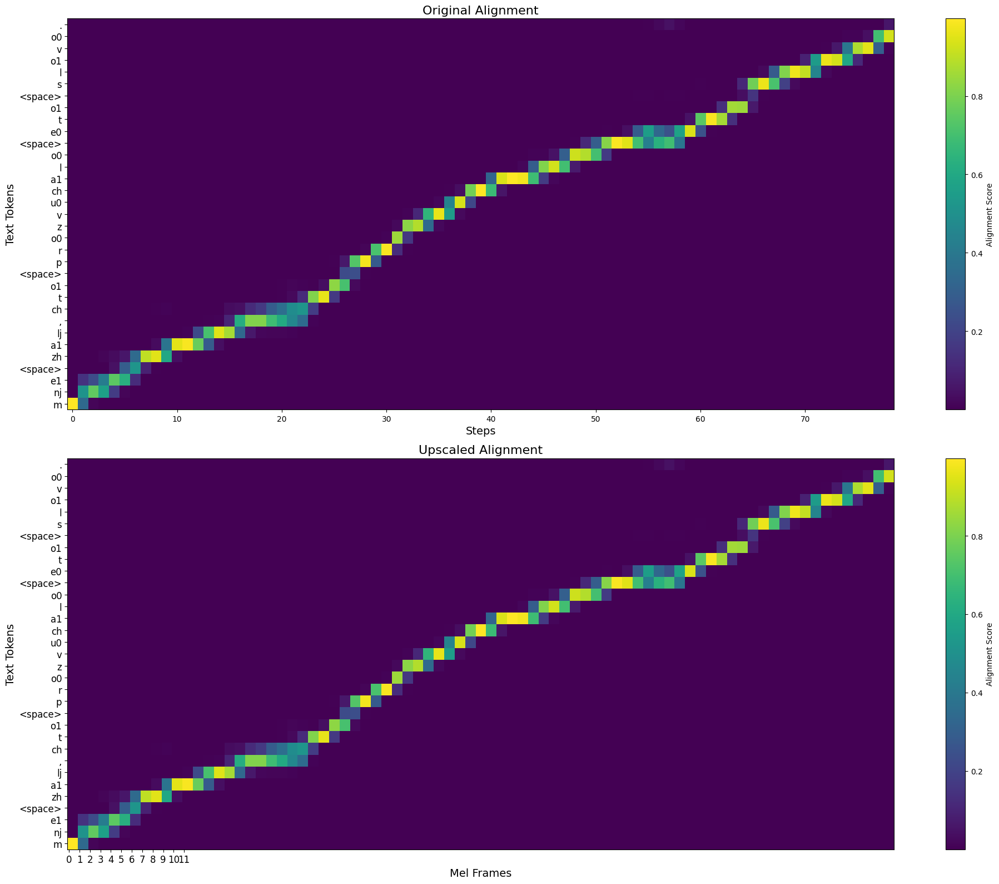

In [169]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import re

from model import Tacotron2_with_GST, mode, to_arr
from dataset import hparams as hps, text_to_sequence, get_ru_phonemes

# --- Ваши существующие функции ---

def get_safe_filename(text):
    """
    Создаёт безопасное имя файла, заменяя пробелы на подчеркивания и удаляя нежелательные символы.
    """
    # Заменяем пробелы на нижние подчеркивания
    text = text.replace(" ", "_")
    
    # Удаляем все символы, кроме букв и нижних подчеркиваний
    text = re.sub(r'[^A-Za-zА-Яа-яЁё_]', '', text)
    
    # Ограничиваем длину имени файла до 50 символов
    base_name = text[:50]
    
    return base_name

def process_lpc_output(lpc_output):
    """
    Обрабатывает выходные данные LPC, добавляя дополнительные строки с индексами 36 и 37.
    """
    # Избавляемся от нулевого измерения
    lpc_output = lpc_output.squeeze(0)  # Размер будет [20, time_steps]
    
    # Создаем новый тензор размера [55, time_steps], заполненный нулями
    new_lpc_output = torch.zeros(55, lpc_output.size(1))
    
    # Копируем первые 18 строк
    new_lpc_output[0:18, :] = lpc_output[0:18, :]
    
    # Копируем строки с индексами 36 и 37
    new_lpc_output[36:38, :] = lpc_output[18:20, :]
    
    return new_lpc_output

def read_metadata(metadata_path):
    """
    Читает файл metadata.csv и возвращает список кортежей (filename, text).
    """
    metadata = []
    with open(metadata_path, 'r', encoding='utf-8') as f:
        for line in f:
            line = line.strip()
            if not line:
                continue
            parts = line.split('|')
            if len(parts) != 2:
                continue
            filename = parts[0].strip()
            text = parts[1].strip()
            metadata.append((filename, text))
    return metadata

def load_model(ckpt_pth):
    """
    Загружает модель Tacotron2 с GST из контрольной точки.
    """
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    ckpt_dict = torch.load(ckpt_pth, map_location=device)
    model = Tacotron2_with_GST()
    model.load_state_dict(ckpt_dict['model'])
    model = mode(model, True).to(device).eval()
    return model

def infer_aligns(text, ref_mels, model, i, device=torch.device("cuda" if torch.cuda.is_available() else "cpu")):
    """
    Выполняет инференс модели и сохраняет выходные данные.
    
    Args:
        text (str): Текст для инференса.
        ref_mels (torch.Tensor): Референсные мел-фреймы.
        model (torch.nn.Module): Загруженная модель Tacotron2.
        i (int): Индекс инференса для именования файлов.
        device (torch.device): Устройство для выполнения инференса.
    
    Returns:
        tuple: (alignments, lpc_outputs)
    """
    # Преобразуем текст в последовательность фонем
    sequence = get_ru_phonemes(text).unsqueeze(0).to(device)
    
    # Выполняем инференс модели, получая выходные данные
    with torch.no_grad():
        lpc_outputs, _, _, alignments = model.inference(sequence, ref_mels)
    
    # Обрабатываем выходные данные LPC
    processed_lpc_output = process_lpc_output(lpc_outputs)
    
    # Формируем безопасное имя файла
    base_name = "_".join(text.split())[:50]
    base_name_r = get_safe_filename(base_name)
    
    # Формируем пути для сохранения
    output_file_path = f"/app/TTSproject/git/TTSproject/tacotron/output/{i}.f32"
    output_dir = '/app/TTSproject/git/TTSproject/tacotron/output'
    output_alig_path = f"/app/TTSproject/git/TTSproject/tacotron/output/{i}.npy"
    
    # Убедитесь, что директория для сохранения существует
    os.makedirs(output_dir, exist_ok=True)
    
    # Преобразуем результат инференса в numpy массив и сохраняем в файл .f32
    lpc_output_numpy = processed_lpc_output.detach().cpu().numpy().astype('float32')
    lpc_output_numpy.T.tofile(output_file_path)  # Транспонируем перед сохранением
    
    # Получаем матрицу выравниваний и сохраняем её
    alignments = alignments.squeeze(0).detach().cpu().numpy()  # Размер [time_steps, text_length]
    alignments.tofile(output_alig_path)  # Транспонируем перед сохранением
    
    return alignments, lpc_outputs

# --- Новые функции для апскейлинга и визуализации ---

def reshape_alignment(alignments_1d, tokens):
    """
    Преобразует одномерный массив выравниваний в двумерную матрицу.
    
    Args:
        alignments_1d (np.ndarray): Одномерный массив выравниваний размером (H * W,)
        tokens (list of str): Список токенов текста.
    
    Returns:
        np.ndarray: Двумерная матрица выравниваний размером (H, W)
    """
    W = len(tokens)
    L = len(alignments_1d)

    if L % W != 0:
        raise ValueError(f"Длина alignments_1d ({L}) не делится на количество токенов ({W}).")

    H = L // W
    alignment_2d = alignments_1d.reshape(H, W)
    return alignment_2d

def upscale_alignment_vertical(original_alignment, n_frames_per_step=3):
    """
    Апскейлит матрицу выравнивания с размера (H, W) до (H * n_frames_per_step, W)
    по вертикали, повторяя каждую строку n_frames_per_step раз.
    
    Args:
        original_alignment (np.ndarray): Оригинальная матрица выравнивания размером (H, W)
        n_frames_per_step (int): Количество мел-фреймов на шаг инференса (по умолчанию 3)
    
    Returns:
        np.ndarray: Апскейленная матрица выравнивания размером (H * n_frames_per_step, W)
    """
    upscaled_alignment = np.repeat(original_alignment, n_frames_per_step, axis=0)
    return upscaled_alignment

def plot_comparison(original_alignment, upscaled_alignment, tokens, n_frames_per_step=3, title_original="Original Alignment", title_upscaled="Upscaled Alignment"):
    """
    Визуализирует оригинальную и апскейленную матрицы выравнивания друг под другом.
    
    Args:
        original_alignment (np.ndarray): Оригинальная матрица выравнивания размером (H, W)
        upscaled_alignment (np.ndarray): Апскейленная матрица выравнивания размером (H * 3, W)
        tokens (list of str): Список токенов текста.
        n_frames_per_step (int): Количество мел-фреймов на шаг инференса (по умолчанию 3)
        title_original (str): Заголовок для оригинальной матрицы
        title_upscaled (str): Заголовок для апскейленой матрицы
    """
    fig, axes = plt.subplots(2, 1, figsize=(20, 16))
    
    # Оригинальная матрица
    im1 = axes[0].imshow(original_alignment.T, aspect='auto', origin='lower', cmap='viridis')
    axes[0].set_title(title_original, fontsize=16)
    axes[0].set_xlabel('Steps', fontsize=14)
    axes[0].set_ylabel('Text Tokens', fontsize=14)
    fig.colorbar(im1, ax=axes[0], label='Alignment Score')
    
    # Апскейленная матрица
    im2 = axes[1].imshow(upscaled_alignment.T, aspect='auto', origin='lower', cmap='viridis')
    axes[1].set_title(title_upscaled, fontsize=16)
    axes[1].set_xlabel('Mel Frames', fontsize=14)
    axes[1].set_ylabel('Text Tokens', fontsize=14)
    fig.colorbar(im2, ax=axes[1], label='Alignment Score')
    
    # Настройка меток осей X для апскейленной матрицы
    mel_frames = upscaled_alignment.shape[1]
    steps = original_alignment.shape[0]
    
    # Создаем список шагов для маркировки каждые n_frames_per_step мел-фреймов
    step_indices = np.arange(0, mel_frames + 1, n_frames_per_step)
    step_labels = step_indices // n_frames_per_step
    step_labels = step_labels[step_indices <= mel_frames]  # Удаляем лишние

    axes[1].set_xticks(step_indices)
    axes[1].set_xticklabels(step_labels, fontsize=12)
    
    # Настройка меток осей Y для обоих графиков
    for ax in axes:
        ax.set_yticks(np.arange(len(tokens)))
        ax.set_yticklabels(tokens, fontsize=12)
    
    plt.tight_layout()
    plt.show()

# --- Основной блок вашего кода ---

def get_lpc_from_f32_alternative(features_file_path, n_mels=55, device='cuda'):
    """
    Загружает LPC коэффициенты из файла .f32 и преобразует их в тензор формы [1, 1, 20, Ty].

    Args:
        features_file_path (str): Путь к файлу с LPC коэффициентами.
        n_mels (int): Количество LPC коэффициентов (по умолчанию 55).
        device (str): Устройство для переноса тензора ('cuda' или 'cpu').

    Returns:
        torch.Tensor: Тензор формы [1, 1, 20, Ty], где Ty - количество временных шагов.
    """
    # Чтение бинарных данных из файла
    lpc_features = np.fromfile(features_file_path, dtype='float32')
    
    # Изменяем размер массива
    num_lpc = n_mels  # Количество коэффициентов LPC на фрейм
    if len(lpc_features) % num_lpc != 0:
        raise ValueError(f"Размер файла {features_file_path} не кратен {num_lpc}.")
    
    lpc_features = lpc_features.reshape(-1, num_lpc)
    
    # Конвертируем массив в тензор PyTorch для использования в модели
    lpc_tensor = torch.Tensor(lpc_features)
    
    # Транспонируем и выбираем нужные фичи
    lpcfeatures_transposed = lpc_tensor.transpose(0, 1)
    lpc_tensor = torch.cat((lpcfeatures_transposed[0:18, :], lpcfeatures_transposed[36:38, :]), dim=0)
    
    # Добавляем размерности для батча и канала: [1, 1, 20, Ty]
    lpc_tensor = lpc_tensor.unsqueeze(0).unsqueeze(0).to(device)
    
    return lpc_tensor

if __name__ == "__main__":
    # Параметры
    CHECKPOINT_PATH = './ckpt/ckpt_200000'  # Укажите путь к вашему чекпойнту
    NUM_INFERENCES = 6  # Количество инференсов для сравнения
    N_FRAMES_PER_STEP = 3  # Количество мел-фреймов на шаг инференса
    
    i = 19  # Замените на нужный индекс
    
    metadata_path = '/app/TTSproject/GST-Tacotron/datasets/metadata.csv'
    
    # Чтение metadata
    metadata = read_metadata(metadata_path)
    if i < 0 or i >= len(metadata):
        print(f"Индекс {i} вне диапазона. В metadata.csv {len(metadata)} записей.")
        exit(1)  # Выход, если индекс неверен
    
    filename, TEXT_EXAMPLE = metadata[i]
    
    ref_mels_path = '/app/TTSproject/GST-Tacotron/datasets/lpc_features/' + filename + '.f32'
    ref_mels = get_lpc_from_f32_alternative(ref_mels_path)
    
    print(ref_mels.size())  # Должно вывести: torch.Size([1, 1, 20, Ty])
    
    # Разделение текста на токены
    tokens = TEXT_EXAMPLE.split()
    
    # Загрузка модели
    tacotron = load_model(CHECKPOINT_PATH)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Выполнение нескольких инференсов и сбор выравниваний
    alignments_list, lpc_outputs_list = [], []
    for inference_idx in range(NUM_INFERENCES):
        alignments, lpc_outputs = infer_aligns(TEXT_EXAMPLE, ref_mels, tacotron, inference_idx, device)
        alignments_list.append(alignments)
        lpc_outputs_list.append(lpc_outputs)
        print(f"Inference {inference_idx} LPC Outputs Shape: {lpc_outputs.shape}")
        print(f"Inference {inference_idx} Alignments Shape: {alignments.shape}")
        
        # Проверка согласованности
        if lpc_outputs.shape[1] != alignments.shape[0] * N_FRAMES_PER_STEP:
            print(f"Warning: Inference {inference_idx} LPC Outputs time steps ({lpc_outputs.shape[1]}) "
                  f"не совпадают с Alignments mel_length ({alignments.shape[0]}) * N_FRAMES_PER_STEP ({N_FRAMES_PER_STEP}) = {alignments.shape[0] * N_FRAMES_PER_STEP}.")
        else:
            print(f"Inference {inference_idx} LPC Outputs и Alignments имеют согласованное количество фреймов.")
    
    # Предположим, вы хотите визуализировать первое выравнивание
    tokens = TEXT_EXAMPLE.split()
    alignments_1d = alignments_list[0].flatten()  # Преобразуем в 1D массив
    
    # Преобразуем 1D выравнивания в 2D матрицу
    try:
        alignment_2d = reshape_alignment(alignments_1d, tokens)
    except ValueError as e:
        print(f"Ошибка при преобразовании выравниваний: {e}")
        exit(1)
    
    # Апскейлим матрицу выравнивания вертикально путем повторения каждой строки трижды
    upscaled_alignment = upscale_alignment_vertical(alignment_2d, n_frames_per_step=N_FRAMES_PER_STEP)
    
    # Визуализируем оригинальную и апскейленную матрицы выравнивания
    plot_comparison(alignment_2d, upscaled_alignment, tokens,
                   n_frames_per_step=N_FRAMES_PER_STEP,
                   title_original="Original Alignment",
                   title_upscaled="Upscaled Alignment")


In [170]:
alignments_list[1].size/len(tokens)


73.0

In [73]:
TEXT_EXAMPLE

'm nj e1 <space> zh a1 lj , ch t o1 <space> p r o0 z v u0 ch a1 l o0 <space> e0 t o1 <space> s l o1 v o0 .'

In [154]:
align_file = "/app/TTSproject/git/TTSproject/tacotron/output/1.npy"
test = np.fromfile(align_file, dtype='float32')
test.size/len(tokens)

74.0

In [111]:
# Чтение бинарных данных из файла
features_file_path = '/app/TTSproject/GST-Tacotron/datasets/lpc_features/000001_RUSLAN.f32'

lpc_features = np.fromfile(features_file_path, dtype='float32')

# Изменяем размер массива
nb_features = 55  # Количество коэффициентов LPC на фрейм

#lpc_features = lpc_features.reshape(-1, num_lpc)
lpc_features = np.resize(lpc_features, (int(len(lpc_features) / nb_features), nb_features))

# Конвертируем массив в тензор PyTorch для использования в модели
lpc_tensor = torch.Tensor(lpc_features)

# Транспонируем и выбираем нужные фичи
lpcfeatures_transposed = lpc_tensor.transpose(0, 1)

lpc_tensor = torch.cat((lpcfeatures_transposed[0:18, :], lpcfeatures_transposed[36:38, :]), dim=0)

# Добавляем размерности для батча и канала: [1, 1, 20, Ty]
lpc_tensor = lpc_tensor.unsqueeze(0).unsqueeze(0).to(device)
lpc_tensor

tensor([[[[-1.2389e+01,  9.6577e+00,  9.6436e+00,  ...,  3.4604e+00,
            4.3379e+00,  7.9071e+00],
          [-5.4509e-02, -1.2640e+00, -2.5546e+00,  ..., -1.9880e+00,
           -1.5221e+00, -1.0736e+00],
          [ 2.6231e-02, -2.0485e+00, -1.1166e+00,  ..., -2.9287e+00,
           -2.9832e+00, -2.0516e+00],
          ...,
          [ 3.9622e-03,  6.6926e-02,  2.5515e-01,  ...,  6.8203e-02,
            2.2360e-01,  1.8949e-01],
          [-4.8000e-01, -4.8000e-01, -4.6000e-01,  ...,  2.0400e+00,
            2.0400e+00,  2.0500e+00],
          [-2.8110e-01, -2.8110e-01, -2.8110e-01,  ..., -4.2934e-01,
           -4.2934e-01, -4.2934e-01]]]], device='cuda:0')

In [139]:
D_file = "/app/TTSproject/git/TTSproject/tacotron/output/111.npy"
train_txt = "/app/TTSproject/fastspeech/FastSpeech/data/train.txt"

plot_alignment_from_D(D_file, train_txt, title="Alignment Heatmap for Alignment")
plot_duration(D_file, train_txt, title="Duration Plot for Alignment")

FileNotFoundError: Файл не найден: /app/TTSproject/git/TTSproject/tacotron/output/111.npy

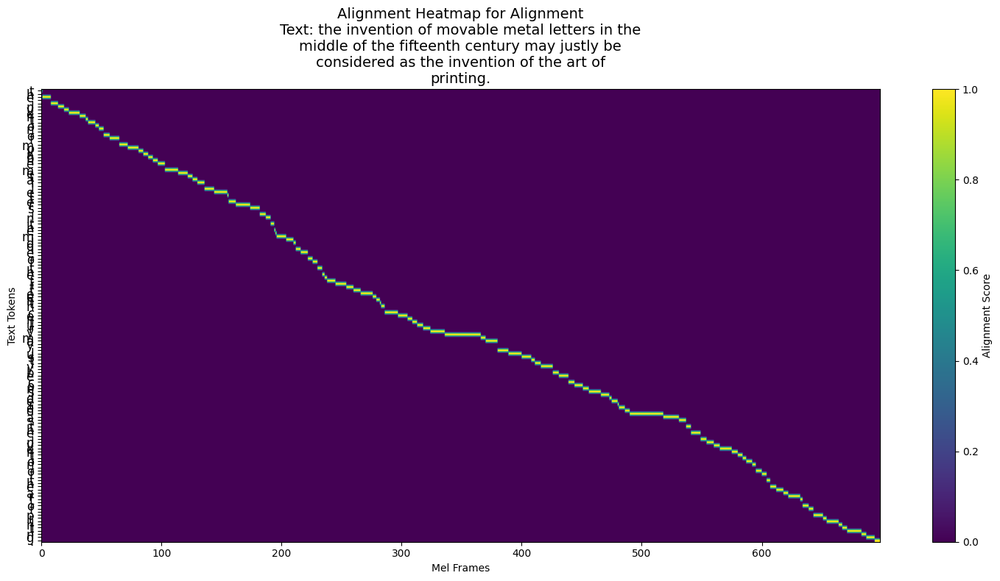

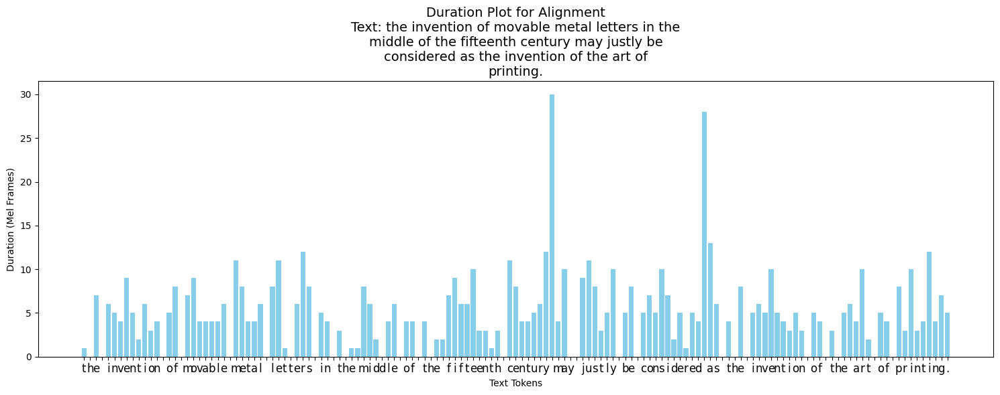

In [147]:
import os
import numpy as np
import matplotlib.pyplot as plt
import textwrap

def create_alignment_matrix(D):
    total_mel = int(D.sum())
    alignment_matrix = np.zeros((len(D), total_mel))
    
    current_mel = 0
    for i, duration in enumerate(D):
        for _ in range(duration):
            if current_mel < total_mel:
                alignment_matrix[i, current_mel] = 1
                current_mel += 1
            else:
                break
    
    return alignment_matrix

def plot_alignment_from_D(d_path, train_txt_path, title="Alignment Heatmap"):
    # Получаем номер файла из его имени
    filename = os.path.basename(d_path)
    file_index = int(filename.split('.')[0])  # Извлечение индекса (например, 2 из 2.npy)
    
    # Проверка существования файла длительностей
    if not os.path.isfile(d_path):
        raise FileNotFoundError(f"Файл не найден: {d_path}")
    
    # Проверка существования файла train.txt
    if not os.path.isfile(train_txt_path):
        raise FileNotFoundError(f"Файл train.txt не найден: {train_txt_path}")
    
    # Чтение строки с номером, соответствующим номеру файла
    with open(train_txt_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
        if file_index >= len(lines):
            raise IndexError(f"Индекс {file_index} превышает количество строк в train.txt ({len(lines)})")
        text = lines[file_index].strip()
    
    # Загрузка вектора длительностей
    D = np.load(d_path)
    
    # Проверка размерности
    if D.ndim != 1:
        raise ValueError(f"Ожидался 1-мерный вектор длительностей, получено {D.ndim}-мерный.")
    
    # Создание матрицы выравнивания
    alignment = create_alignment_matrix(D)
    
    # Проверка соответствия длины mel-спектрограммы сумме длительностей
    mel_length = alignment.shape[1]
    if mel_length != int(D.sum()):
        print(f"Warning: Sum of durations {int(D.sum())} does not match mel length {mel_length}")
    
    # Подготовка меток для оси Y (символы текста)
    tokens = list(text)  
    num_tokens = len(tokens)
    
    if num_tokens < alignment.shape[0]:
        tokens = tokens + [''] * (alignment.shape[0] - num_tokens)
    elif num_tokens > alignment.shape[0]:
        tokens = tokens[:alignment.shape[0]]
    
    # Не транспонируем матрицу выравнивания, чтобы текст был по Y-оси
    # alignment = alignment.T  # Удаляем транспонирование
    
    # Построение тепловой карты
    plt.figure(figsize=(15, 8))
    plt.imshow(alignment, aspect='auto', origin='upper', cmap='viridis')  # Изменили origin на 'upper'
    plt.colorbar(label='Alignment Score')
    plt.ylabel('Text Tokens')  # Изменили метку оси Y
    plt.xlabel('Mel Frames')    # Изменили метку оси X
    
    # Настройка меток оси Y (текстовые токены)
    plt.yticks(ticks=np.arange(len(tokens)), labels=tokens, fontsize=12)  # Убрали rotation
    
    # Добавление заголовка с текстом
    wrapped_text = "\n".join(textwrap.wrap(text, width=50))
    plt.title(f"{title}\nText: {wrapped_text}", fontsize=14)
    
    plt.tight_layout()
    plt.show()
    plt.close()

def plot_duration(d_path, train_txt_path, title="Duration Plot"):
    filename = os.path.basename(d_path)
    file_index = int(filename.split('.')[0])  # Извлечение индекса (например, 2 из 2.npy)
    
    if not os.path.isfile(d_path):
        raise FileNotFoundError(f"Файл не найден: {d_path}")
    
    if not os.path.isfile(train_txt_path):
        raise FileNotFoundError(f"Файл train.txt не найден: {train_txt_path}")
    
    with open(train_txt_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
        if file_index >= len(lines):
            raise IndexError(f"Индекс {file_index} превышает количество строк в train.txt ({len(lines)})")
        text = lines[file_index].strip()
    
    D = np.load(d_path)
    
    if D.ndim != 1:
        raise ValueError(f"Ожидался 1-мерный вектор длительностей, получено {D.ndim}-мерный.")
    
    tokens = list(text)  
    num_tokens = len(tokens)
    
    token_indices = np.arange(len(D))
    
    if num_tokens > len(D):
        tokens = tokens[:len(D)]
    elif num_tokens < len(D):
        tokens = tokens + [''] * (len(D) - num_tokens)
    
    plt.figure(figsize=(15, 6))
    plt.bar(token_indices, D, color='skyblue')
    plt.xlabel('Text Tokens')
    plt.ylabel('Duration (Mel Frames)')
    
    plt.xticks(ticks=token_indices, labels=tokens, fontsize=12, rotation=0)
    
    wrapped_text = "\n".join(textwrap.wrap(text, width=50))
    plt.title(f"{title}\nText: {wrapped_text}", fontsize=14)
    
    plt.tight_layout()
    plt.show()
    plt.close()

# Пример использования функций
if __name__ == "__main__":
    D_file = "/app/TTSproject/git/TTSproject/fastspeech/alignments_old/4.npy"
    train_txt = "/app/TTSproject/fastspeech/FastSpeech/data/train.txt"
    
    plot_alignment_from_D(D_file, train_txt, title="Alignment Heatmap for Alignment")
    plot_duration(D_file, train_txt, title="Duration Plot for Alignment")


In [69]:
import sys
import os
from tqdm import tqdm
import IPython.display as ipd
from scipy.io import wavfile
import torch
import math
import numpy as np

# Добавляем путь к директории, где находятся модули LPCNet и ulaw
sys.path.append('/app/TTS/LPCNet_pytorch3/')
from lpcnet import LPCNet
from ulaw import lin2ulaw, ulaw2lin  # Импортируем оригинальные функции


def get_lpc_from_f32_alternative(features_file_path, n_mels=55, device='cuda'):
    """
    Загружает LPC коэффициенты из файла .f32 и преобразует их в тензор формы [1, 1, 20, Ty].

    Args:
        features_file_path (str): Путь к файлу с LPC коэффициентами.
        n_mels (int): Количество LPC коэффициентов (по умолчанию 20).
        device (str): Устройство для переноса тензора ('cuda' или 'cpu').

    Returns:
        torch.Tensor: Тензор формы [1, 1, 20, Ty], где Ty - количество временных шагов.
    """
    # Чтение бинарных данных из файла
    lpc_features = np.fromfile(features_file_path, dtype='float32')
    
    
    # Изменяем размер массива
    num_lpc = 55  # Количество коэффициентов LPC на фрейм
    
    lpc_features = lpc_features.reshape(-1, num_lpc)
    
    # Конвертируем массив в тензор PyTorch для использования в модели
    lpc_tensor = torch.Tensor(lpc_features)
    
    # Транспонируем и выбираем нужные фичи
    lpcfeatures_transposed = lpc_tensor.transpose(0, 1)
    
    lpc_tensor = torch.cat((lpcfeatures_transposed[0:18, :], lpcfeatures_transposed[36:38, :]), dim=0)
    
    # Добавляем размерности для батча и канала: [1, 1, 20, Ty]
    lpc_tensor = lpc_tensor.unsqueeze(0).unsqueeze(0).to(device)
    
    return lpc_tensor

def read_metadata(metadata_path):
    """
    Читает файл metadata.csv и возвращает список кортежей (filename, text).
    """
    metadata = []
    with open(metadata_path, 'r', encoding='utf-8') as f:
        for line in f:
            line = line.strip()
            if not line:
                continue
            parts = line.split('|')
            if len(parts) != 2:
                continue
            filename = parts[0].strip()
            text = parts[1].strip()
            metadata.append((filename, text))
    return metadata

# Функция инференса
def infer_aligns(text, ref_mels, model, i, device=torch.device("cuda" if torch.cuda.is_available() else "cpu")):
    # Преобразуем текст в последовательность индексов
    #sequence = text_to_sequence(text, hps.text_cleaners)
    #sequence = torch.IntTensor(sequence)[None, :].long()
    #sequence = sequence.to(device)
    sequence = get_ru_phonemes(text).unsqueeze(0).to(device)
    # Выполняем инференс модели, получая выходные данные
    with torch.no_grad():
        lpc_outputs, _, _, alignments = model.inference(sequence, ref_mels)
    
     # Преобразуем результаты инференса в нужный формат
    processed_lpc_output = process_lpc_output(lpc_outputs)
    
    # Получаем имя файла из текста (можно улучшить, чтобы избежать недопустимых символов)
    base_name = "_".join(text.split())[:50]  # Ограничиваем длину имени файла
    
    base_name_r = get_safe_filename(base_name)
    # Формируем путь для сохранения
    output_file_path = f"/app/TTSproject/git/TTSproject/tacotron/output/{i}.f32"   #os.path.join(output_dir, f"{base_name_r}.f32")
    output_dir = '/app/TTSproject/git/TTSproject/tacotron/output'
    
    # Убедитесь, что директория для сохранения существует
    os.makedirs(output_dir, exist_ok=True)
    
    # Преобразуем результат инференса в numpy массив и сохраняем в файл .f32
    lpc_output_numpy = processed_lpc_output.detach().cpu().numpy().astype('float32')
    lpc_output_numpy.T.tofile(output_file_path) #transpose before save
    
    # Получаем матрицу выравниваний
    alignments = alignments.squeeze(0).detach().cpu().numpy()  # Размер [time_steps, text_length]
    
    return alignments, lpc_outputs


def generate_features(text_example, num_inferences=6):
    """
    Генерирует NUM_INFERENCES вариантов фичей Tacotron на основе текста.
    Замените эту функцию на реальную генерацию фичей Tacotron.
    """
    lpc_outputs_list = []
    for _ in range(num_inferences):
        alignments, lpc_outputs = infer_aligns(TEXT_EXAMPLE, ref_mels, tacotron, i, device)
        cnt = count_frames(lpc_outputs)
        alignments_list.append(alignments)
        lpc_outputs_list.append(lpc_outputs)
    return lpc_outputs_list

def count_frames(tensor):
    """
    Возвращает количество фреймов в тензоре.
    Предполагается, что фреймы находятся в последней размерности.
    """
    return tensor.size(-1)

def process_index(i, metadata_path='/app/TTSproject/GST-Tacotron/datasets/metadata.csv',
                  lpc_features_dir='/app/TTSproject/GST-Tacotron/datasets/lpc_features/',
                  num_inferences=6):
    """
    Обрабатывает i-ю строку из metadata.csv:
    - Извлекает текст и имя файла
    - Загружает референсные фичи
    - Генерирует NUM_INFERENCES фичей
    - Сравнивает количество фреймов
    """
    # Чтение metadata
    metadata = read_metadata(metadata_path)
    if i < 0 or i >= len(metadata):
        print(f"Индекс {i} вне диапазона. В metadata.csv {len(metadata)} записей.")
        return
    
    filename, text = metadata[i]
    
    # Формирование пути к референсным фичам
    ref_mels_path = os.path.join(lpc_features_dir, f"{filename}.f32")
    
    # Загрузка референсных фичей
    ref_mels = get_lpc_from_f32_alternative(ref_mels_path)
    
    # Подсчёт количества фреймов в референсных фичах
    expected_frames = count_frames(ref_mels)
    
    print(f"Обработка индекса {i}:")
    print(f"Имя файла: {filename}")
    print(f"Текст: {text}")
    print(f"Путь к референсным фичам: {ref_mels_path}")
    print(f"Ожидаемое количество фреймов: {expected_frames}")
    
    # Генерация фичей Tacotron
    generated_features = generate_features(text, num_inferences=num_inferences)
    
    # Подсчёт фреймов в сгенерированных фичах
    frame_counts = [count_frames(gf) for gf in generated_features]
    
    # Сравнение количества фреймов
    acceptable_variation = 5
    matching_indices = []
    for idx, fc in enumerate(frame_counts):
        if abs(fc - expected_frames) <= acceptable_variation:
            matching_indices.append(idx)
    
    # Вывод результатов
    print(f"Сгенерировано {num_inferences} фичей:")
    for idx, fc in enumerate(frame_counts):
        print(f"  Инференс {idx + 1}: {fc} фреймов")
    
    print(f"Количество фичей с количеством фреймов в пределах ±{acceptable_variation}: {len(matching_indices)}")
    if matching_indices:
        print(f"Индексы совпадающих инференсов: {matching_indices}")
    else:
        print("Нет инференсов, соответствующих количеству фреймов в допустимых пределах.")

# Пример использования для одного индекса, например, i=3
if __name__ == "__main__":
    index_to_test = 16  # Замените на нужный индекс
    process_index(index_to_test)


Обработка индекса 16:
Имя файла: 000016_RUSLAN
Текст: j a1 <space> h o0 ch u1 <space> v <space> e1 t o0 m <space> r a0 z o0 b r a1 tj sj a0 .
Путь к референсным фичам: /app/TTSproject/GST-Tacotron/datasets/lpc_features/000016_RUSLAN.f32
Ожидаемое количество фреймов: 188
Terminated by gate.
Terminated by gate.
Terminated by gate.
Terminated by gate.
Terminated by gate.
Terminated by gate.
Сгенерировано 6 фичей:
  Инференс 1: 414 фреймов
  Инференс 2: 342 фреймов
  Инференс 3: 357 фреймов
  Инференс 4: 354 фреймов
  Инференс 5: 348 фреймов
  Инференс 6: 351 фреймов
Количество фичей с количеством фреймов в пределах ±5: 0
Нет инференсов, соответствующих количеству фреймов в допустимых пределах.


In [29]:
processed_text = 'k o0 g o1 <space> i0 n tj e0 rj e0 s u1 j u0 t <space> p rj i0 z n a1 nj i0 j a0 <space> lj i0 tj e0 r a0 t u1 r n o0 g o0 <space> nj e0 u0 d a1 ch nj i0 k a0 ?'


In [42]:
# Загрузка референсных фичей
ref_mels_path='/app/TTSproject/GST-Tacotron/datasets/lpc_features/000001_RUSLAN.f32'
ref_mels = get_lpc_from_f32_alternative(ref_mels_path)

# Подсчёт количества фреймов в референсных фичах
expected_frames = count_frames(ref_mels)

In [43]:
expected_frames

320

In [44]:
ref_mels.size()

torch.Size([1, 1, 20, 320])

## Код ниже - чтобы прослушать сгенерированные алайнментами файлы

In [26]:
import sys
import os
import torch

# Шаг 1: Добавляем путь к директории проекта, если необходимо
# Предположим, что ваш ноутбук находится в 'GST-Tacotron', а 'g2p' находится на один уровень выше
project_root = os.path.abspath(os.path.join('.', '..'))
if project_root not in sys.path:
    sys.path.append(project_root)

# Шаг 2: Импортируем G2PModel из модуля g2p
from g2p import G2PModel

# Шаг 3: Инициализируем модель G2P
g2p_model_dir = os.path.join(project_root, 'g2p')
g2p = G2PModel(model_dir=g2p_model_dir)

# Шаг 4: Загружаем чекпойнт
checkpoint_path = os.path.join(g2p_model_dir, 'checkpoint.pth')  # Убедитесь, что имя файла верное
g2p.load_checkpoint(checkpoint_path)

# Шаг 5: Используем функцию process_text
#sample_text = "Ведь представл+ения, которые он+о рождает, безграничны д+о нул+я."
#processed_text = g2p.process_text(sample_text)
#print(processed_text)

Модель загружена из /app/TTSproject/git/TTSproject/g2p/checkpoint.pth, Эпоха: 20, Ошибка: 0.0166


(20, 0.01655644970238751)

In [27]:
test_text = 'И чё, правда начинать играться с объединением?'
processed_text = g2p.process_text(test_text)
processed_text

'i1 <space> ch o1 , p r a1 v d a0 <space> n a0 ch i0 n a1 tj <space> i0 g r a1 tj sj a0 <space> s <space> o0 b j e0 dj i0 nj e1 nj i0 j e0 m ?'

In [36]:
import sys
import os
from tqdm import tqdm
import IPython.display as ipd
from scipy.io import wavfile
import torch
import math
import numpy as np

# Добавляем путь к директории
sys.path.append('/app/TTS/LPCNet_pytorch3/')
# Импортируем необходимые модули
from lpcnet import LPCNet
from ulaw import lin2ulaw, ulaw2lin  # Используем оригинальные функции

nb_frames = 1
nb_features = 55
frame_size = 160
nb_used_features = 38

feature_file = '/app/TTSproject/git/TTSproject/fastspeech/tacotron/output/1.f32'
output_wav_file = f"./output/тест.wav"

features = np.fromfile(feature_file, dtype='float32')
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size * feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:, :, 18:36] = 0

periods = torch.Tensor((.1 + 50 * features[:, :, 36:37] + 100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)

order = 16
coef = 0.85
skip = order + 1
res = []

argsload = '/app/TTSproject/git/TTSproject/lpcnet/ckpts/463.pkl'

# Загрузка модели на CPU без DataParallel
model = LPCNet(mode='test')

# Загрузка сохраненного состояния и удаление префикса 'module.'
checkpoint = torch.load(argsload, map_location=torch.device('cpu'))
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in checkpoint.items():
    name = k[7:] if k.startswith('module.') else k  # удаляем 'module.'
    new_state_dict[name] = v

# Загрузка исправленного state_dict в модель
model.load_state_dict(new_state_dict)
model.eval()

# Инициализация состояний на CPU
state1 = torch.zeros((1, 1, model.rnn_units1))
state2 = torch.zeros((1, 1, model.rnn_units2))

# Конвертация features в тензор на CPU
features = torch.from_numpy(features).float()

# Инициализация других переменных на CPU
pcm = torch.zeros(nb_frames * pcm_chunk_size)
fexc = torch.zeros((1, 1, 3), dtype=torch.long) + 128  # Изменено dtype на torch.long
mem = torch.tensor(0.0)

with torch.no_grad():
    for c in range(0, nb_frames):
        feat = features[c:c+1, :, :nb_used_features]
        pitch = periods[c:c+1, :, :]
        cfeat = model.encode(feat, pitch)
        for fr in tqdm(range(0, feature_chunk_size)):
            f = c * feature_chunk_size + fr
            a = features[c, fr, nb_features - order:]
            for i in range(skip, frame_size):
                t = f * frame_size + i
                if t >= order:
                    pred = -torch.sum(a * pcm[t - order:t].flip(dims=[0]))
                else:
                    pred = torch.tensor(0.0)
                fexc[0, 0, 1] = lin2ulaw(pred.item())
                p, state1, state2 = model.decode(fexc, cfeat[:, fr:fr+1, :], state1, state2, frame_size=1)
                p = p.softmax(dim=-1)
                fexc[0, 0, 2] = torch.multinomial(p[0, 0], 1)
                pcm_sample = pred + ulaw2lin(fexc[0, 0, 2].item())
                pcm[t] = pcm_sample
                fexc[0, 0, 0] = lin2ulaw(pcm_sample.item())  # Добавлено .item()
                mem = coef * mem + pcm_sample
                res.append(round(mem.item()))
            skip = 0


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 336/336 [00:39<00:00,  8.55it/s]


In [37]:
from scipy.io import wavfile
wavfile.write(output_wav_file, rate=16000, data=np.array(res, dtype='int16'))


In [38]:
ipd.Audio(output_wav_file)

In [26]:
ipd.Audio(output_wav_file)

In [30]:
ipd.Audio(output_wav_file)

In [53]:
import sys
import os
from tqdm import tqdm
import IPython.display as ipd
from scipy.io import wavfile
# Добавляем путь к директории
sys.path.append('/app/TTS/LPCNet_pytorch3/')
# Теперь можно импортировать модуль
from lpcnet import LPCNet
from ulaw import *
nb_frames = 1
nb_features = 55
frame_size = 160
nb_used_features = 38

In [54]:
import sys
import os
import torch

# Шаг 1: Добавляем путь к директории проекта, если необходимо
# Предположим, что ваш ноутбук находится в 'GST-Tacotron', а 'g2p' находится на один уровень выше
project_root = os.path.abspath(os.path.join('.', '..'))
if project_root not in sys.path:
    sys.path.append(project_root)

# Шаг 2: Импортируем G2PModel из модуля g2p
from g2p import G2PModel

# Шаг 3: Инициализируем модель G2P
g2p_model_dir = os.path.join(project_root, 'g2p')
g2p = G2PModel(model_dir=g2p_model_dir)

# Шаг 4: Загружаем чекпойнт
checkpoint_path = os.path.join(g2p_model_dir, 'checkpoint.pth')  # Убедитесь, что имя файла верное
g2p.load_checkpoint(checkpoint_path)

# Шаг 5: Используем функцию process_text
#sample_text = "Ведь представл+ения, которые он+о рождает, безграничны д+о нул+я."
#processed_text = g2p.process_text(sample_text)
#print(processed_text)

Модель загружена из /app/TTSproject/git/TTSproject/fastspeech/g2p/checkpoint.pth, Эпоха: 20, Ошибка: 0.0166


(20, 0.01655644970238751)

In [55]:
feature_file = '/app/TTSproject/git/TTSproject/fastspeech/tacotron/output/4.f32'
output_wav_file = f"./output/тест.wav"

In [56]:
features = np.fromfile(feature_file, dtype='float32')
#features = np.resize(features, (-1, nb_features))
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size*feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)


In [57]:
features.shape

(1, 267, 55)

In [58]:
order = 16
pcm    = np.zeros(nb_frames*pcm_chunk_size)
fexc   = np.zeros((1, 1, 3), dtype='int16')+128
mem = 0
coef = 0.85
#fout = open(out_file, 'wb')
skip = order + 1
res = []
respred, resexc = [], []
argsload = '/app/TTSproject/git/TTSproject/fastspeech/lpcnet/ckpts/463.pkl'
model = torch.nn.DataParallel(LPCNet(mode='test'))
model.load_state_dict(torch.load(argsload, map_location=torch.device('cpu')))
model = model.cpu()


state1 = torch.zeros((1, 1, model.module.rnn_units1))
state2 = torch.zeros((1, 1, model.module.rnn_units2))


In [59]:
with torch.no_grad():
    for c in range(0, nb_frames):
        feat  = torch.FloatTensor(features[c:c+1, :, :nb_used_features])
        pitch = periods[c:c+1, :, :]
        cfeat = model.module.encode(feat, pitch)
        for fr in tqdm(range(0, feature_chunk_size)):
            f = c * feature_chunk_size + fr
            a = features[c, fr, nb_features-order:]

            for i in range(skip, frame_size):
                t = f * frame_size + i
                pred = -sum(a * pcm[t-1:t-1-order:-1])
                respred.append(pred)
                fexc[0, 0, 1] = lin2ulaw(pred)

                p, state1, state2 = model.module.decode(
                    torch.LongTensor(fexc), torch.Tensor(cfeat[:, fr:fr+1, :]), state1, state2, frame_size=1
                )
                
                # Вынести softmax из цикла
                p = p.softmax(dim=-1).numpy()
                p *= np.power(p, np.maximum(0, 1.5 * features[c, fr, 37] - .5))
                p = np.maximum(p - 0.002, 0).astype('float64')  # Оптимизация для избежания мелких чисел
                p = p / np.sum(p)

                fexc[0, 0, 2] = np.argmax(np.random.multinomial(1, p[0, 0, :], 1))
                pcm[t] = pred + ulaw2lin(fexc[0, 0, 2])
                fexc[0, 0, 0] = lin2ulaw(pcm[t])
                mem = coef * mem + pcm[t]
                res.append(round(mem))

            skip = 0


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 267/267 [00:27<00:00,  9.59it/s]


In [60]:
from scipy.io import wavfile
wavfile.write(output_wav_file, rate=16000, data=np.array(res, dtype='int16'))


In [19]:
ipd.Audio(output_wav_file)

In [29]:
ipd.Audio(output_wav_file)

In [34]:
ipd.Audio(output_wav_file)

In [19]:
import sys
import os
from tqdm import tqdm
import IPython.display as ipd
from scipy.io import wavfile
import torch
import math
import numpy as np

# Добавляем путь к директории
sys.path.append('/app/TTS/LPCNet_pytorch3/')
# Импортируем необходимые модули
from lpcnet import LPCNet
from ulaw import lin2ulaw, ulaw2lin  # Используем оригинальные функции

nb_frames = 1
nb_features = 55
frame_size = 160
nb_used_features = 38

feature_file = '/app/TTSproject/git/TTSproject/fastspeech/tacotron/output/4.f32'
output_wav_file = f"./output/тест.wav"

features = np.fromfile(feature_file, dtype='float32')
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size * feature_chunk_size

features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:, :, 18:36] = 0

periods = torch.Tensor((.1 + 50 * features[:, :, 36:37] + 100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)

order = 16
coef = 0.85
skip = order + 1
res = []

argsload = '/app/TTSproject/git/TTSproject/fastspeech/lpcnet/ckpts/463.pkl'

# Загрузка модели на CPU без DataParallel
model = LPCNet(mode='test')

# Загрузка сохраненного состояния и удаление префикса 'module.'
checkpoint = torch.load(argsload, map_location=torch.device('cpu'))
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in checkpoint.items():
    name = k[7:] if k.startswith('module.') else k  # удаляем 'module.'
    new_state_dict[name] = v

# Загрузка исправленного state_dict в модель
model.load_state_dict(new_state_dict)
model.eval()

# Инициализация состояний на CPU
state1 = torch.zeros((1, 1, model.rnn_units1))
state2 = torch.zeros((1, 1, model.rnn_units2))

# Конвертация features в тензор на CPU
features = torch.from_numpy(features).float()

# Инициализация других переменных на CPU
pcm = torch.zeros(nb_frames * pcm_chunk_size)
fexc = torch.zeros((1, 1, 3), dtype=torch.long) + 128  # Изменено dtype на torch.long
mem = torch.tensor(0.0)

with torch.no_grad():
    for c in range(0, nb_frames):
        feat = features[c:c+1, :, :nb_used_features]
        pitch = periods[c:c+1, :, :]
        cfeat = model.encode(feat, pitch)
        for fr in tqdm(range(0, feature_chunk_size)):
            f = c * feature_chunk_size + fr
            a = features[c, fr, nb_features - order:]
            for i in range(skip, frame_size):
                t = f * frame_size + i
                if t >= order:
                    pred = -torch.sum(a * pcm[t - order:t].flip(dims=[0]))
                else:
                    pred = torch.tensor(0.0)
                fexc[0, 0, 1] = lin2ulaw(pred.item())
                p, state1, state2 = model.decode(fexc, cfeat[:, fr:fr+1, :], state1, state2, frame_size=1)
                p = p.softmax(dim=-1)
                fexc[0, 0, 2] = torch.multinomial(p[0, 0], 1)
                pcm_sample = pred + ulaw2lin(fexc[0, 0, 2].item())
                pcm[t] = pcm_sample
                fexc[0, 0, 0] = lin2ulaw(pcm_sample.item())  # Добавлено .item()
                mem = coef * mem + pcm_sample
                res.append(round(mem.item()))
            skip = 0


  7%|█████████                                                                                                                        | 21/297 [00:02<00:32,  8.50it/s]


KeyboardInterrupt: 

In [10]:
import sys
import os
from tqdm import tqdm
import IPython.display as ipd
from scipy.io import wavfile
import torch
import math
import numpy as np

# Добавляем путь к директории
sys.path.append('/app/TTS/LPCNet_pytorch3/')
# Импортируем необходимые модули
from lpcnet import LPCNet
from ulaw import lin2ulaw, ulaw2lin  # Используем оригинальные функции

nb_frames = 1
nb_features = 55
frame_size = 160
nb_used_features = 38
order = 16
coef = 0.85
skip = order + 1

feature_file = '/app/TTSproject/git/TTSproject/fastspeech/tacotron/output/4.f32'
output_wav_file = f"./output/тест.wav"

# Загрузка и подготовка фичей
features = np.fromfile(feature_file, dtype='float32')
features = np.resize(features, (int(len(features) / nb_features), nb_features))
feature_chunk_size = features.shape[0]
pcm_chunk_size = frame_size * feature_chunk_size
features = np.reshape(features, (nb_frames, feature_chunk_size, nb_features))
features[:,:,18:36] = 0

periods = torch.Tensor((.1 + 50*features[:,:,36:37]+100)).type(torch.LongTensor)
periods = torch.clamp(periods, min=0, max=255)





# Инициализация модели
argsload = '/app/TTSproject/git/TTSproject/fastspeech/lpcnet/ckpts/463.pkl'
model = LPCNet(mode='test')
checkpoint = torch.load(argsload, map_location=torch.device('cpu'))
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in checkpoint.items():
    name = k[7:] if k.startswith('module.') else k
    new_state_dict[name] = v
model.load_state_dict(new_state_dict)
model.eval()

state1 = torch.zeros((1, 1, model.rnn_units1))
state2 = torch.zeros((1, 1, model.rnn_units2))

with torch.no_grad():
    for c in range(0, nb_frames):# Подготовка данных для пакетной обработки
        num_frames = features.shape[0]
        batch_size = num_frames  # Можно изменить размер батча для оптимизации
        pcm = torch.zeros(num_frames * frame_size)
        mem = torch.zeros(num_frames)
        res = []

        feat  = torch.FloatTensor(features[c:c+1, :, :nb_used_features])
        pitch = periods[c:c+1, :, :]

        # Кодирование фичей
        cfeat = model.encode(feat, pitch)
        cfeat = cfeat.squeeze(0)

        # Инициализация входных данных для декодера
        fexc = torch.zeros((num_frames, 3), dtype=torch.long) + 128

        for i in tqdm(range(skip, num_frames * frame_size)):
            t = i

            # Линейное предсказание
            if t >= order:
                a = features[t // frame_size, nb_features - order:]
                pcm_segment = pcm[t - order:t].flip(dims=[0])
                pred = -torch.sum(a * pcm_segment)
            else:
                pred = torch.tensor(0.0)

            # Кодирование предсказанного значения
            fexc[:, 1] = lin2ulaw(pred.item())

            # Декодирование
            p, state1, state2 = model.decode(fexc.unsqueeze(1), cfeat[t // frame_size:t // frame_size + 1], state1, state2, frame_size=1)
            p = p.softmax(dim=-1)

            # Выборка сэмпла
            fexc[:, 2] = torch.multinomial(p.squeeze(1), 1).squeeze(1)

            # Обновление PCM
            pcm_sample = pred + ulaw2lin(fexc[:, 2].item())
            pcm[t] = pcm_sample

            # Обновление входа для следующей итерации
            fexc[:, 0] = lin2ulaw(pcm_sample.item())

            # Обновление памяти
            mem = coef * mem + pcm_sample
            res.append(round(mem.item()))


  0%|                                                                                                                                          | 0/143 [00:00<?, ?it/s]


TypeError: unsupported operand type(s) for *: 'numpy.ndarray' and 'Tensor'